<a href="https://colab.research.google.com/github/a26515969/AOI-detection/blob/main/detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, Model
from tensorflow.keras.activations import relu
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from tensorflow.keras.losses import BinaryCrossentropy
from tensorflow.keras.optimizers import RMSprop, Adam
from tensorflow.keras.metrics import binary_accuracy

import tensorflow_datasets as tfds

import numpy as np
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings('ignore')
print("Tensorflow", tf.__version__)


Tensorflow 2.8.2


In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
import cv2
import numpy as np
import os 
path_train="/content/drive/MyDrive/f01ok/"
path_test="/content/drive/MyDrive/f01ng/"
dirs=os.listdir(path_train)
dirs1=os.listdir(path_test)

train_x=[]
for i in dirs:    
    img = cv2.imread(path_train+i)
    train_x.append(img)

    
train_y=[]
for i in range(len(train_x)):
    train_y.append(0)

    
test_x=[]
for i in dirs1:    
    img = cv2.imread(path_test+i)
    test_x.append(img)
test_y=[]
for i in range(len(dirs1)):
    if "(NG)" in dirs1[i]:
        test_y.append(1)                    
    else: 
        test_y.append(0)

In [ ]:
batch_size = 64
width = 64
height = 64
channel=3
image_shape = (width, height, 3)

def preprocess(features):
    for i in range(len(features)):
        features[i]=cv2.resize(features[i], image_shape[:2])
    image =features    
    image = tf.cast(image, tf.float32)
    image = (image-127.5)/127.5
    return image


In [ ]:
train_x=preprocess(train_x)

dataset = tf.data.Dataset.from_tensor_slices(train_x)
dataset =dataset.shuffle(len(train_x))
dataset=dataset.batch(batch_size, drop_remainder=True).repeat()

Step 0: g_loss 2.7408 critic_loss -0.8817 critic fake 0.0454  critic_real -0.9833 penalty 0.0561


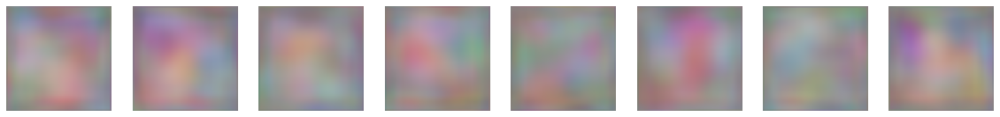

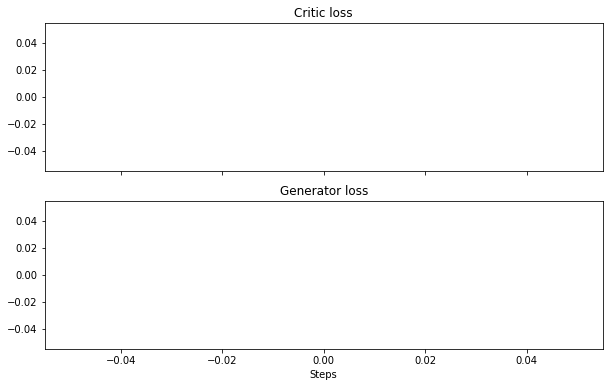

Step 100: g_loss 4.2486 critic_loss -1.7815 critic fake -1.4700  critic_real -0.4211 penalty 0.1095


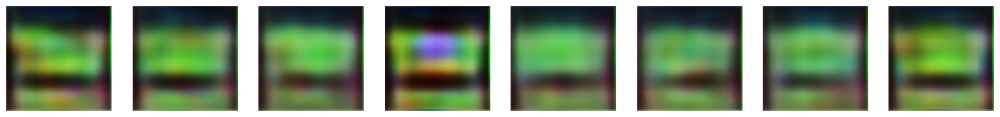

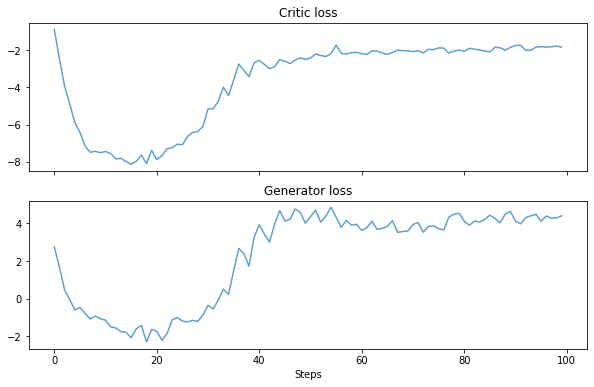

Step 200: g_loss 2.8375 critic_loss -1.4745 critic fake -0.2074  critic_real -1.2893 penalty 0.0222


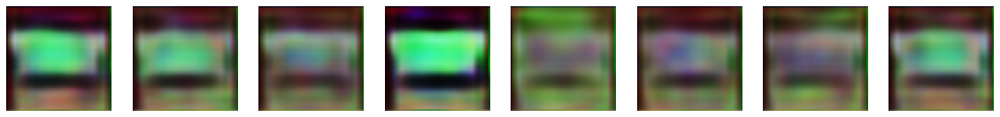

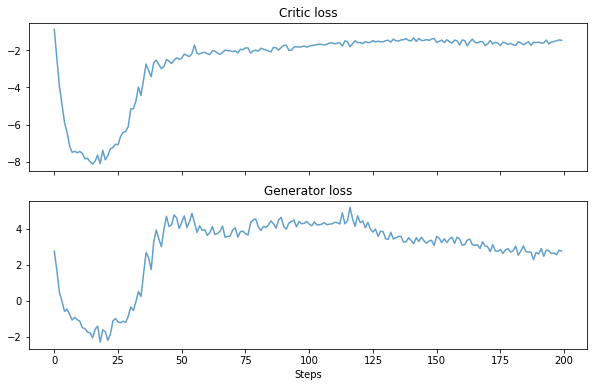

Step 300: g_loss 3.4295 critic_loss -1.3325 critic fake -0.4874  critic_real -0.9794 penalty 0.1343


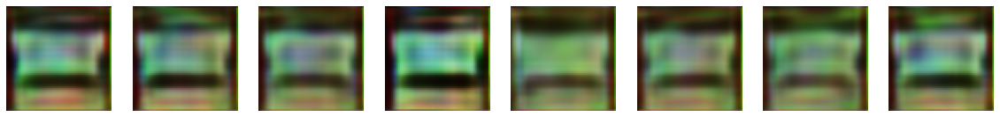

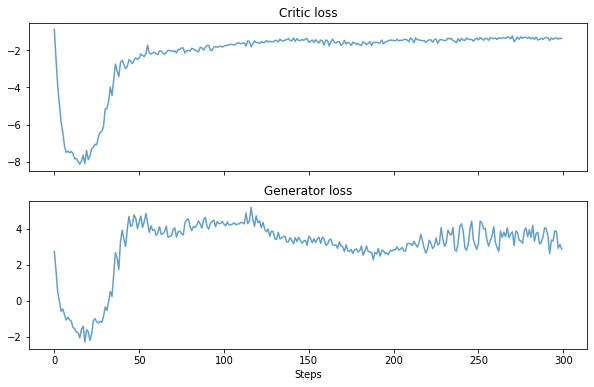

Step 400: g_loss 4.0283 critic_loss -1.3612 critic fake -1.2722  critic_real -0.1057 penalty 0.0168


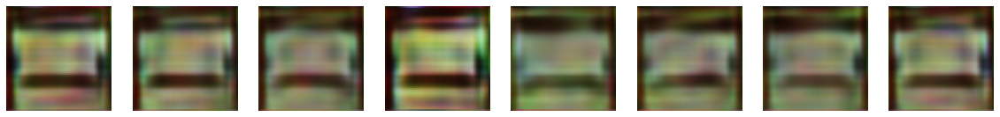

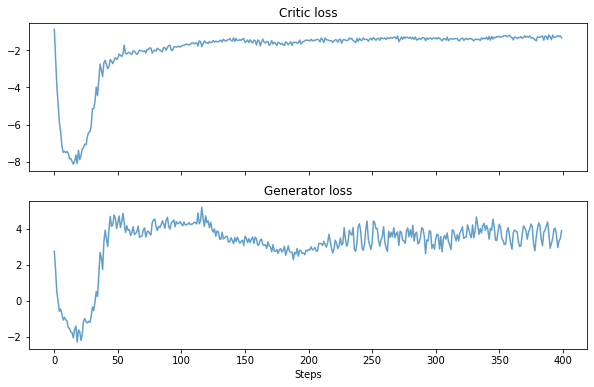

Step 500: g_loss 3.2269 critic_loss -1.2159 critic fake -0.1654  critic_real -1.1439 penalty 0.0934


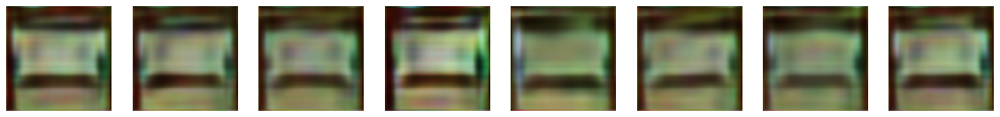

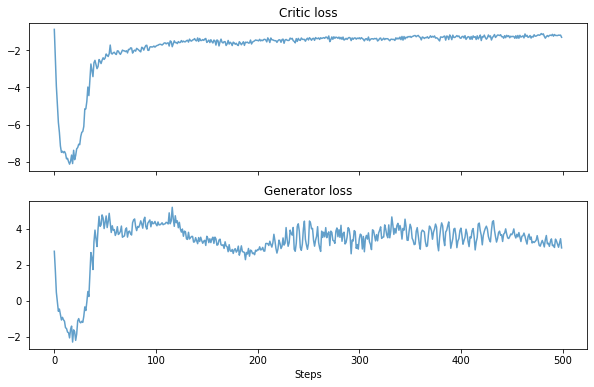

Step 600: g_loss 3.1603 critic_loss -1.1194 critic fake -0.0568  critic_real -1.0654 penalty 0.0028


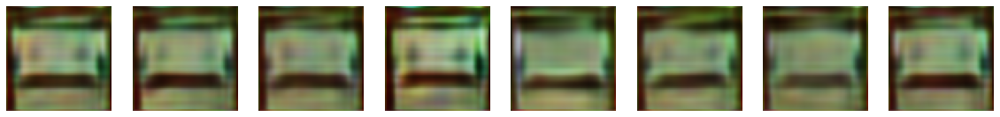

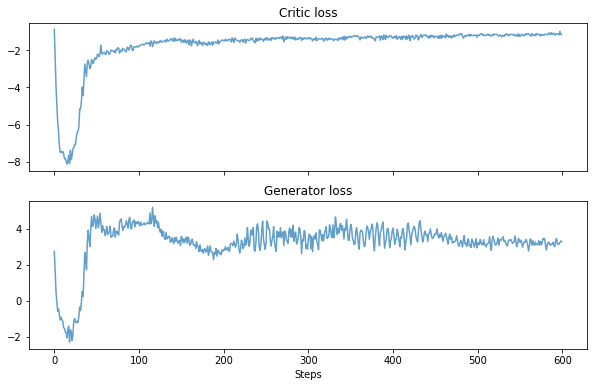

Step 700: g_loss 3.0255 critic_loss -1.1045 critic fake 0.0625  critic_real -1.1673 penalty 0.0003


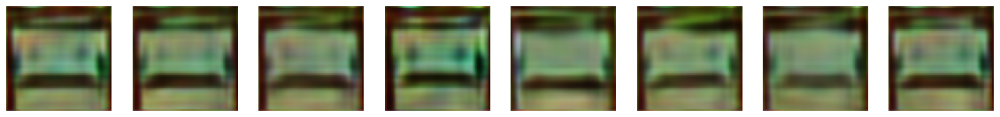

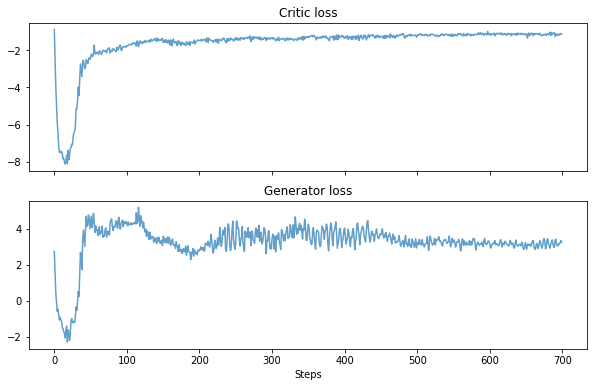

Step 800: g_loss 4.1070 critic_loss -1.1294 critic fake -0.8720  critic_real -0.2614 penalty 0.0040


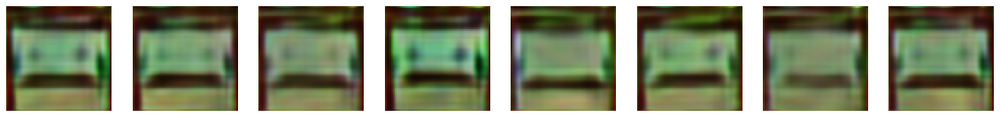

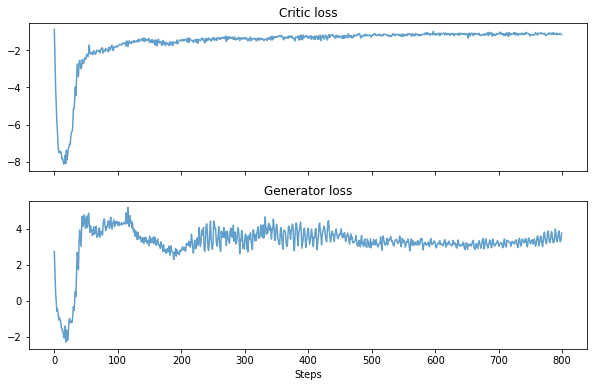

Step 900: g_loss 4.2433 critic_loss -1.1190 critic fake -1.1138  critic_real -0.0052 penalty 0.0000


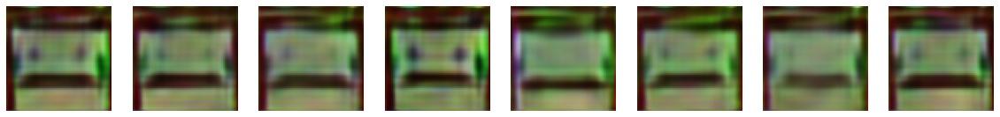

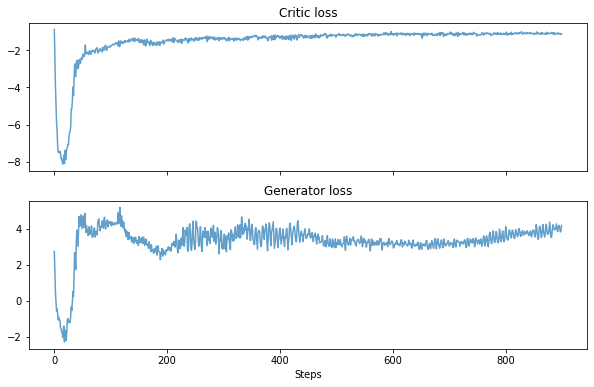

Step 1000: g_loss 4.1973 critic_loss -1.0517 critic fake -1.0030  critic_real -0.0564 penalty 0.0077


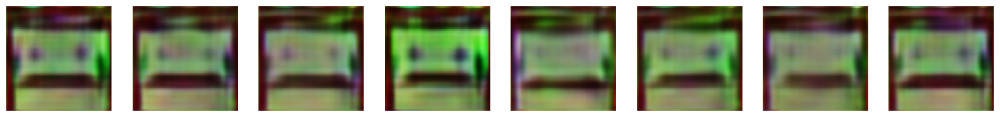

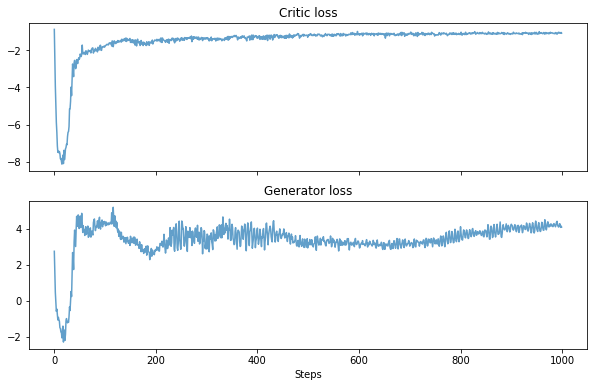

Step 1100: g_loss 4.4815 critic_loss -1.0744 critic fake -1.3888  critic_real 0.2604 penalty 0.0540


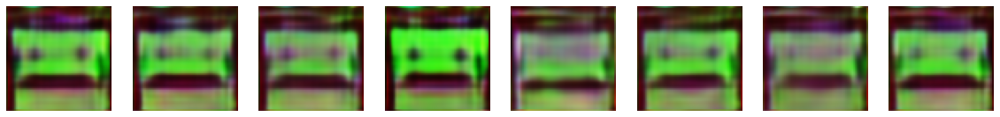

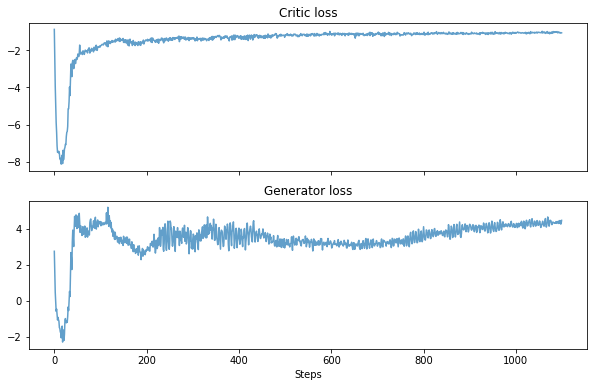

Step 1200: g_loss 4.6493 critic_loss -1.0029 critic fake -1.4914  critic_real 0.4464 penalty 0.0422


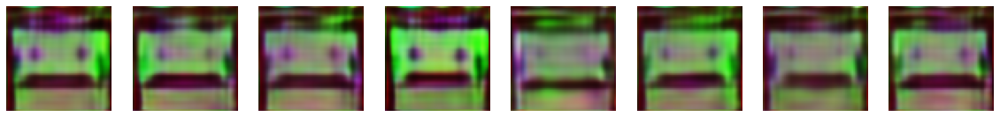

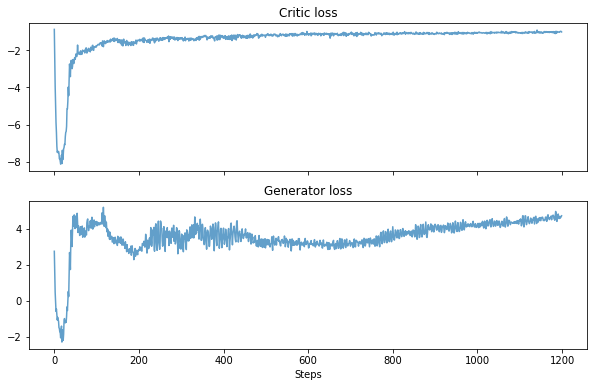

Step 1300: g_loss 4.8246 critic_loss -0.9958 critic fake -1.6739  critic_real 0.6747 penalty 0.0033


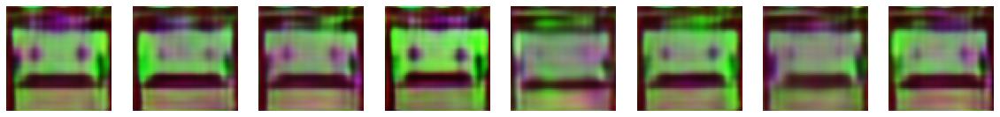

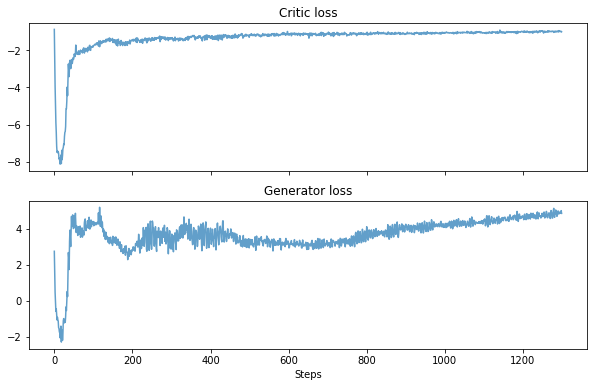

Step 1400: g_loss 4.8949 critic_loss -0.9818 critic fake -1.7262  critic_real 0.6733 penalty 0.0711


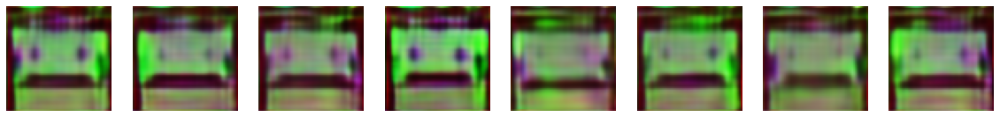

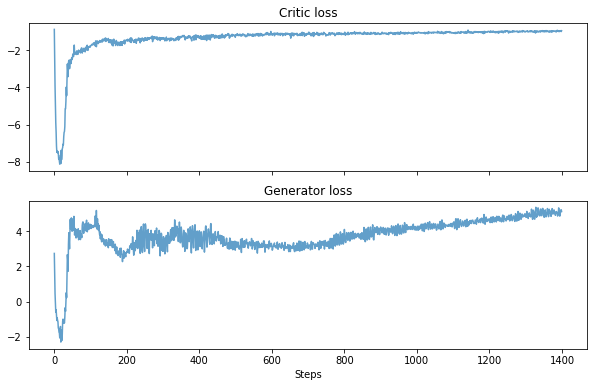

Step 1500: g_loss 4.8893 critic_loss -0.9575 critic fake -1.6961  critic_real 0.7218 penalty 0.0169


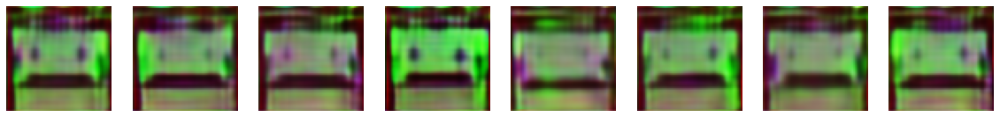

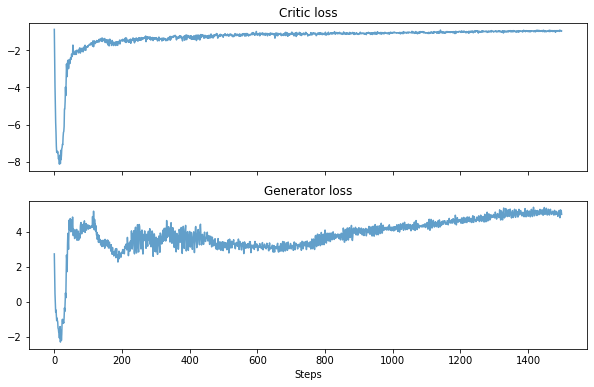

Step 1600: g_loss 5.0760 critic_loss -0.9719 critic fake -1.8589  critic_real 0.8712 penalty 0.0158


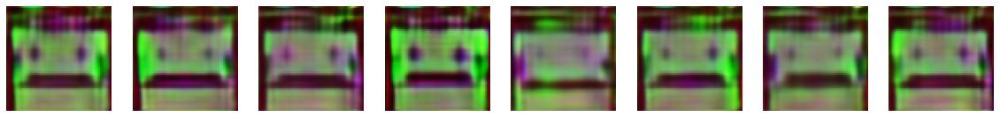

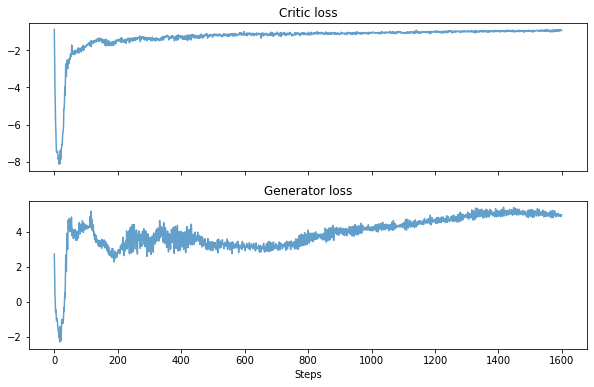

Step 1700: g_loss 5.0273 critic_loss -0.9214 critic fake -1.8225  critic_real 0.8828 penalty 0.0184


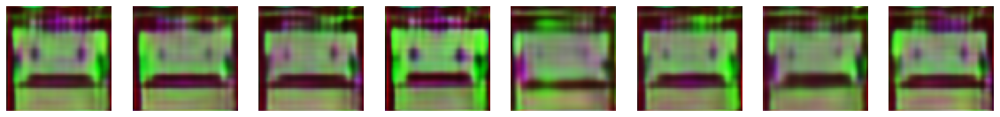

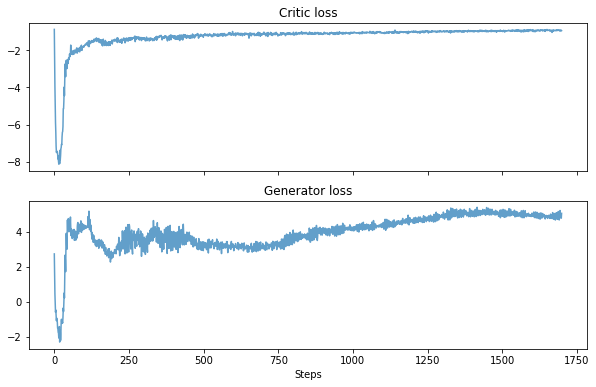

Step 1800: g_loss 5.1303 critic_loss -0.8986 critic fake -1.9065  critic_real 1.0029 penalty 0.0050


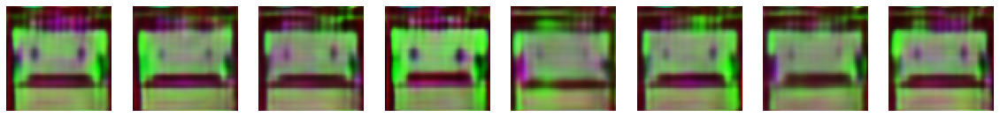

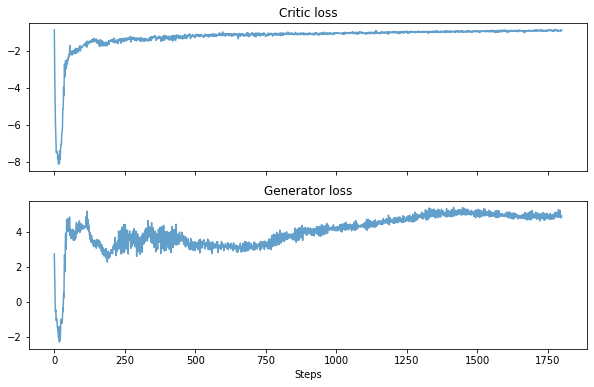

Step 1900: g_loss 5.1216 critic_loss -0.8830 critic fake -1.9213  critic_real 1.0382 penalty 0.0000


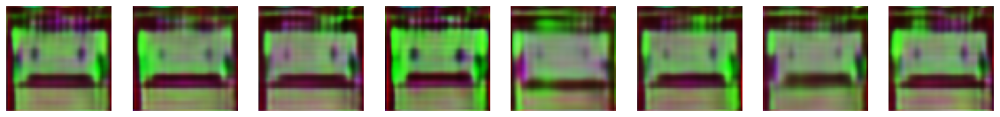

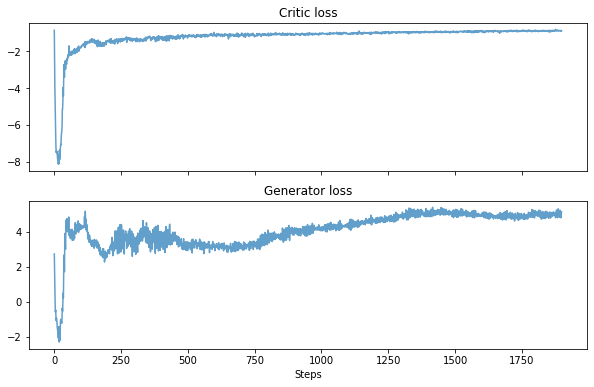

Step 2000: g_loss 5.1982 critic_loss -0.8739 critic fake -1.9851  critic_real 1.1040 penalty 0.0072


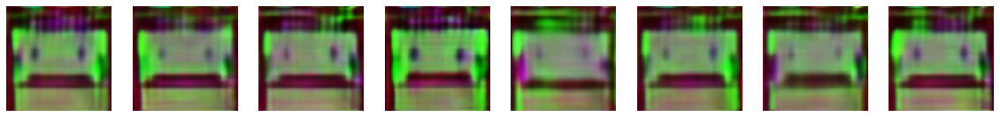

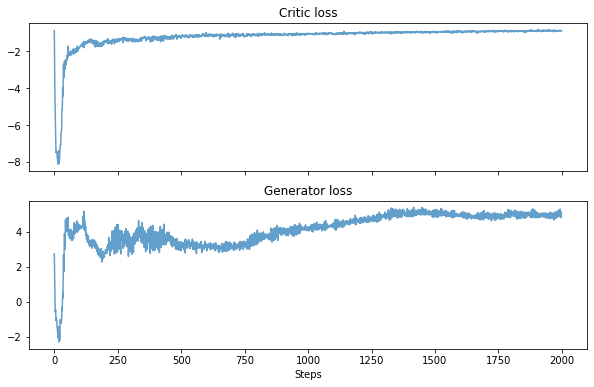

Step 2100: g_loss 5.2040 critic_loss -0.8906 critic fake -1.9833  critic_real 1.0924 penalty 0.0003


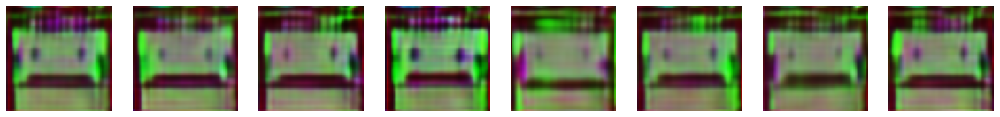

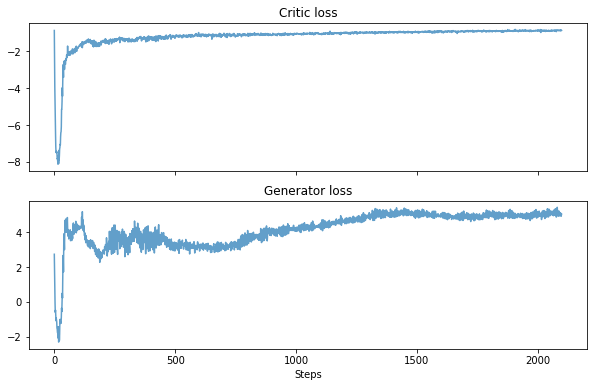

Step 2200: g_loss 5.2466 critic_loss -0.8570 critic fake -2.0049  critic_real 1.1359 penalty 0.0120


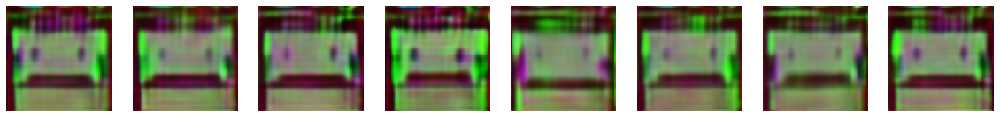

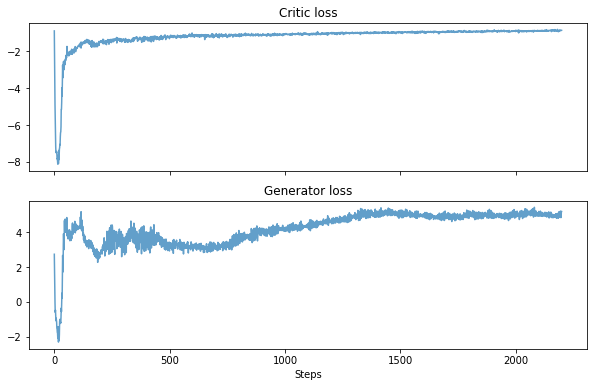

Step 2300: g_loss 4.9241 critic_loss -0.8713 critic fake -1.7169  critic_real 0.8276 penalty 0.0180


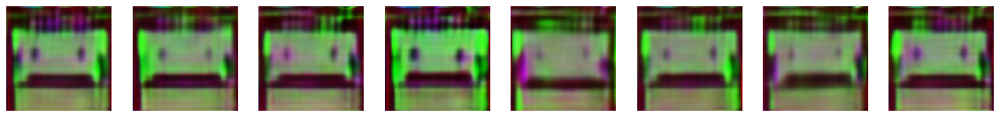

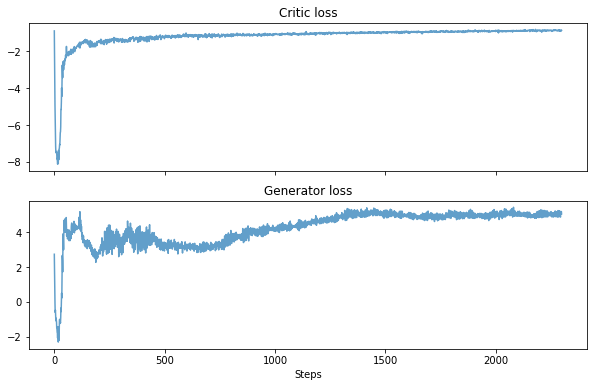

Step 2400: g_loss 4.9905 critic_loss -0.8500 critic fake -1.7404  critic_real 0.8832 penalty 0.0073


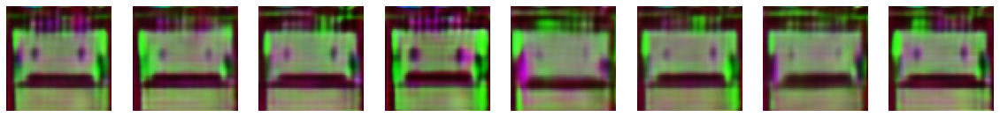

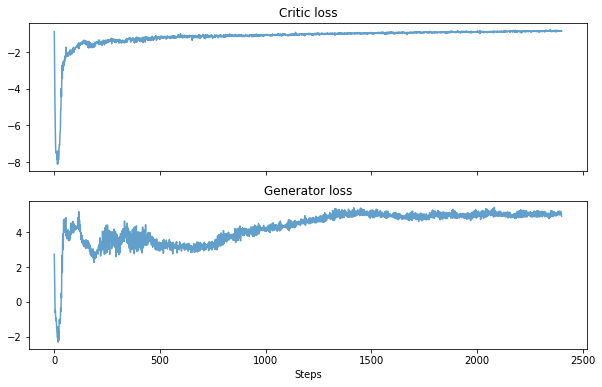

Step 2500: g_loss 5.0639 critic_loss -0.8407 critic fake -1.8024  critic_real 0.9573 penalty 0.0044


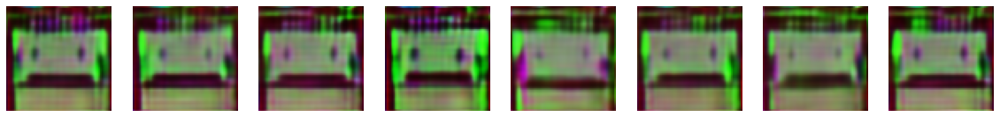

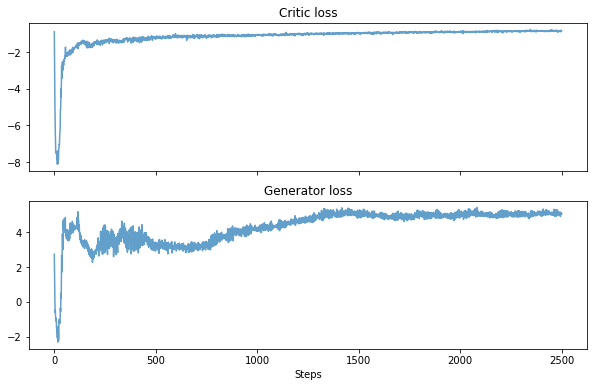

Step 2600: g_loss 5.0989 critic_loss -0.8271 critic fake -1.8740  critic_real 1.0461 penalty 0.0007


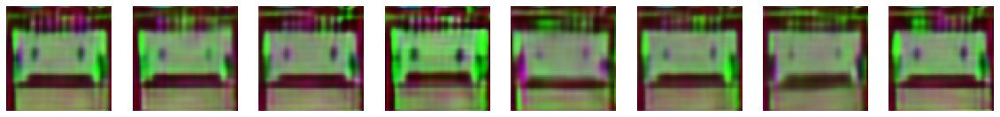

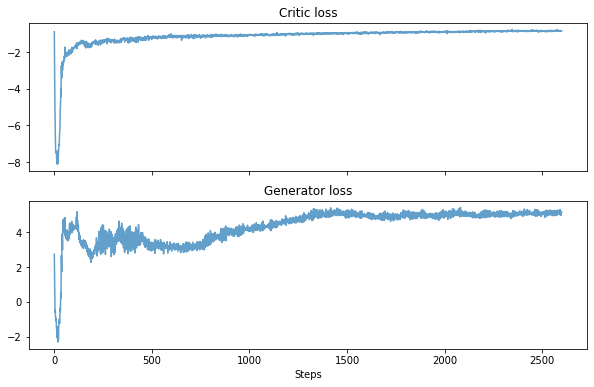

Step 2700: g_loss 5.3222 critic_loss -0.8250 critic fake -2.0566  critic_real 1.2308 penalty 0.0008


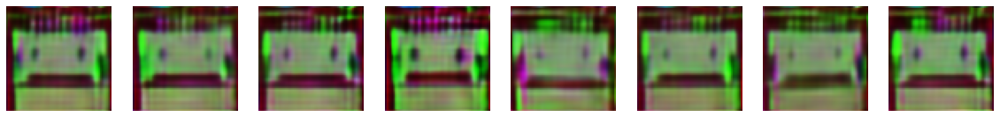

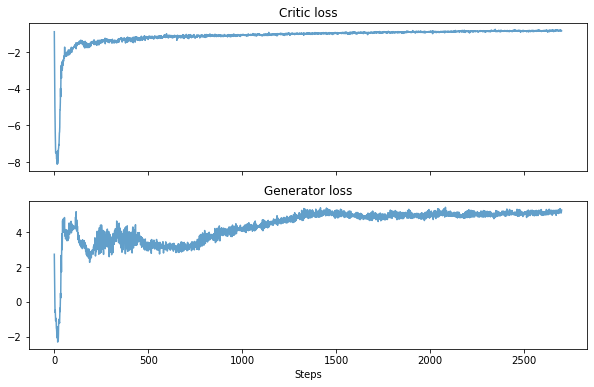

Step 2800: g_loss 5.5871 critic_loss -0.8823 critic fake -2.3223  critic_real 1.4387 penalty 0.0013


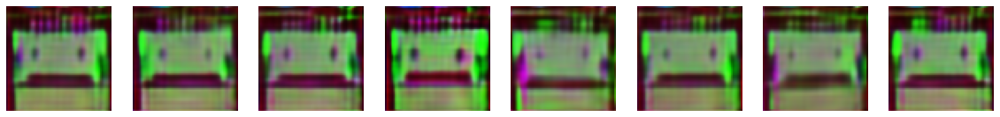

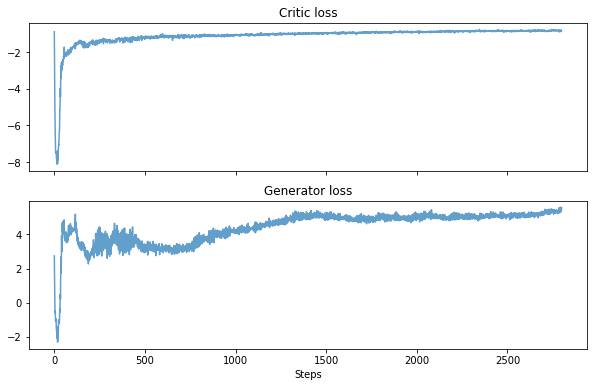

Step 2900: g_loss 5.5298 critic_loss -0.8060 critic fake -2.2285  critic_real 1.4179 penalty 0.0046


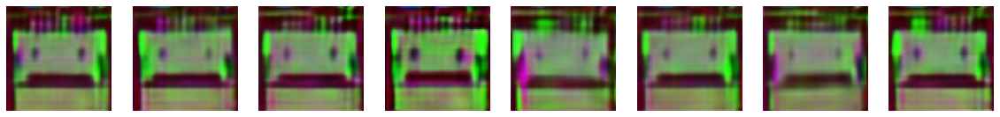

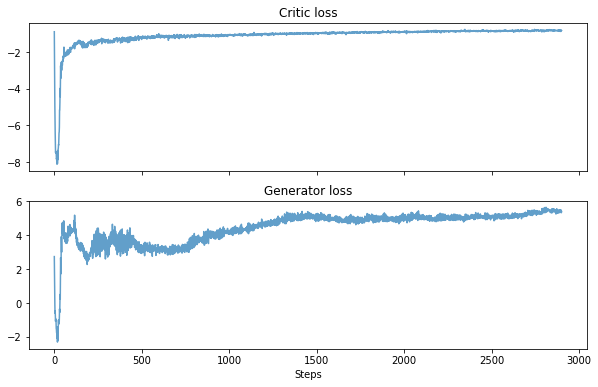

Step 3000: g_loss 5.5287 critic_loss -0.8192 critic fake -2.2061  critic_real 1.3653 penalty 0.0216


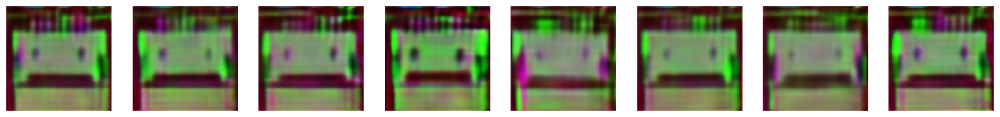

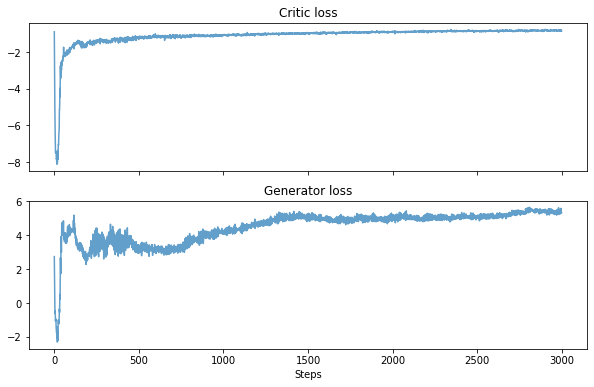

Step 3100: g_loss 5.6105 critic_loss -0.7971 critic fake -2.3380  critic_real 1.5408 penalty 0.0001


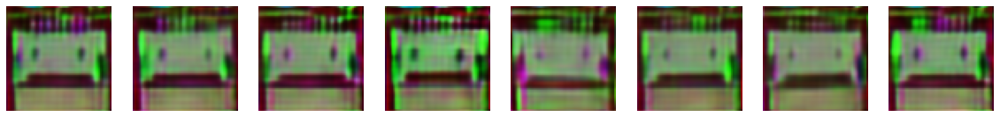

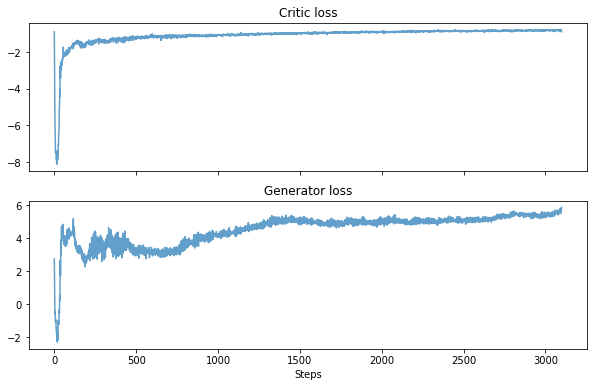

Step 3200: g_loss 5.5257 critic_loss -0.8236 critic fake -2.2190  critic_real 1.3699 penalty 0.0255


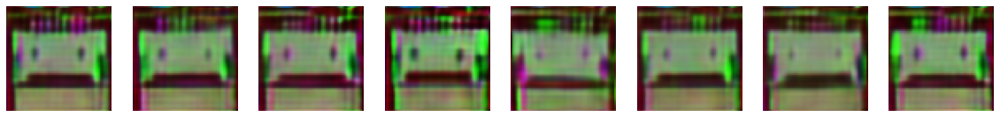

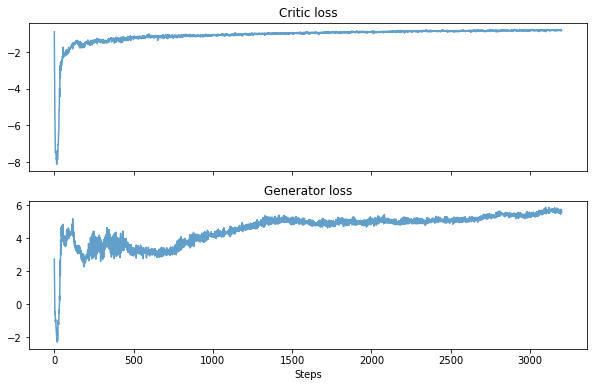

Step 3300: g_loss 5.3835 critic_loss -0.8287 critic fake -2.0727  critic_real 1.2439 penalty 0.0001


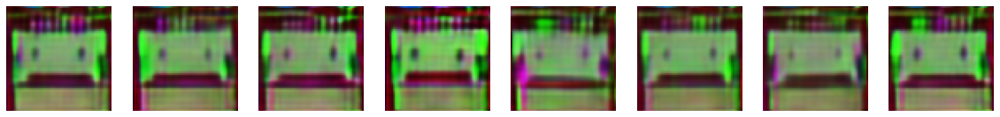

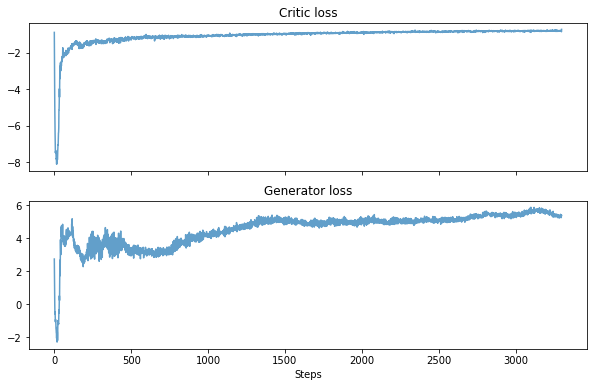

Step 3400: g_loss 5.1766 critic_loss -0.7415 critic fake -1.8227  critic_real 1.0127 penalty 0.0685


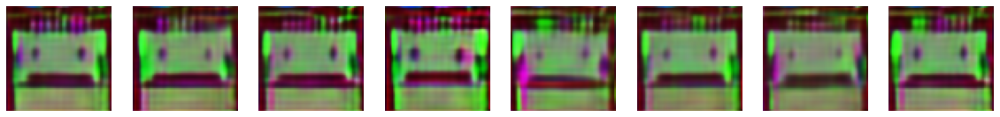

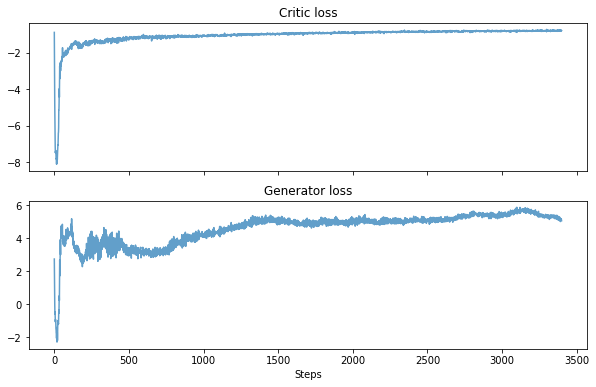

Step 3500: g_loss 5.0952 critic_loss -0.7523 critic fake -1.7675  critic_real 1.0004 penalty 0.0147


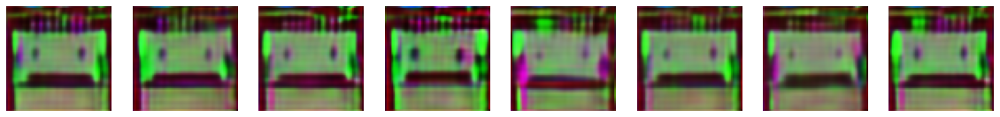

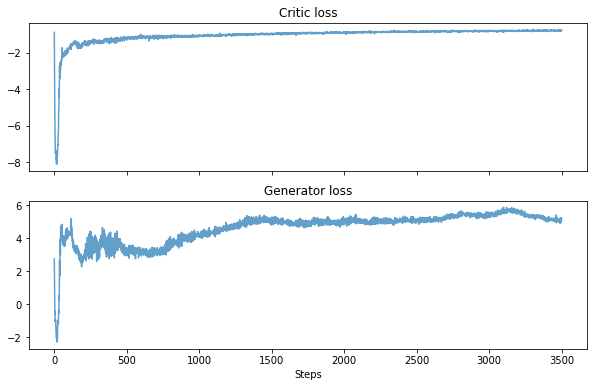

Step 3600: g_loss 5.2422 critic_loss -0.8070 critic fake -1.9141  critic_real 1.1035 penalty 0.0036


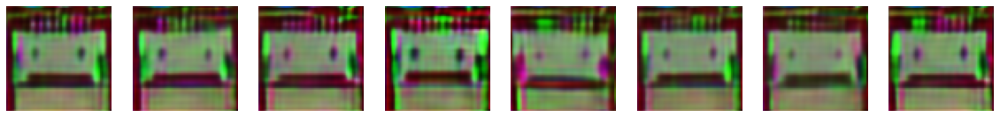

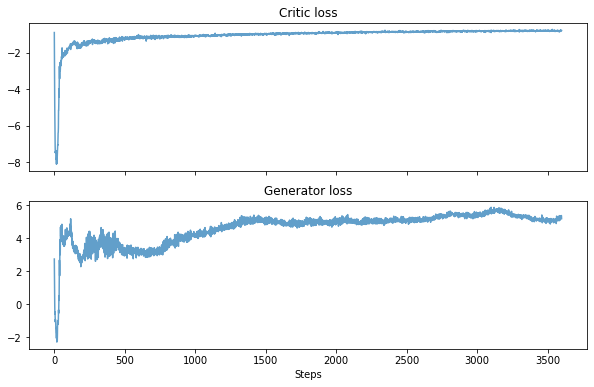

Step 3700: g_loss 5.5460 critic_loss -0.7831 critic fake -2.2156  critic_real 1.4302 penalty 0.0023


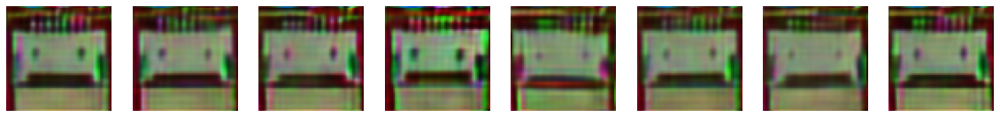

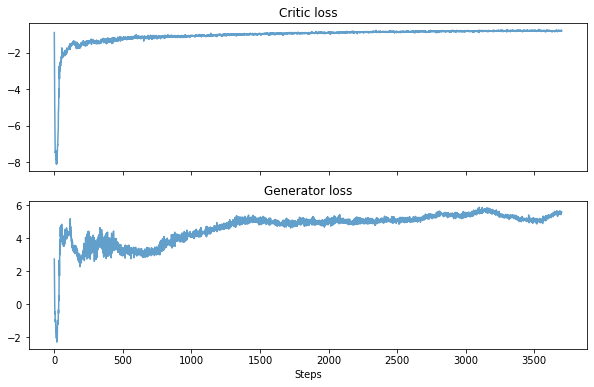

Step 3800: g_loss 5.5956 critic_loss -0.7793 critic fake -2.2427  critic_real 1.4530 penalty 0.0104


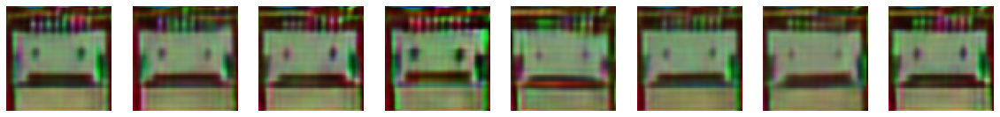

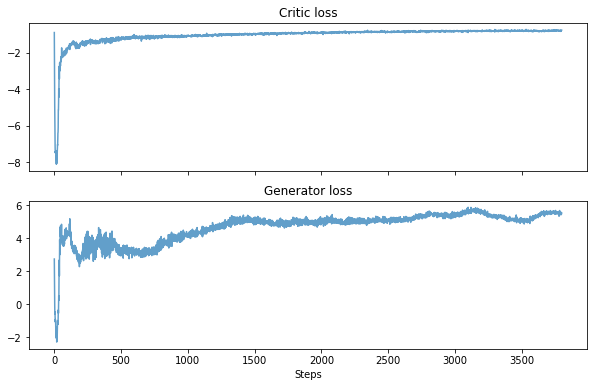

Step 3900: g_loss 5.3615 critic_loss -0.7894 critic fake -2.0196  critic_real 1.2154 penalty 0.0148


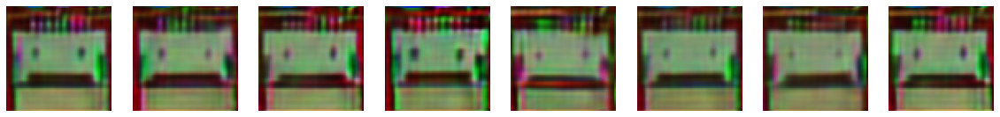

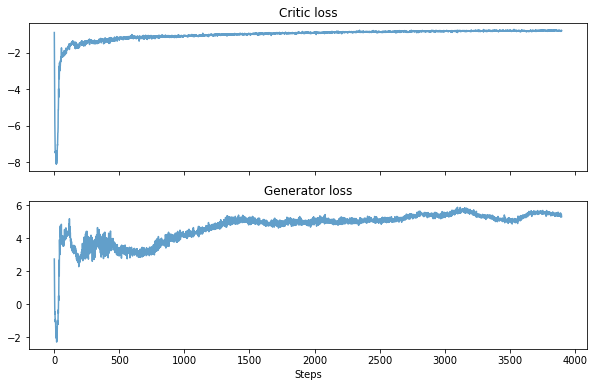

Step 4000: g_loss 5.3469 critic_loss -0.7933 critic fake -1.9755  critic_real 1.1762 penalty 0.0061


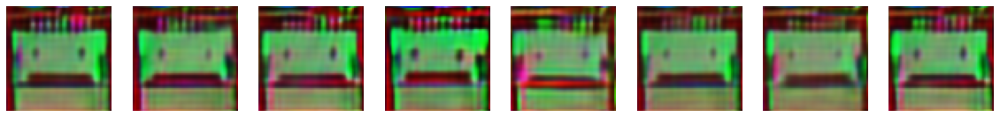

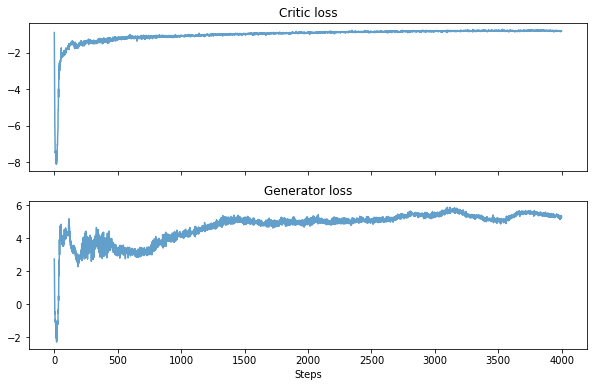

Step 4100: g_loss 5.2429 critic_loss -0.8041 critic fake -1.8965  critic_real 1.0890 penalty 0.0035


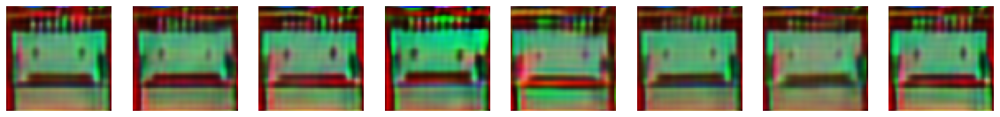

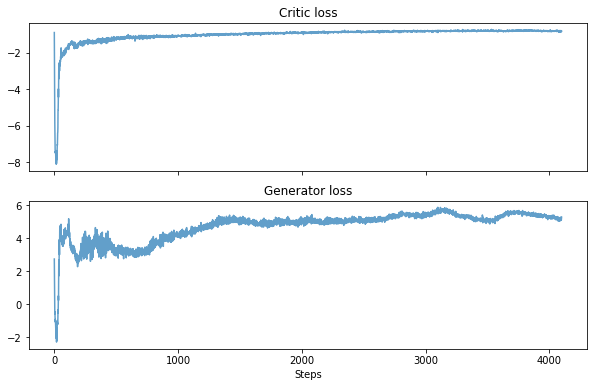

Step 4200: g_loss 5.6345 critic_loss -0.8621 critic fake -2.3033  critic_real 1.4104 penalty 0.0308


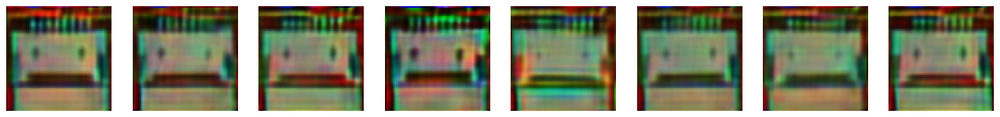

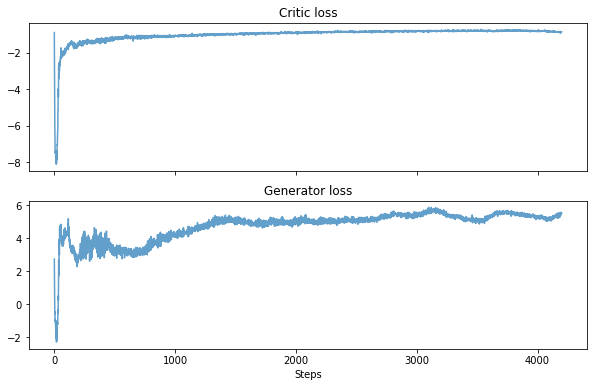

Step 4300: g_loss 5.4306 critic_loss -0.8259 critic fake -2.0568  critic_real 1.2207 penalty 0.0103


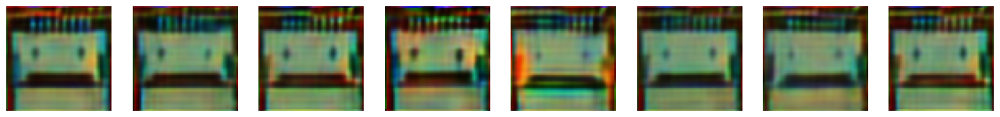

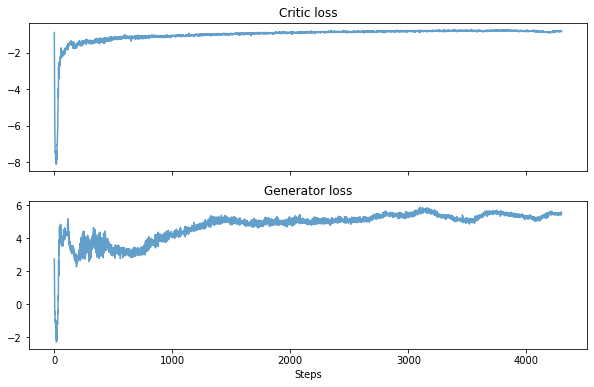

Step 4400: g_loss 5.3574 critic_loss -0.7746 critic fake -1.9869  critic_real 1.2121 penalty 0.0002


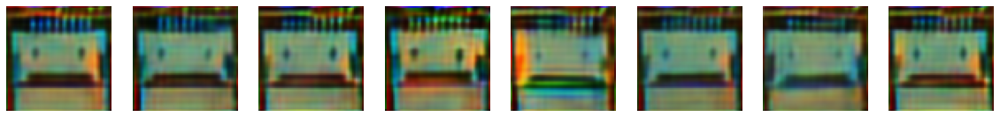

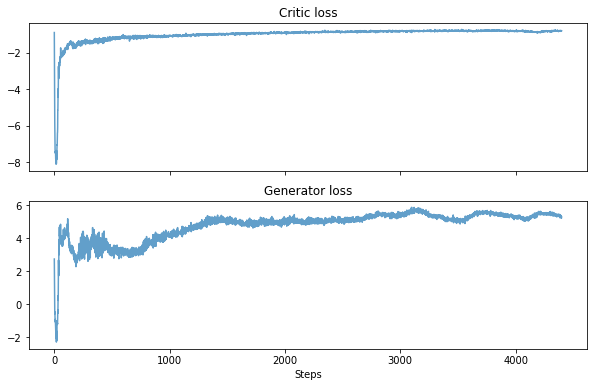

Step 4500: g_loss 5.0985 critic_loss -0.7746 critic fake -1.7814  critic_real 1.0066 penalty 0.0002


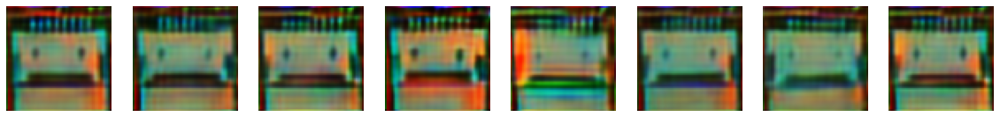

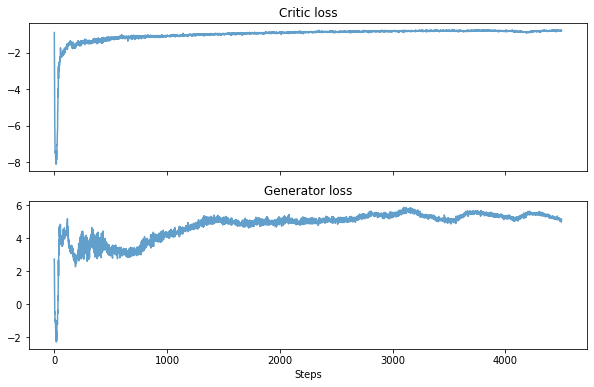

Step 4600: g_loss 5.0648 critic_loss -0.8050 critic fake -1.7276  critic_real 0.9065 penalty 0.0160


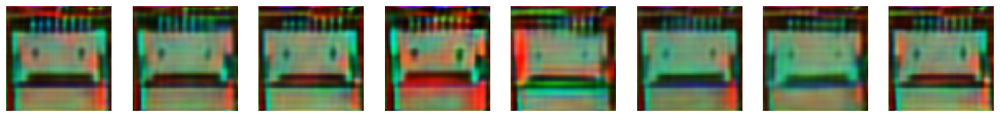

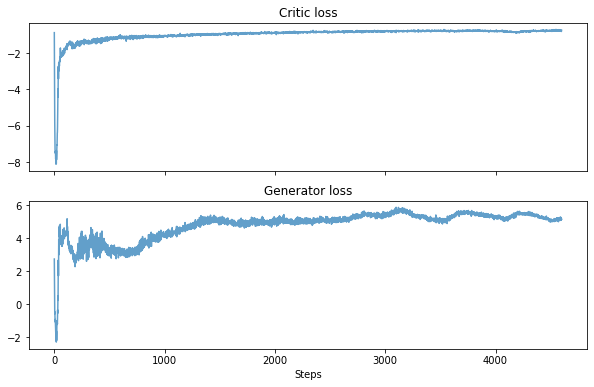

Step 4700: g_loss 5.1806 critic_loss -0.7422 critic fake -1.8236  critic_real 1.0798 penalty 0.0016


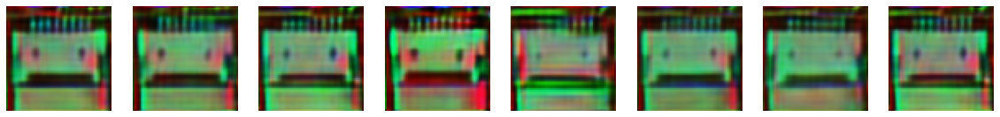

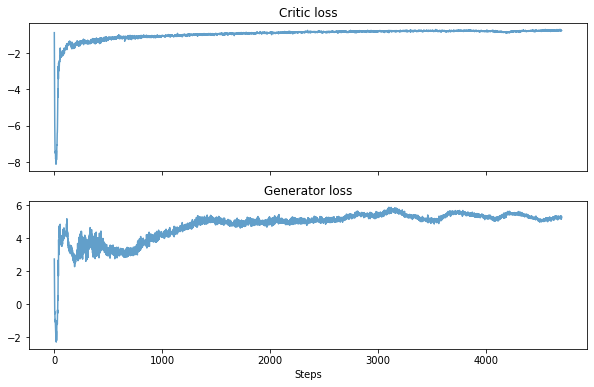

Step 4800: g_loss 5.1848 critic_loss -0.7525 critic fake -1.8050  critic_real 1.0260 penalty 0.0265


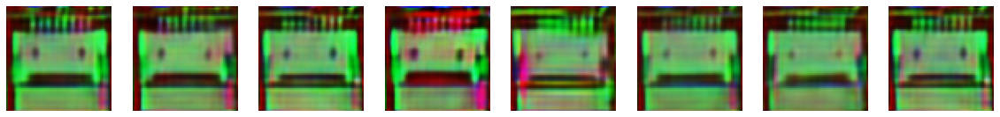

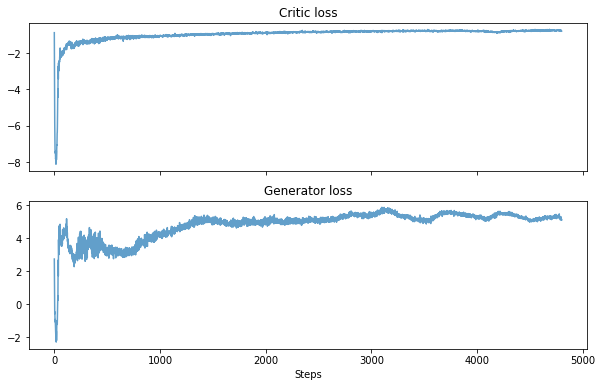

Step 4900: g_loss 5.4270 critic_loss -0.7490 critic fake -2.0521  critic_real 1.2732 penalty 0.0299


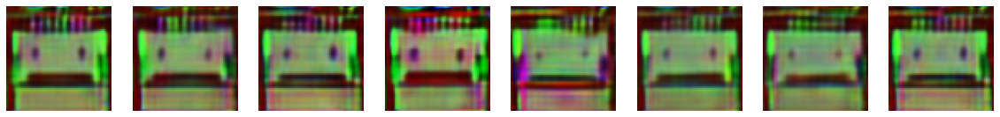

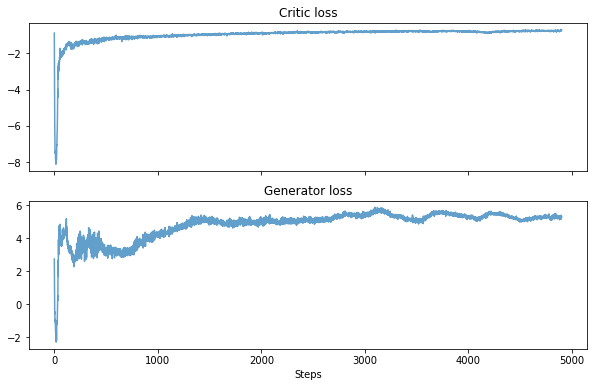

Step 5000: g_loss 5.3493 critic_loss -0.7290 critic fake -1.9656  critic_real 1.2337 penalty 0.0029


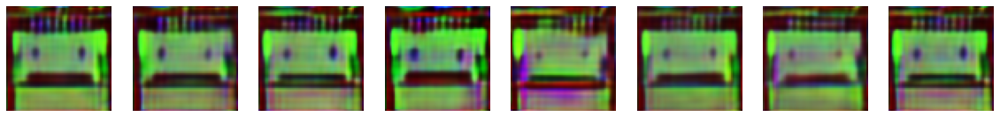

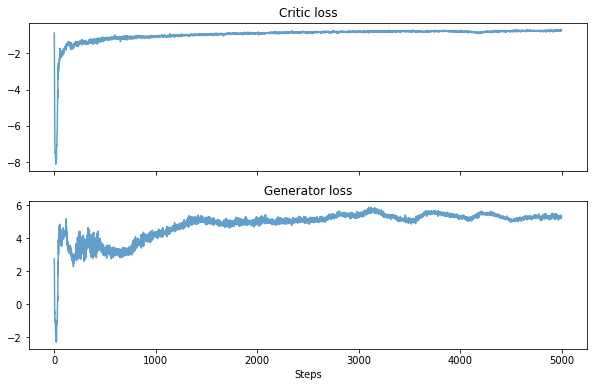

Step 5100: g_loss 5.3370 critic_loss -0.7507 critic fake -1.9703  critic_real 1.1940 penalty 0.0256


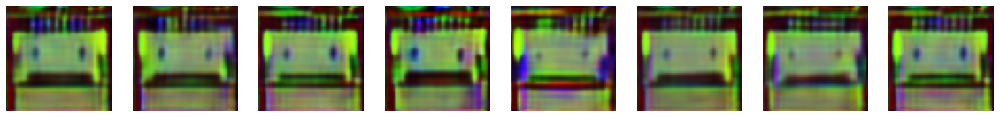

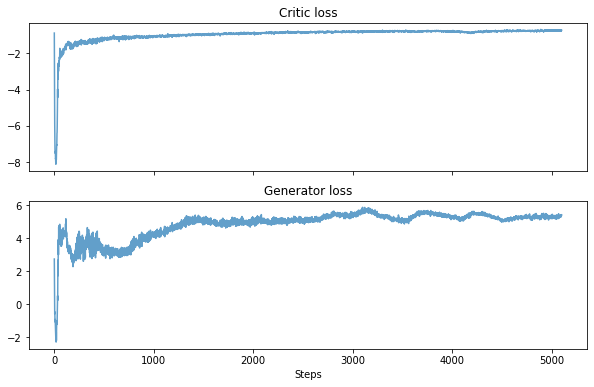

Step 5200: g_loss 5.6476 critic_loss -0.7482 critic fake -2.2576  critic_real 1.5020 penalty 0.0074


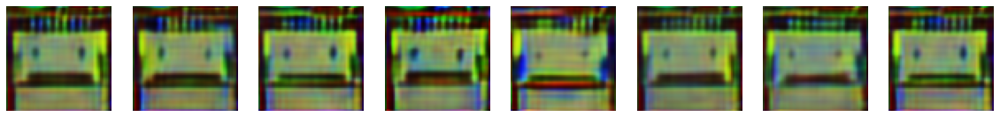

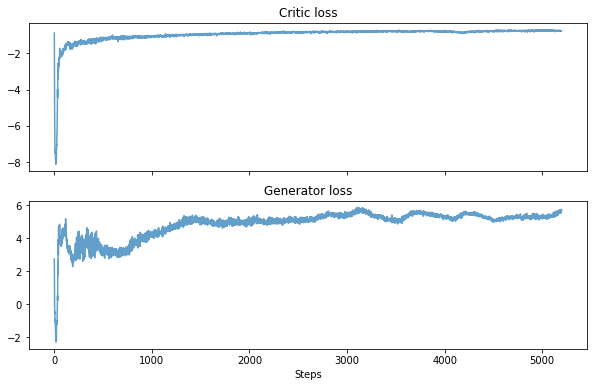

Step 5300: g_loss 5.6907 critic_loss -0.7726 critic fake -2.3219  critic_real 1.5481 penalty 0.0012


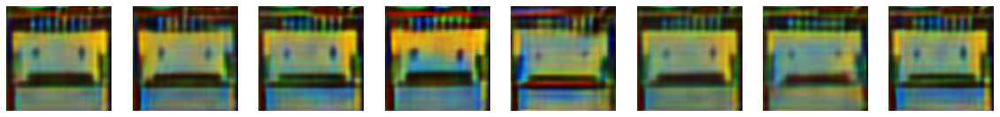

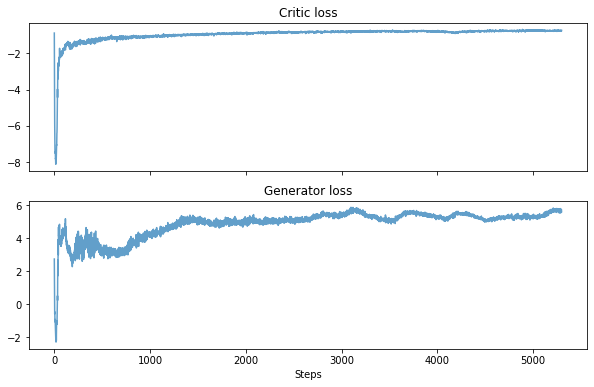

Step 5400: g_loss 5.5732 critic_loss -0.7596 critic fake -2.1820  critic_real 1.4158 penalty 0.0066


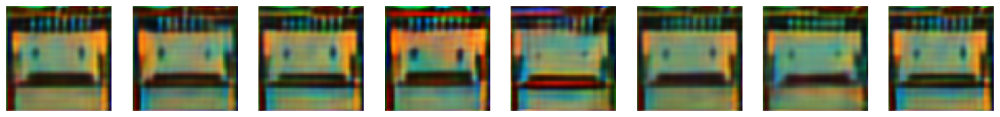

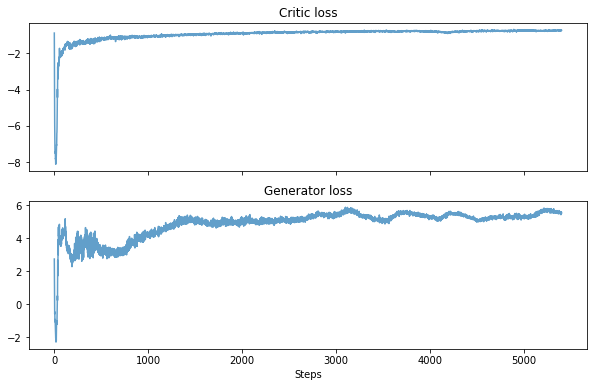

Step 5500: g_loss 5.5266 critic_loss -0.7337 critic fake -2.0938  critic_real 1.3493 penalty 0.0108


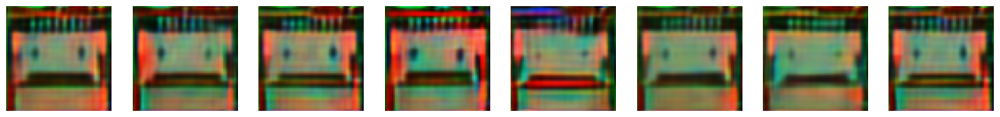

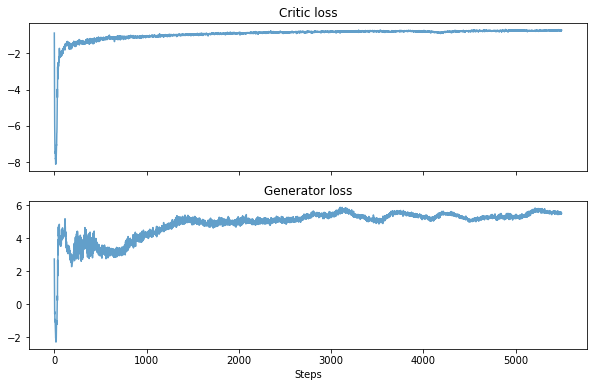

Step 5600: g_loss 5.5018 critic_loss -0.7786 critic fake -2.0870  critic_real 1.2999 penalty 0.0085


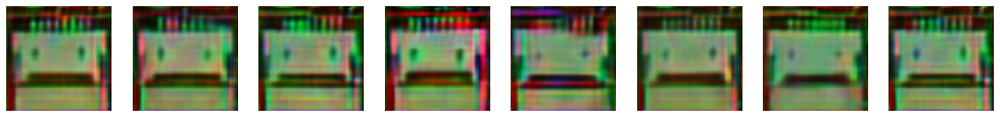

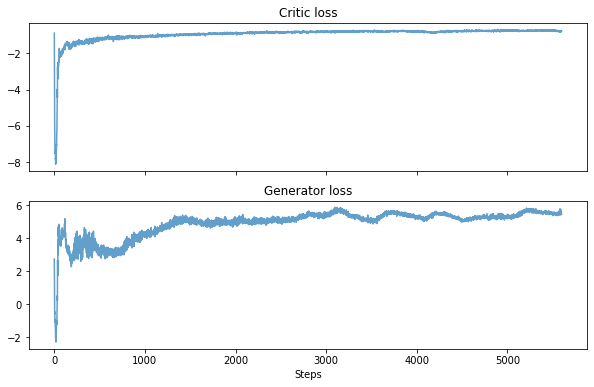

Step 5700: g_loss 5.6190 critic_loss -0.7788 critic fake -2.2135  critic_real 1.4199 penalty 0.0148


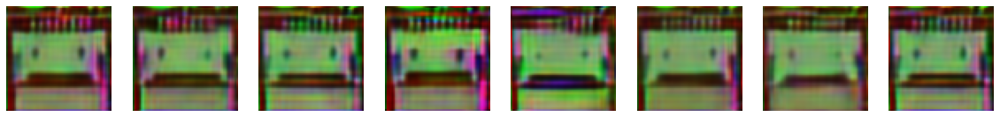

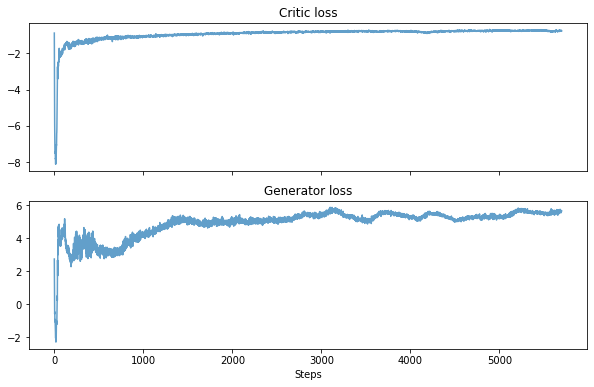

Step 5800: g_loss 5.6345 critic_loss -0.7666 critic fake -2.2197  critic_real 1.4493 penalty 0.0038


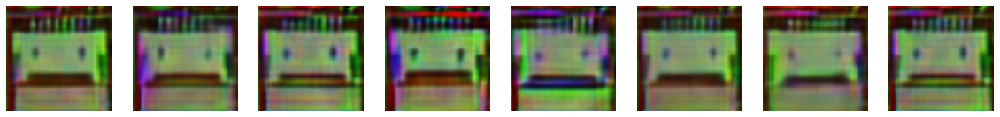

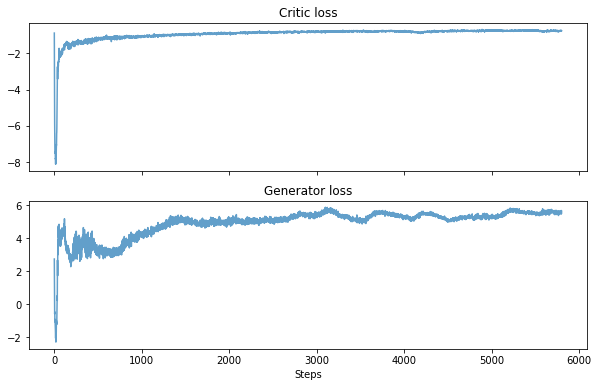

Step 5900: g_loss 5.7857 critic_loss -0.7597 critic fake -2.3472  critic_real 1.5795 penalty 0.0080


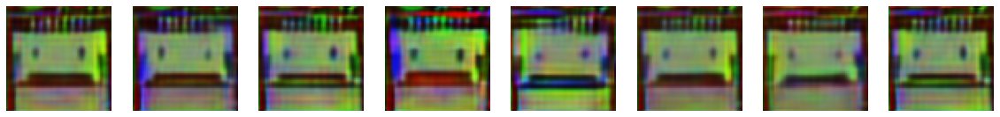

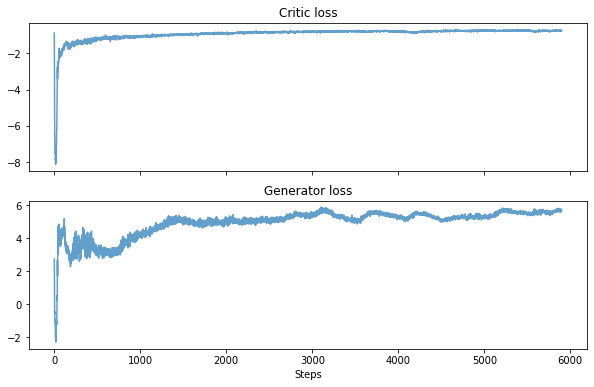

Step 6000: g_loss 5.8591 critic_loss -0.7406 critic fake -2.4557  critic_real 1.7122 penalty 0.0029


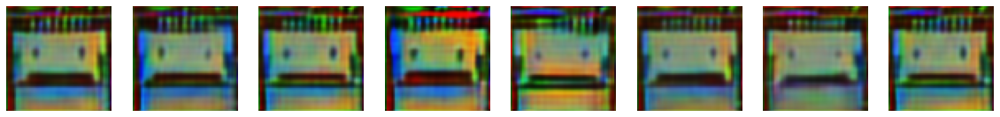

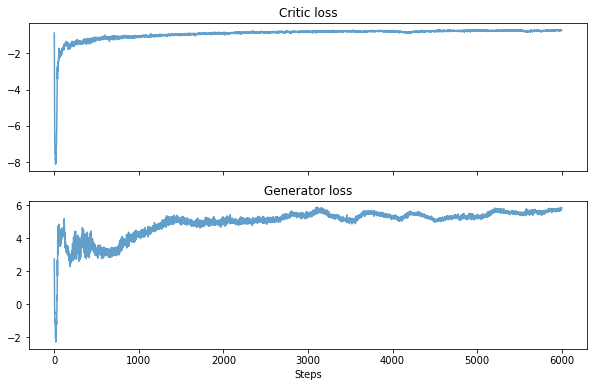

Step 6100: g_loss 5.8209 critic_loss -0.7133 critic fake -2.3645  critic_real 1.6314 penalty 0.0199


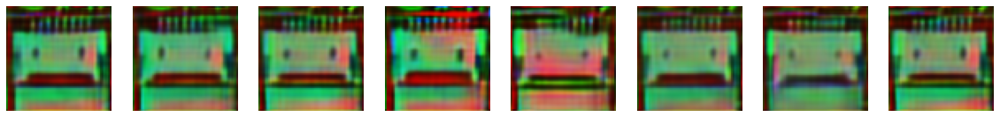

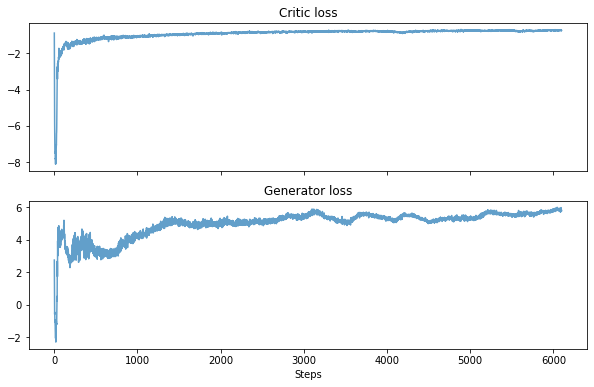

Step 6200: g_loss 5.6652 critic_loss -0.7367 critic fake -2.2520  critic_real 1.5118 penalty 0.0036


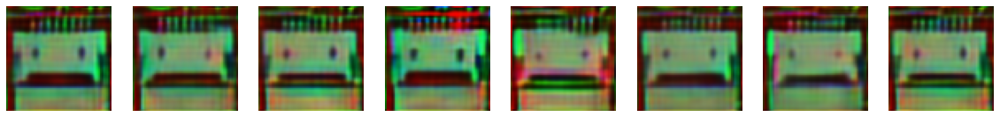

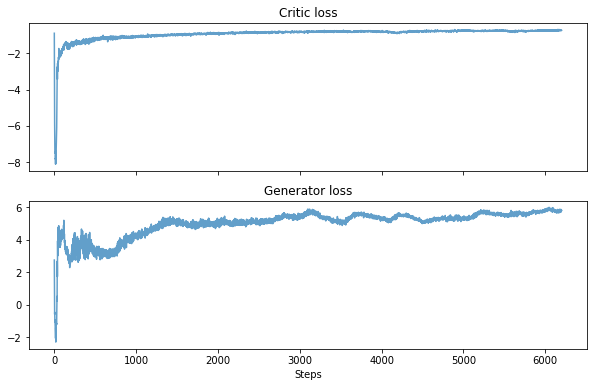

Step 6300: g_loss 5.8189 critic_loss -0.6767 critic fake -2.3795  critic_real 1.6999 penalty 0.0028


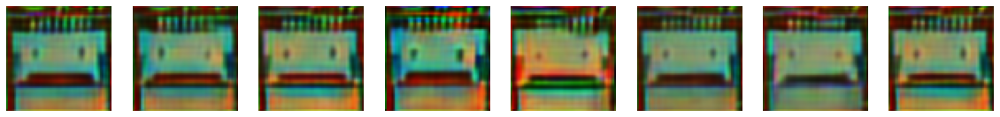

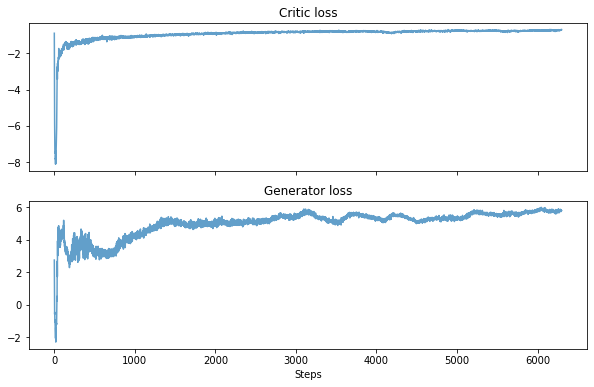

Step 6400: g_loss 5.8596 critic_loss -0.6987 critic fake -2.3990  critic_real 1.6951 penalty 0.0052


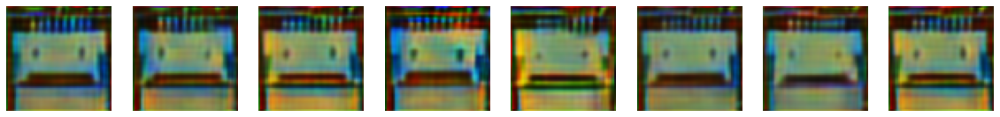

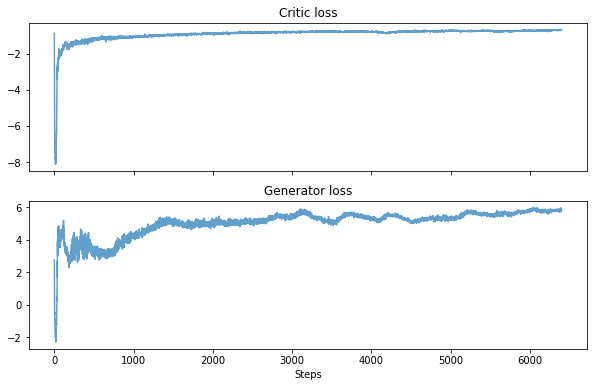

Step 6500: g_loss 5.7781 critic_loss -0.6858 critic fake -2.3256  critic_real 1.6381 penalty 0.0017


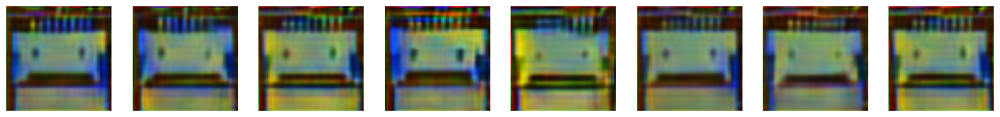

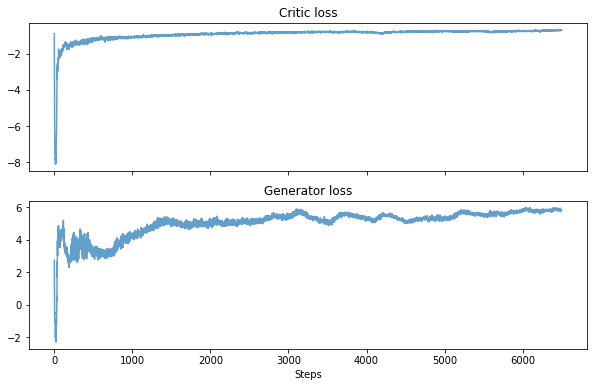

Step 6600: g_loss 5.8011 critic_loss -0.6555 critic fake -2.2929  critic_real 1.6050 penalty 0.0323


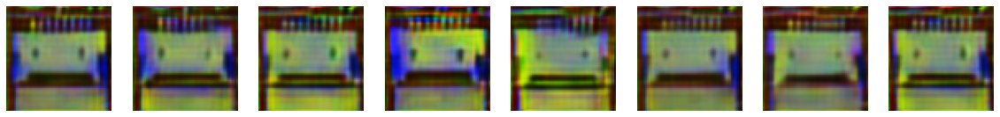

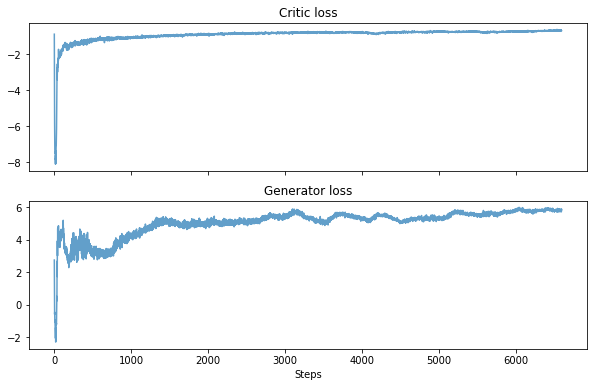

Step 6700: g_loss 5.7474 critic_loss -0.6652 critic fake -2.2291  critic_real 1.5594 penalty 0.0045


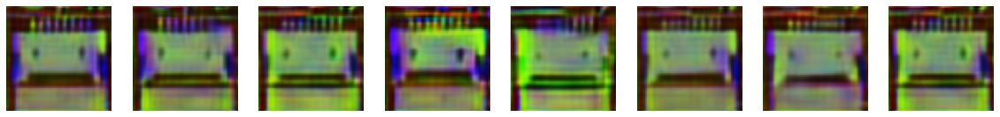

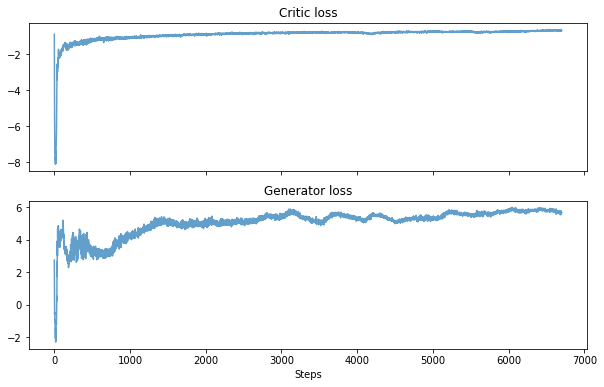

Step 6800: g_loss 5.6963 critic_loss -0.7178 critic fake -2.2175  critic_real 1.4935 penalty 0.0062


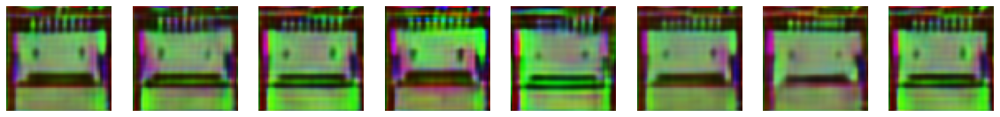

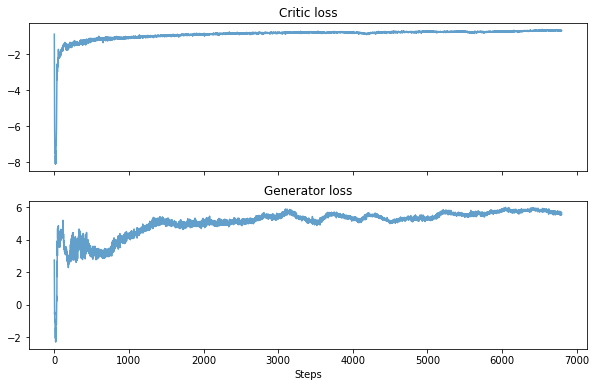

Step 6900: g_loss 5.4964 critic_loss -0.7291 critic fake -2.0131  critic_real 1.2672 penalty 0.0168


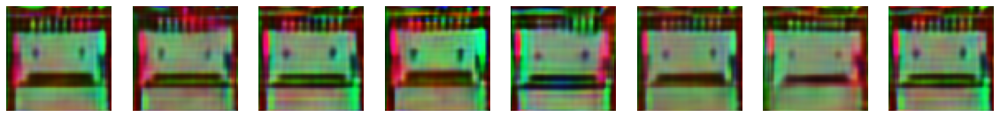

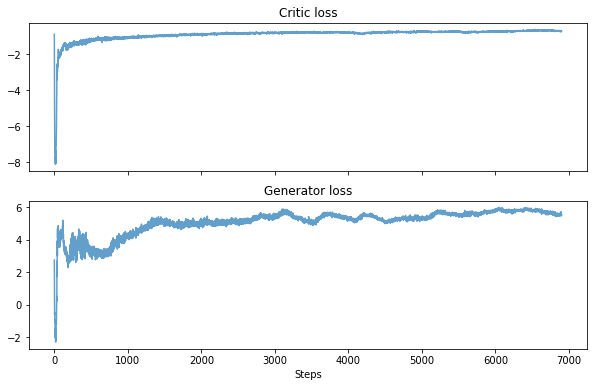

Step 7000: g_loss 5.6091 critic_loss -0.7159 critic fake -2.1379  critic_real 1.4161 penalty 0.0059


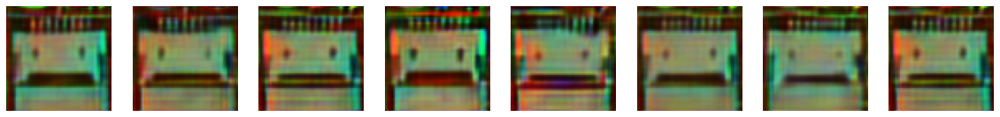

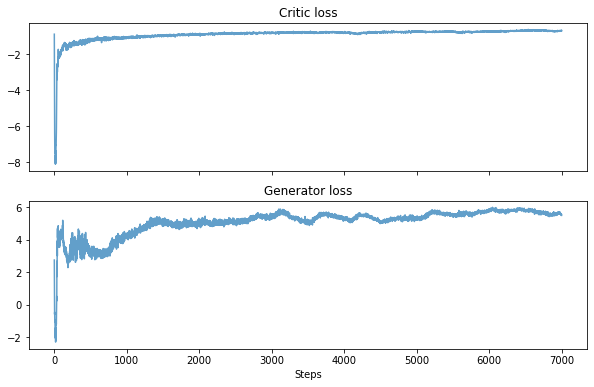

Step 7100: g_loss 5.2629 critic_loss -0.6799 critic fake -1.7876  critic_real 1.1030 penalty 0.0047


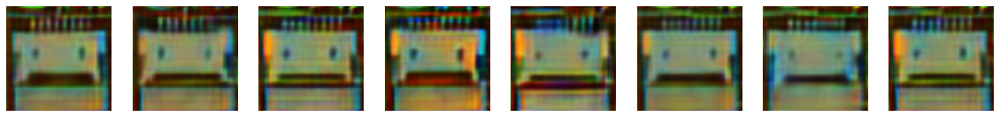

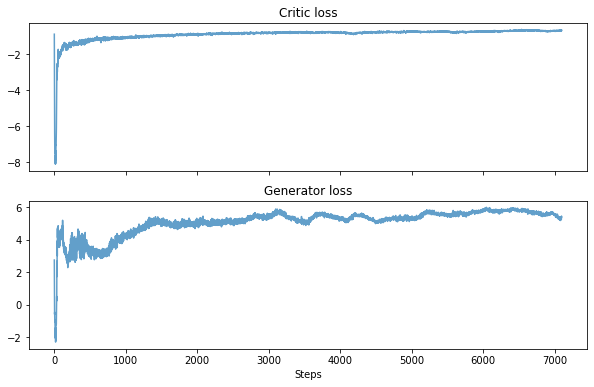

Step 7200: g_loss 5.3240 critic_loss -0.6678 critic fake -1.8103  critic_real 1.1390 penalty 0.0036


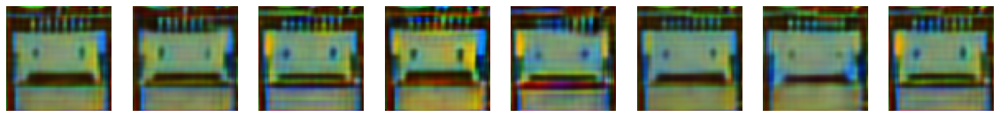

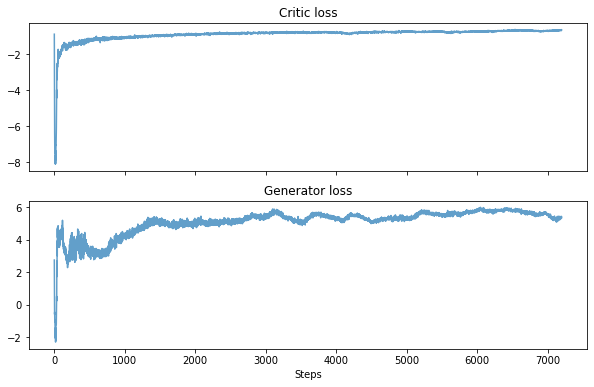

Step 7300: g_loss 5.6456 critic_loss -0.6620 critic fake -2.0870  critic_real 1.3941 penalty 0.0309


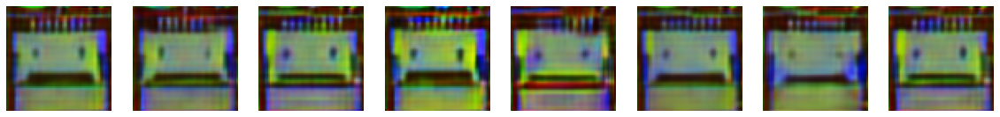

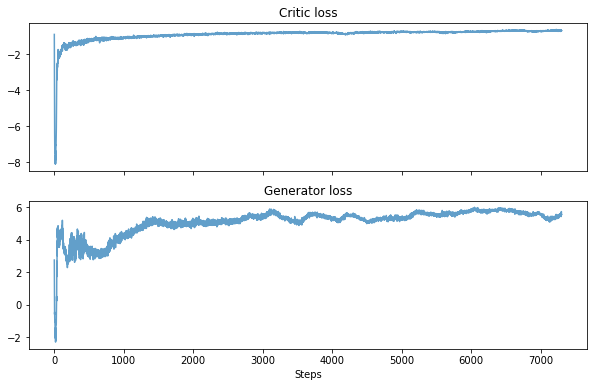

Step 7400: g_loss 5.7353 critic_loss -0.6796 critic fake -2.1812  critic_real 1.4664 penalty 0.0352


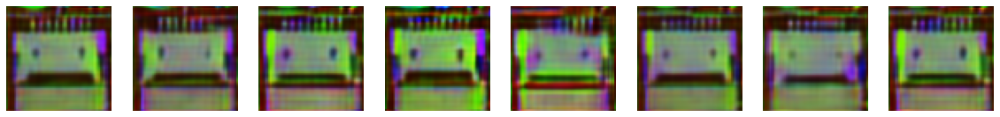

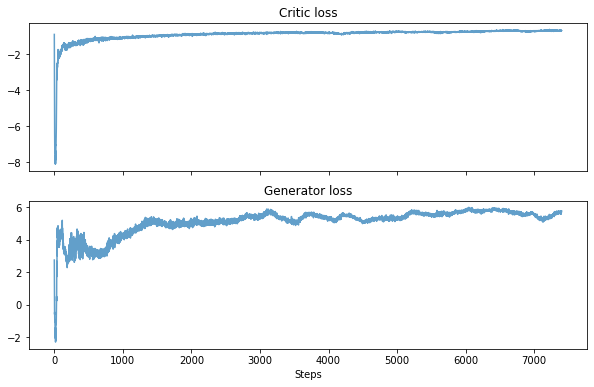

Step 7500: g_loss 5.7889 critic_loss -0.6769 critic fake -2.2295  critic_real 1.5260 penalty 0.0266


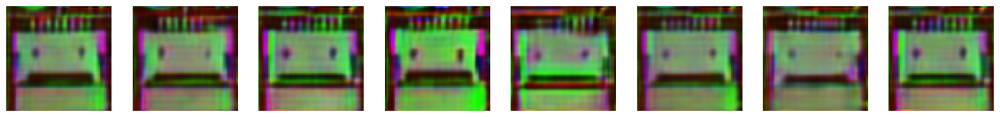

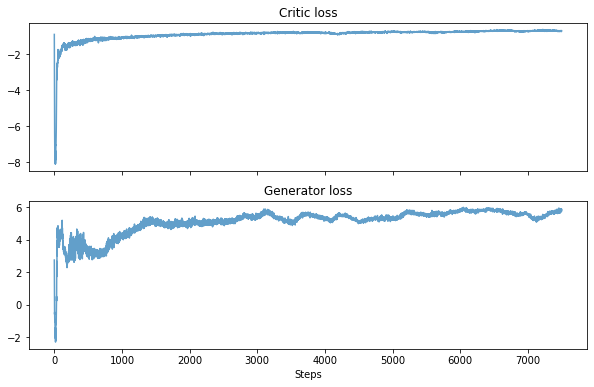

Step 7600: g_loss 5.9835 critic_loss -0.6826 critic fake -2.4576  critic_real 1.7659 penalty 0.0091


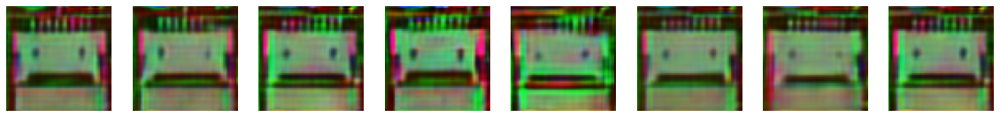

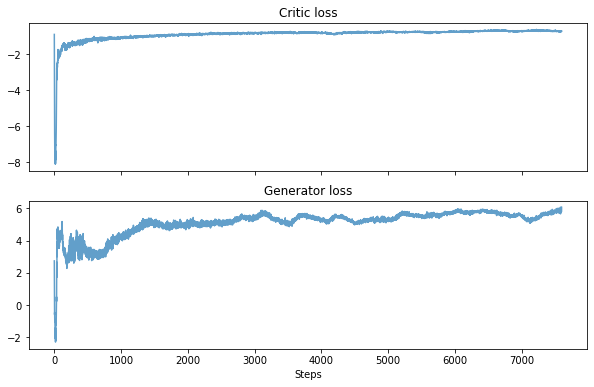

Step 7700: g_loss 5.9305 critic_loss -0.6907 critic fake -2.3994  critic_real 1.6991 penalty 0.0096


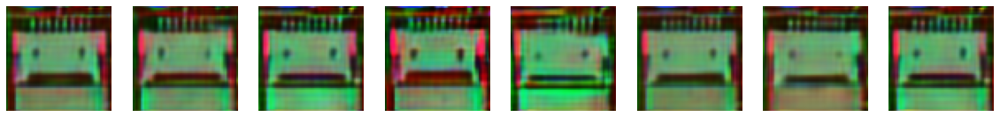

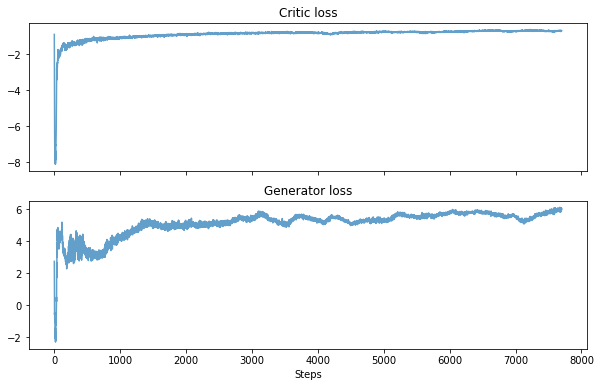

Step 7800: g_loss 5.8813 critic_loss -0.6646 critic fake -2.3300  critic_real 1.6524 penalty 0.0130


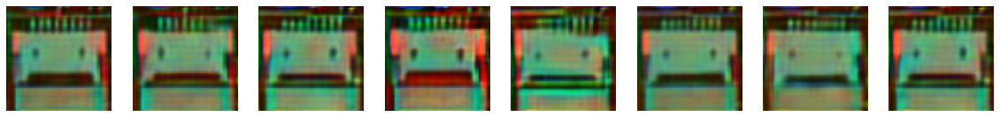

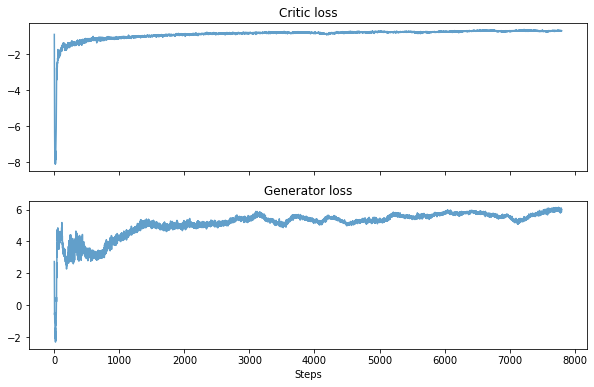

Step 7900: g_loss 5.9750 critic_loss -0.6409 critic fake -2.3840  critic_real 1.6707 penalty 0.0723


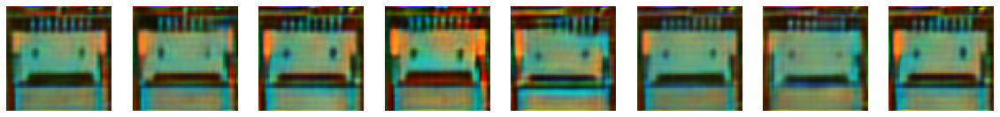

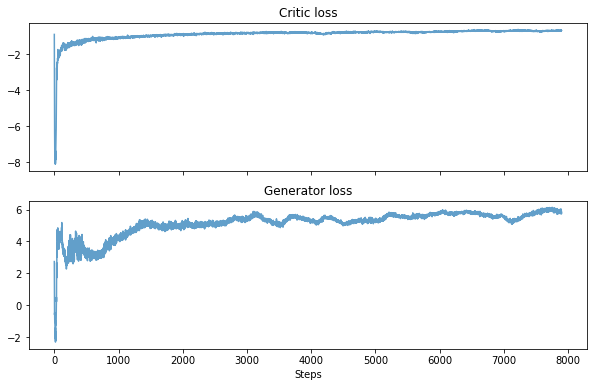

Step 8000: g_loss 5.9377 critic_loss -0.6324 critic fake -2.3710  critic_real 1.7143 penalty 0.0243


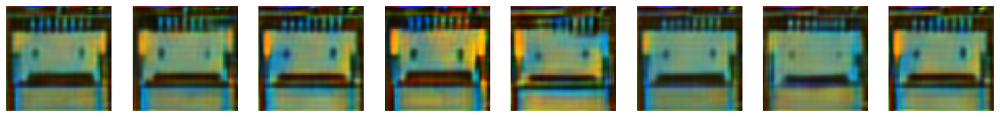

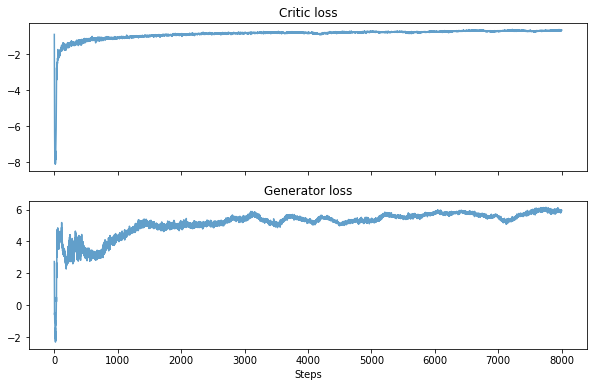

Step 8100: g_loss 6.1789 critic_loss -0.6481 critic fake -2.6058  critic_real 1.9345 penalty 0.0232


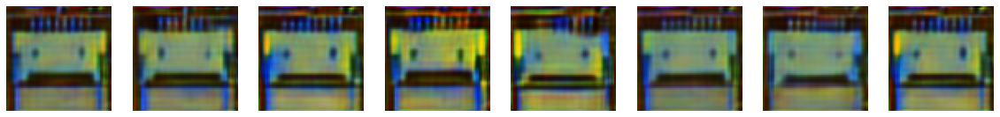

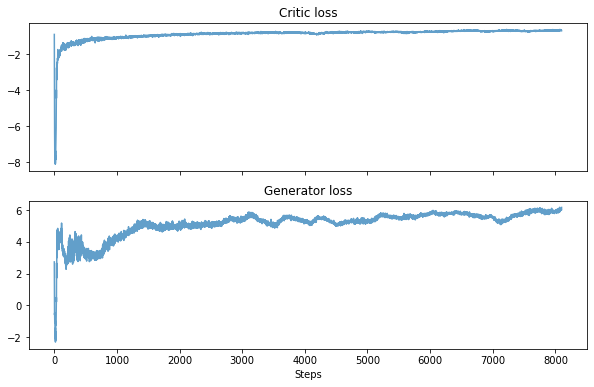

Step 8200: g_loss 5.8921 critic_loss -0.6637 critic fake -2.3367  critic_real 1.6714 penalty 0.0016


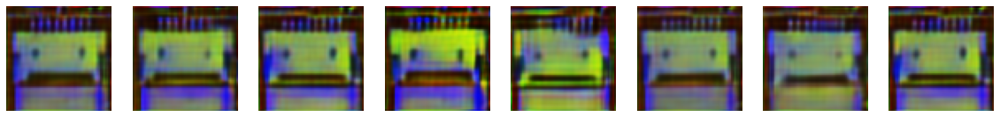

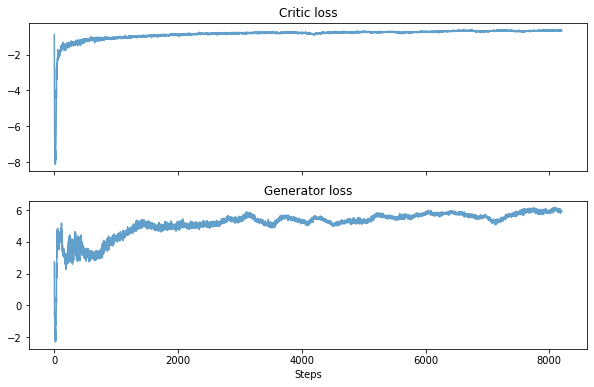

Step 8300: g_loss 5.8942 critic_loss -0.6396 critic fake -2.3640  critic_real 1.7145 penalty 0.0100


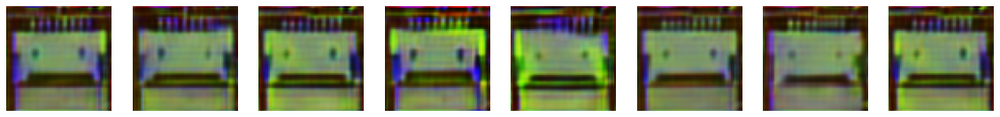

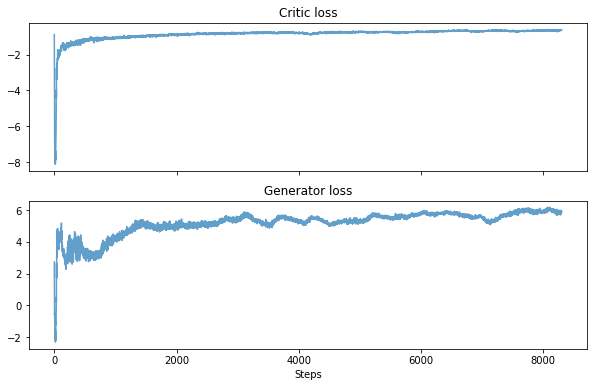

Step 8400: g_loss 5.8141 critic_loss -0.6393 critic fake -2.2716  critic_real 1.6323 penalty 0.0000


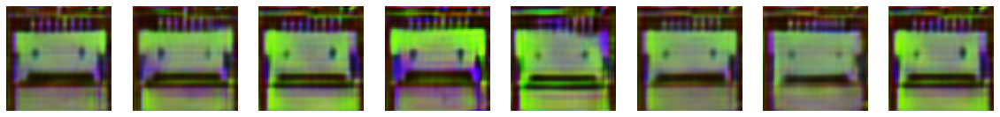

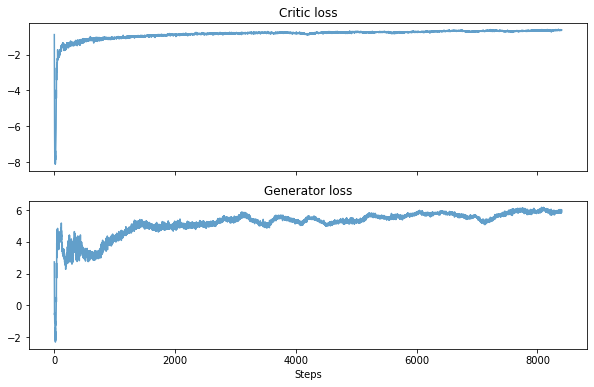

Step 8500: g_loss 5.8502 critic_loss -0.6075 critic fake -2.2615  critic_real 1.6501 penalty 0.0039


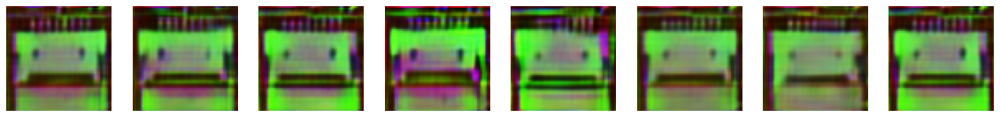

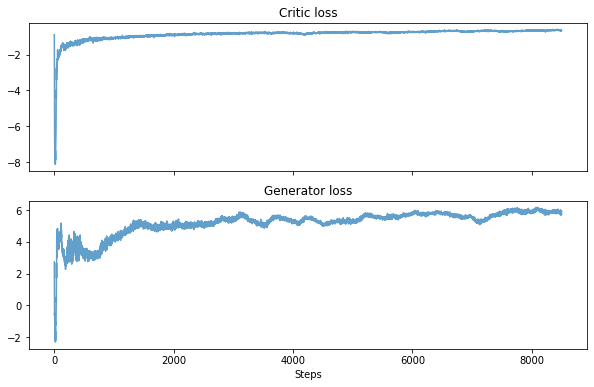

Step 8600: g_loss 5.7421 critic_loss -0.6228 critic fake -2.1411  critic_real 1.5049 penalty 0.0134


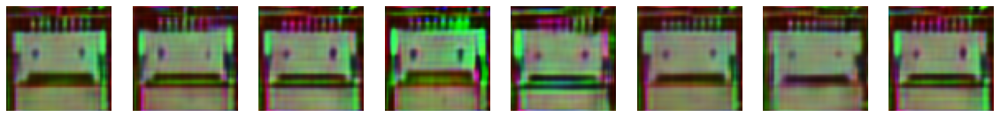

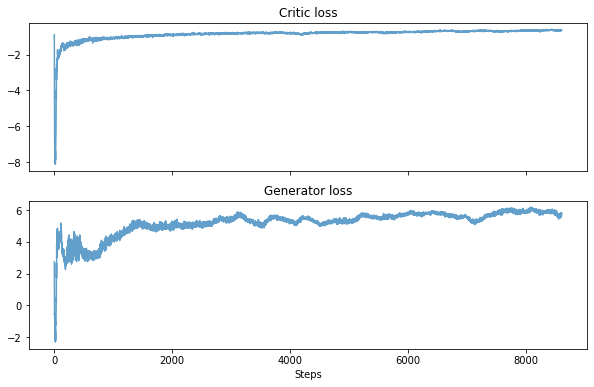

Step 8700: g_loss 5.9739 critic_loss -0.6606 critic fake -2.3796  critic_real 1.7138 penalty 0.0052


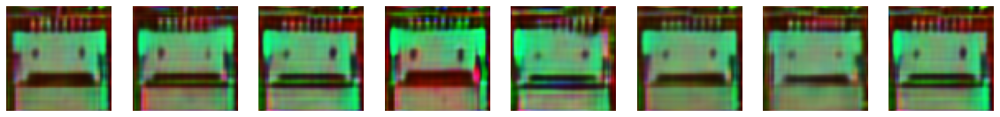

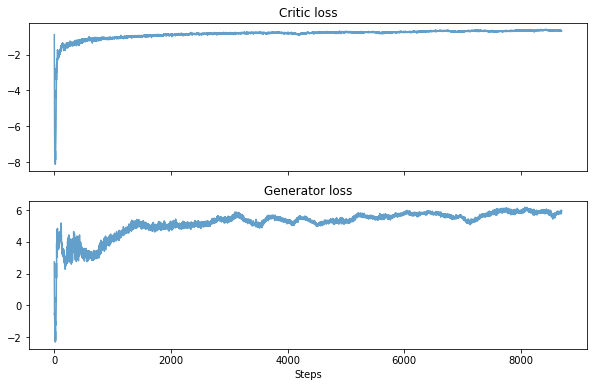

Step 8800: g_loss 5.9135 critic_loss -0.6854 critic fake -2.3247  critic_real 1.6374 penalty 0.0019


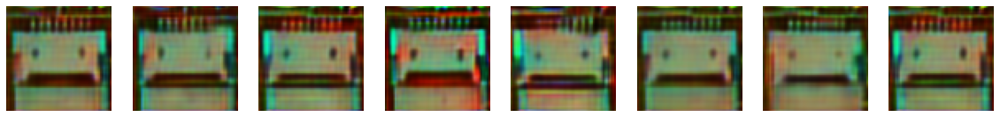

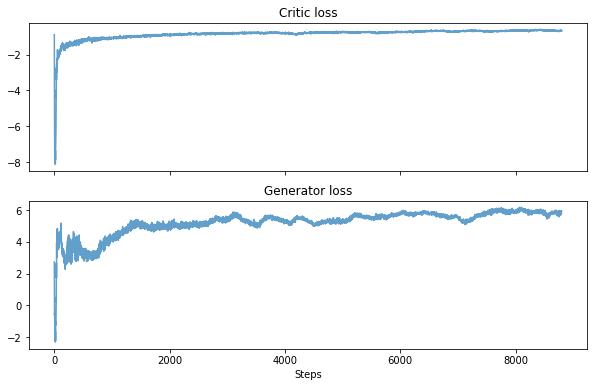

Step 8900: g_loss 5.7498 critic_loss -0.6680 critic fake -2.1609  critic_real 1.4861 penalty 0.0068


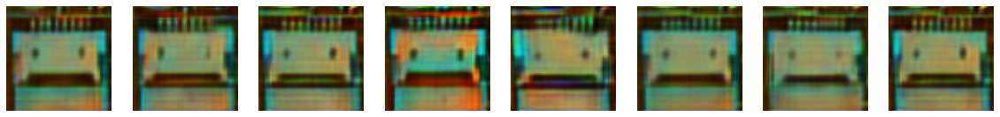

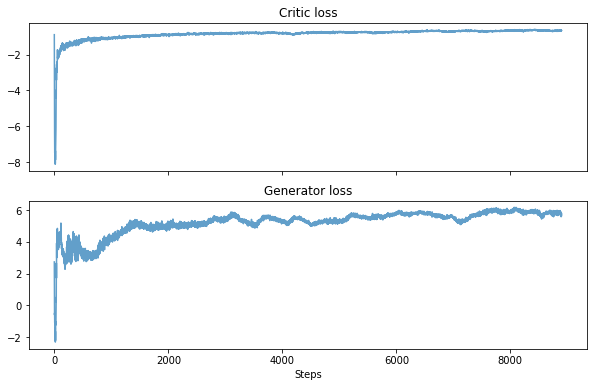

Step 9000: g_loss 5.4888 critic_loss -0.6226 critic fake -1.8587  critic_real 1.2281 penalty 0.0080


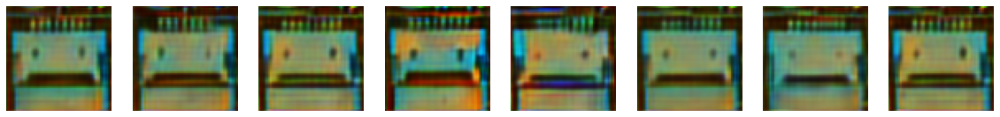

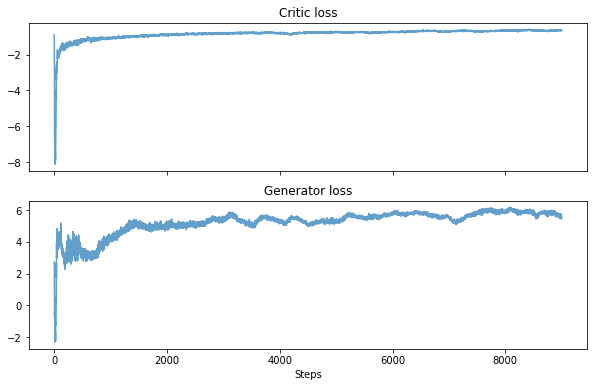

Step 9100: g_loss 5.4212 critic_loss -0.6356 critic fake -1.8116  critic_real 1.1602 penalty 0.0157


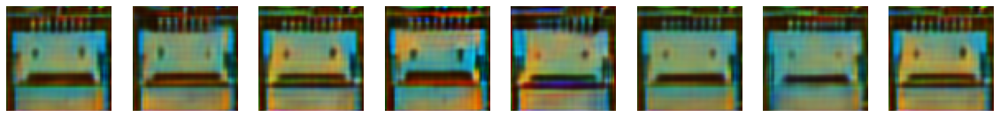

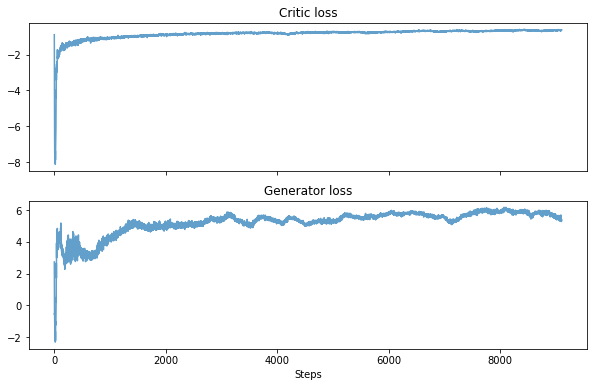

Step 9200: g_loss 5.3906 critic_loss -0.6250 critic fake -1.7393  critic_real 1.1041 penalty 0.0101


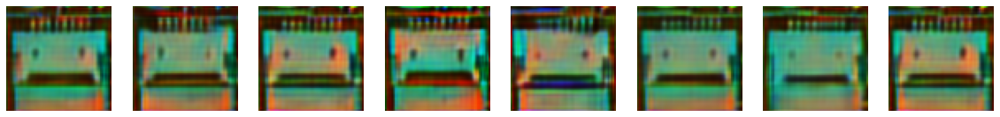

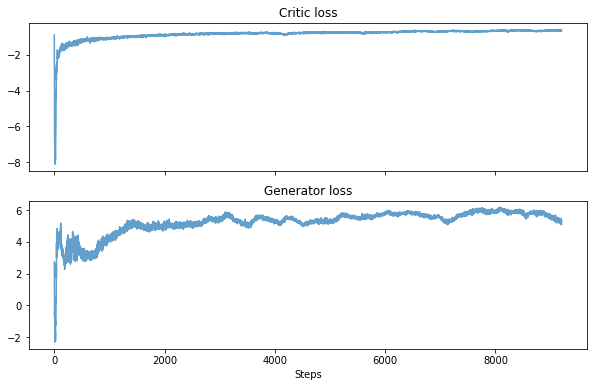

Step 9300: g_loss 5.3270 critic_loss -0.6401 critic fake -1.7006  critic_real 1.0564 penalty 0.0041


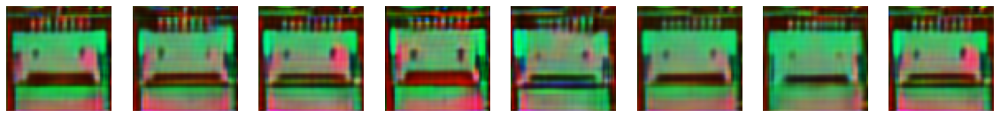

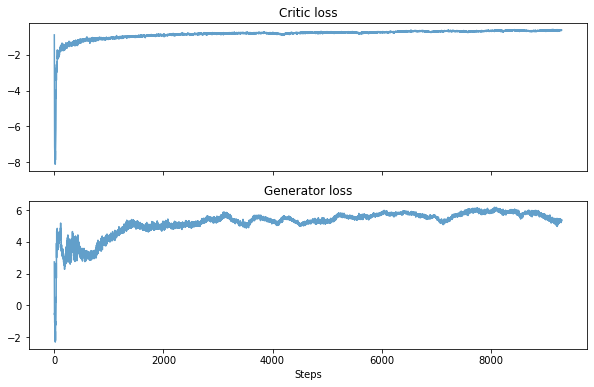

Step 9400: g_loss 5.5338 critic_loss -0.6805 critic fake -1.9320  critic_real 1.2437 penalty 0.0079


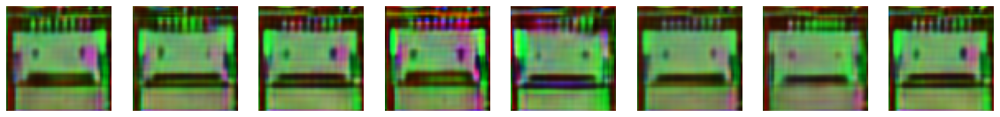

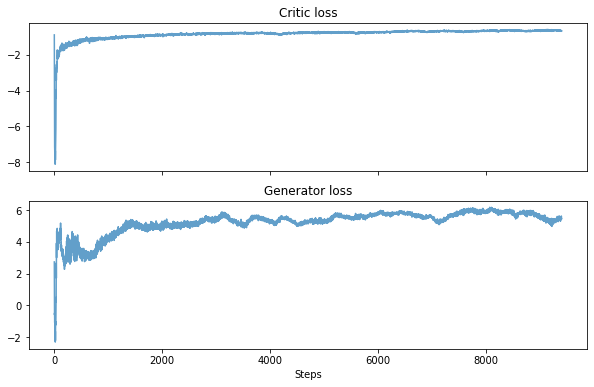

Step 9500: g_loss 5.8553 critic_loss -0.6547 critic fake -2.2446  critic_real 1.5717 penalty 0.0181


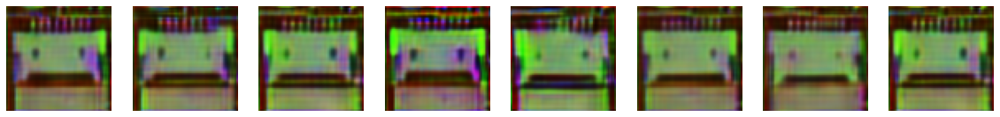

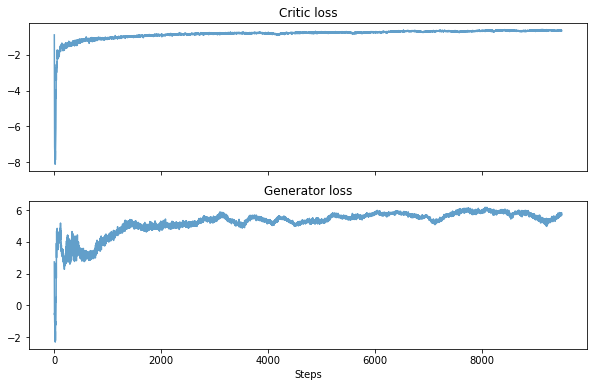

Step 9600: g_loss 5.4763 critic_loss -0.6461 critic fake -1.8052  critic_real 1.1489 penalty 0.0101


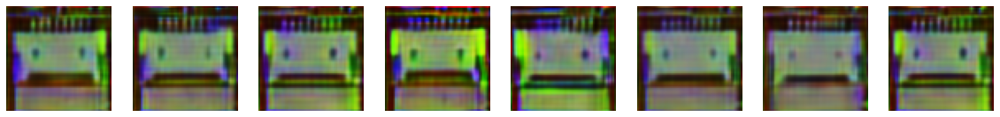

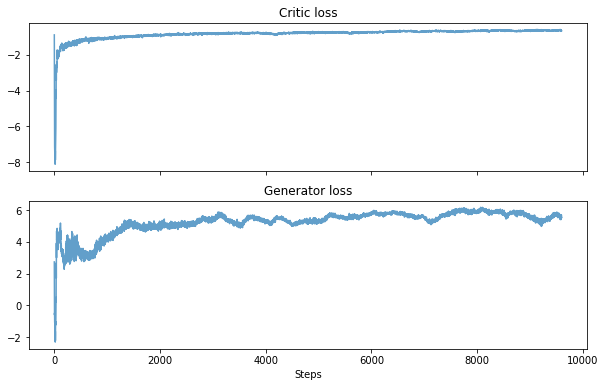

Step 9700: g_loss 5.4976 critic_loss -0.6124 critic fake -1.8185  critic_real 1.1879 penalty 0.0182


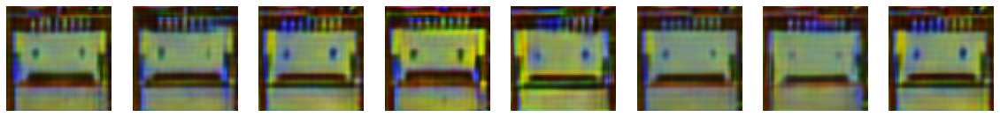

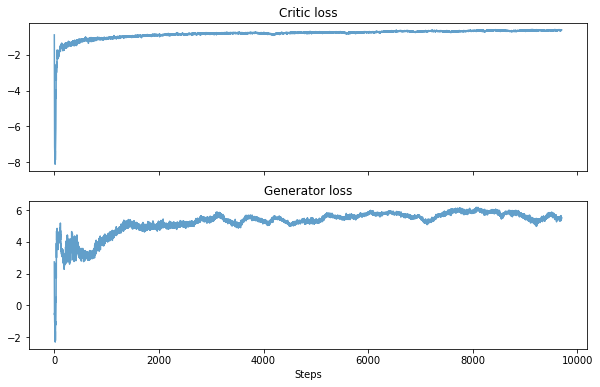

Step 9800: g_loss 5.4580 critic_loss -0.6435 critic fake -1.8253  critic_real 1.1806 penalty 0.0012


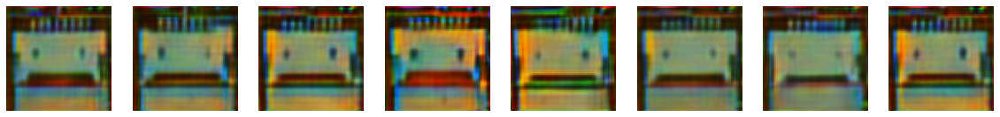

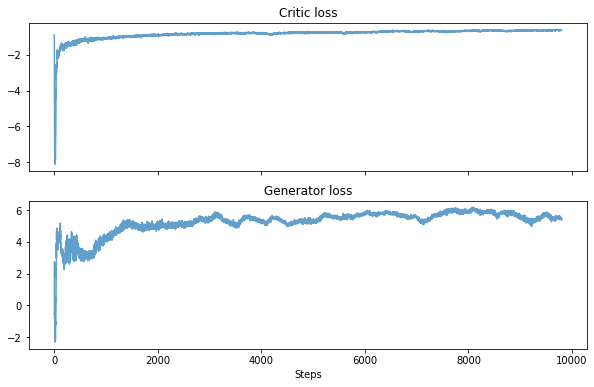

Step 9900: g_loss 5.4695 critic_loss -0.6605 critic fake -1.7704  critic_real 1.1094 penalty 0.0005


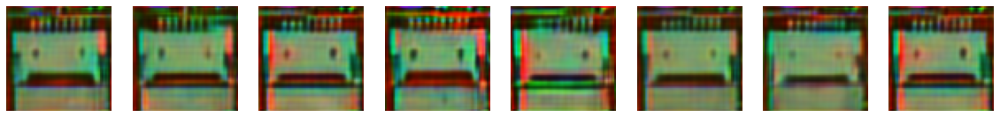

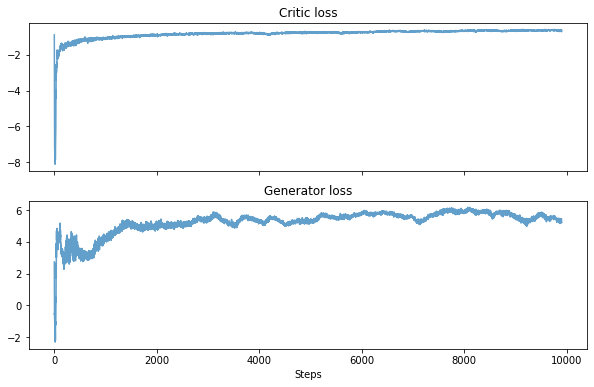

Step 10000: g_loss 5.6504 critic_loss -0.6409 critic fake -1.9959  critic_real 1.3547 penalty 0.0003


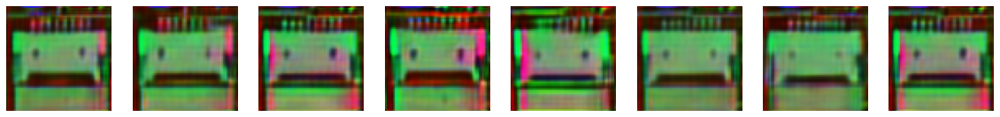

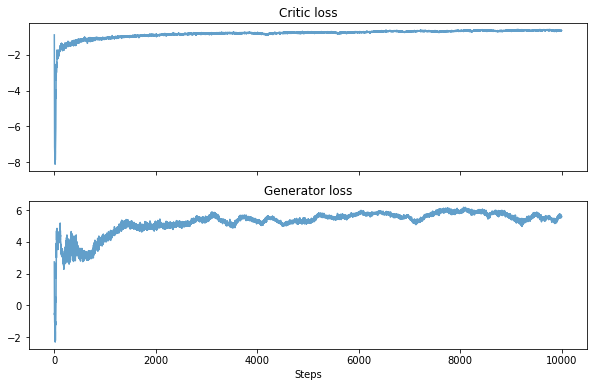

Step 10100: g_loss 5.9289 critic_loss -0.6522 critic fake -2.2592  critic_real 1.6069 penalty 0.0000


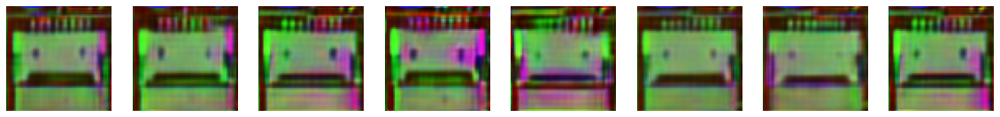

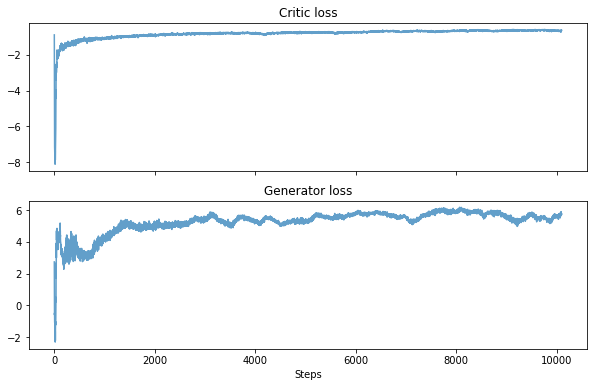

Step 10200: g_loss 6.0620 critic_loss -0.6394 critic fake -2.3364  critic_real 1.6938 penalty 0.0031


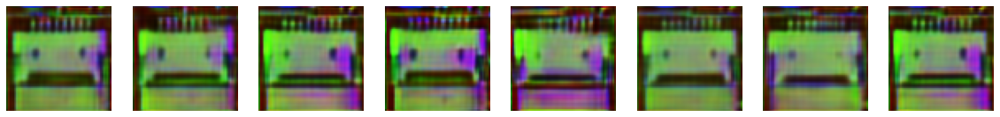

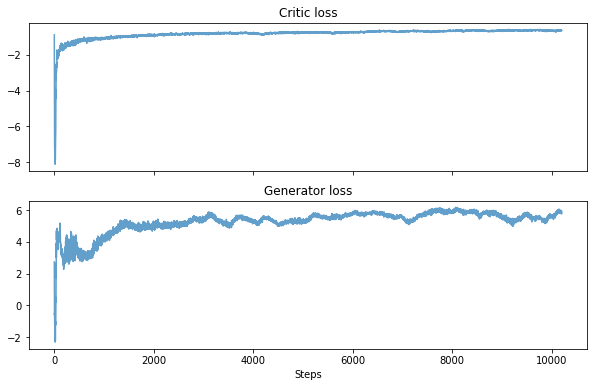

Step 10300: g_loss 6.0557 critic_loss -0.6215 critic fake -2.3389  critic_real 1.7168 penalty 0.0006


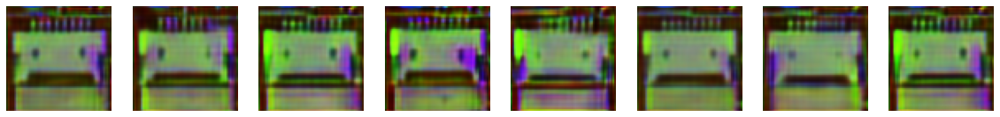

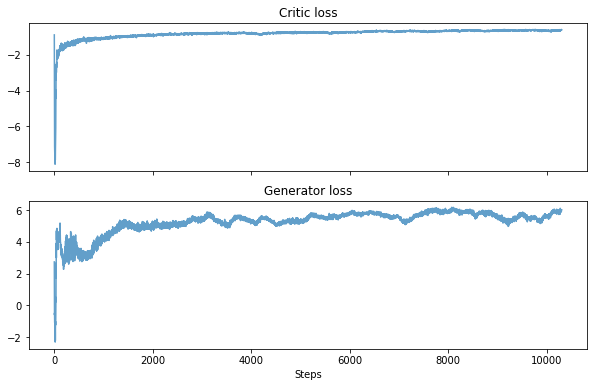

Step 10400: g_loss 5.7264 critic_loss -0.6279 critic fake -2.0260  critic_real 1.3519 penalty 0.0461


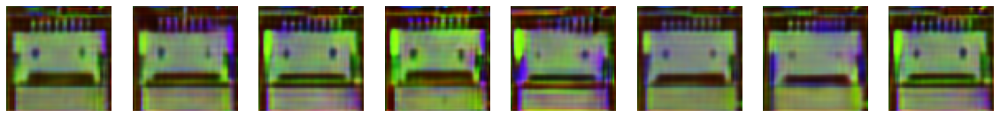

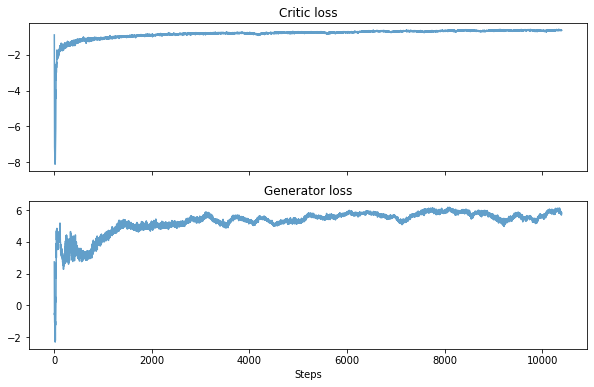

Step 10500: g_loss 5.8373 critic_loss -0.6085 critic fake -2.1024  critic_real 1.4924 penalty 0.0015


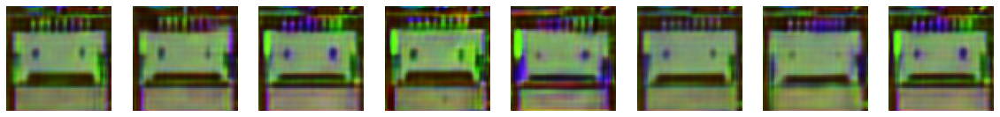

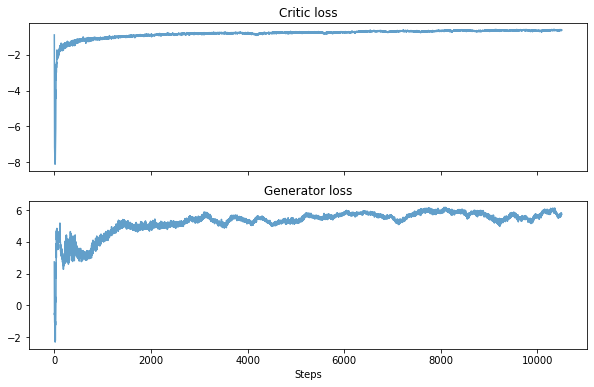

Step 10600: g_loss 5.9142 critic_loss -0.5936 critic fake -2.1848  critic_real 1.5906 penalty 0.0006


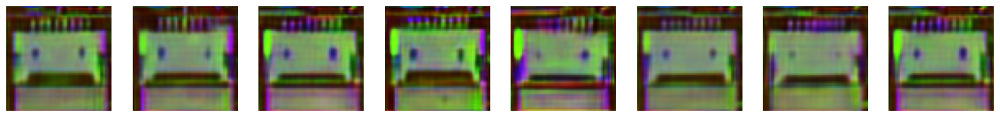

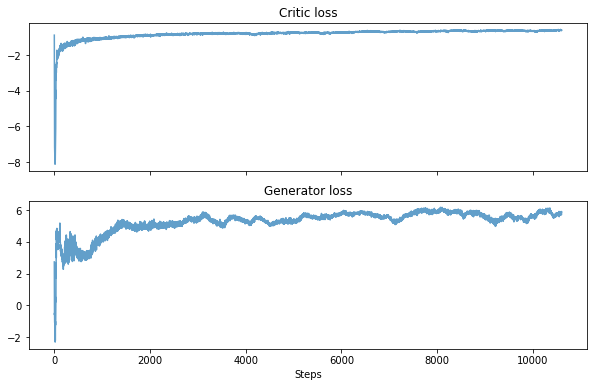

Step 10700: g_loss 5.8918 critic_loss -0.6062 critic fake -2.1857  critic_real 1.5792 penalty 0.0003


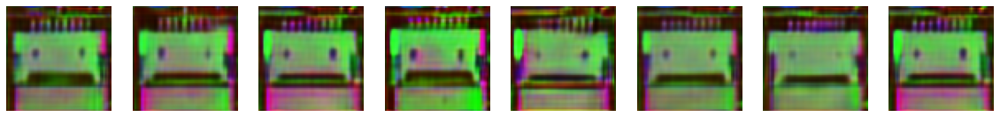

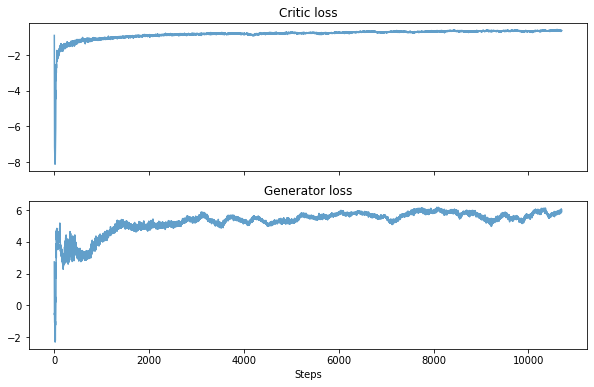

Step 10800: g_loss 6.2528 critic_loss -0.6410 critic fake -2.4777  critic_real 1.8345 penalty 0.0023


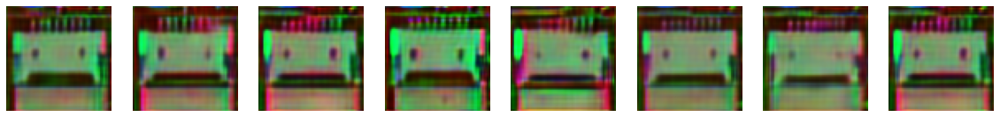

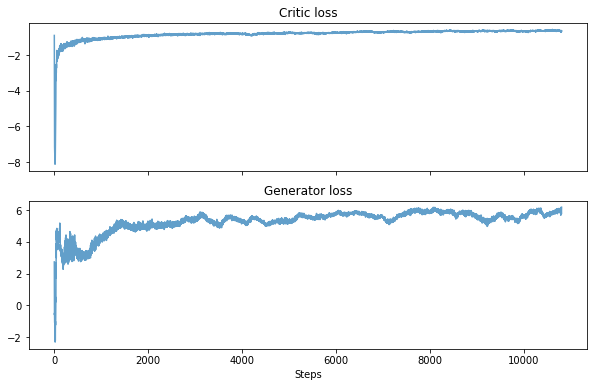

Step 10900: g_loss 6.0434 critic_loss -0.6209 critic fake -2.2972  critic_real 1.6687 penalty 0.0076


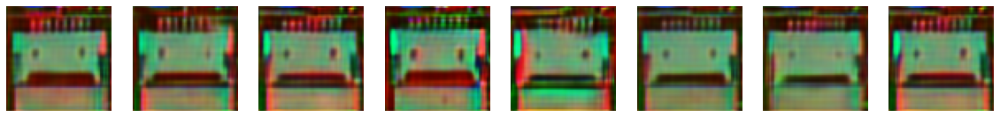

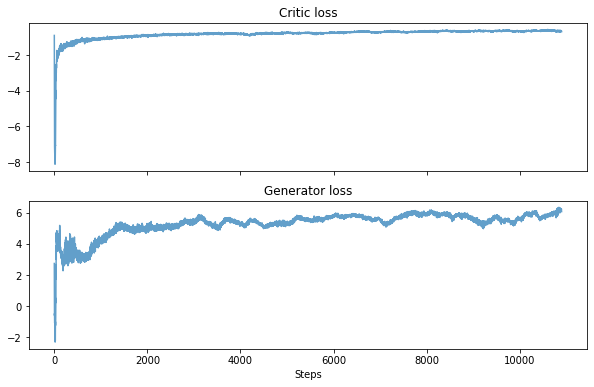

Step 11000: g_loss 6.0432 critic_loss -0.6287 critic fake -2.3092  critic_real 1.6451 penalty 0.0354


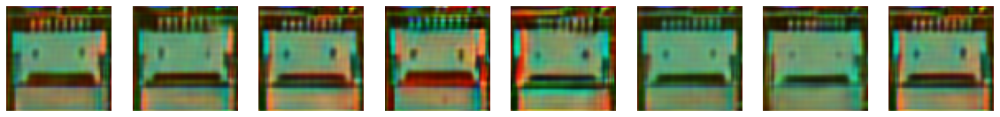

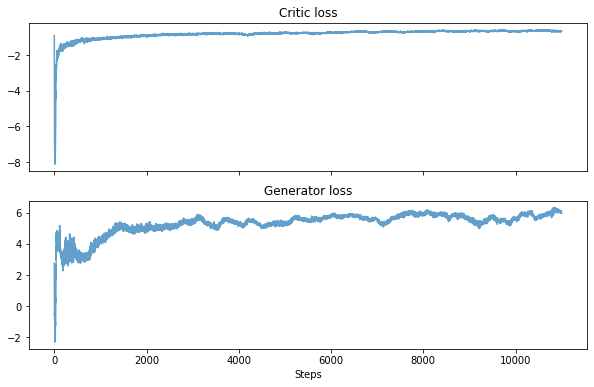

Step 11100: g_loss 5.9451 critic_loss -0.6204 critic fake -2.1848  critic_real 1.5467 penalty 0.0177


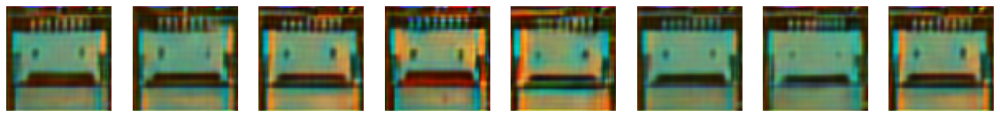

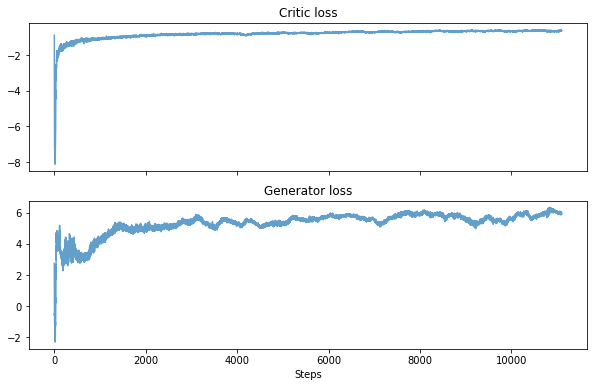

Step 11200: g_loss 5.9514 critic_loss -0.6099 critic fake -2.2220  critic_real 1.6113 penalty 0.0008


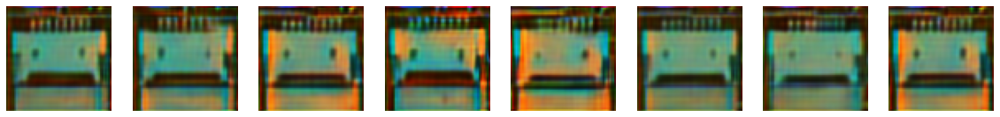

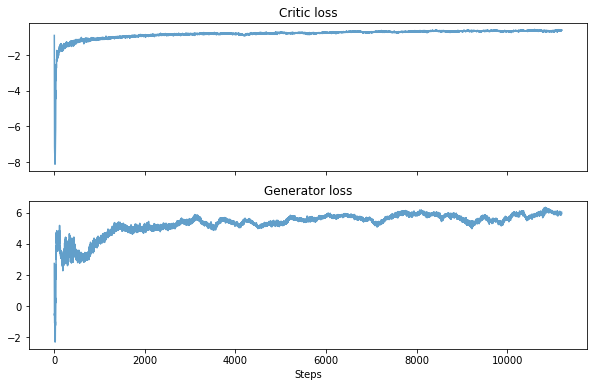

Step 11300: g_loss 5.7281 critic_loss -0.5972 critic fake -1.9859  critic_real 1.3872 penalty 0.0016


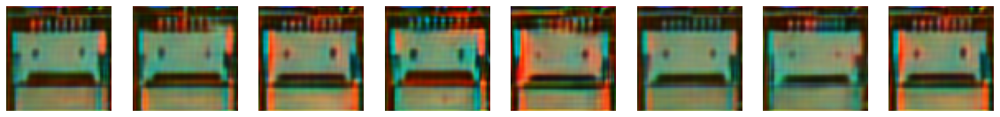

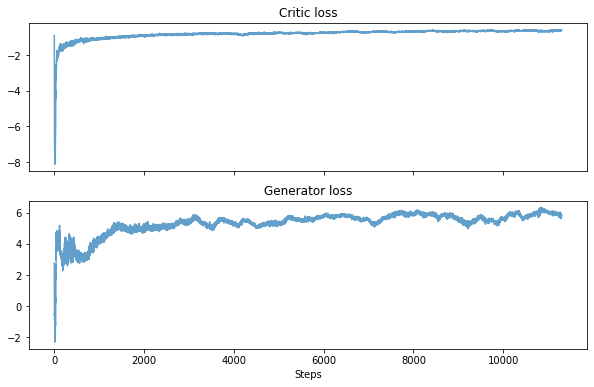

Step 11400: g_loss 5.6809 critic_loss -0.6011 critic fake -1.9054  critic_real 1.2929 penalty 0.0114


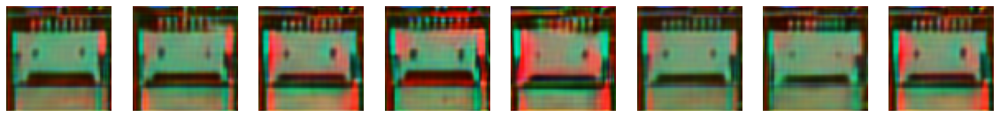

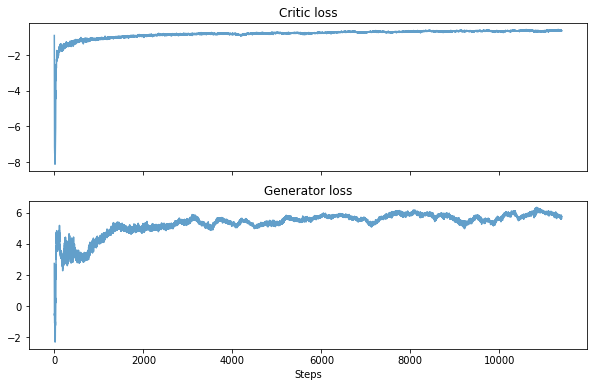

Step 11500: g_loss 5.4799 critic_loss -0.5854 critic fake -1.6589  critic_real 1.0601 penalty 0.0134


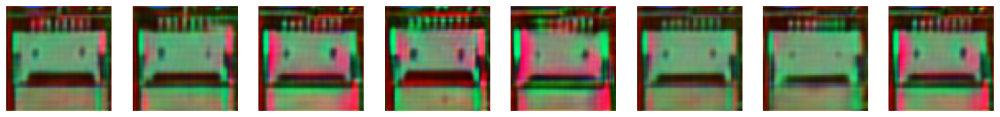

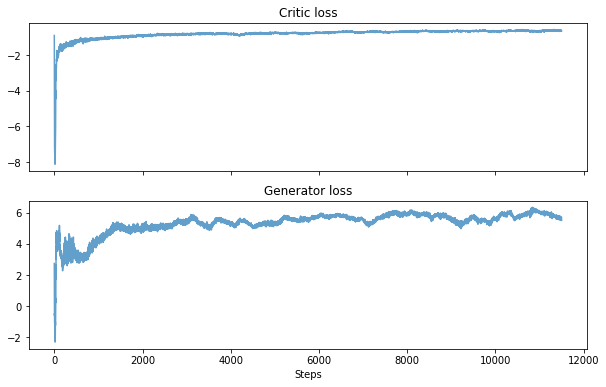

Step 11600: g_loss 5.4582 critic_loss -0.6605 critic fake -1.6875  critic_real 1.0264 penalty 0.0006


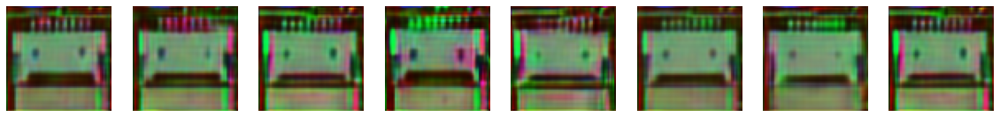

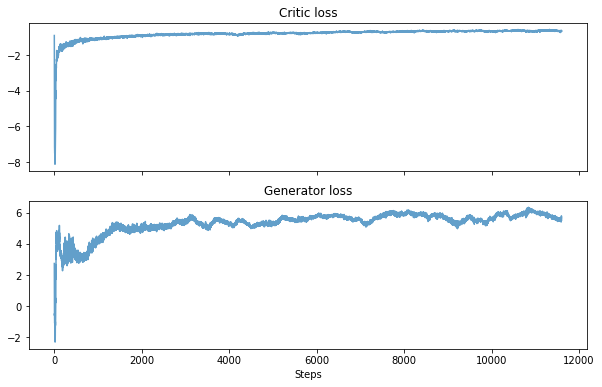

Step 11700: g_loss 5.2732 critic_loss -0.6553 critic fake -1.5266  critic_real 0.8582 penalty 0.0132


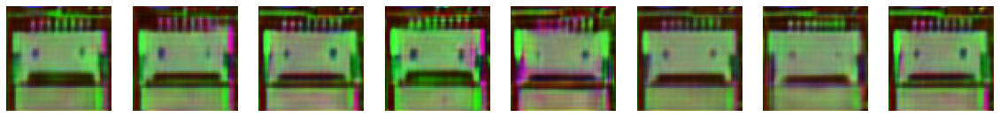

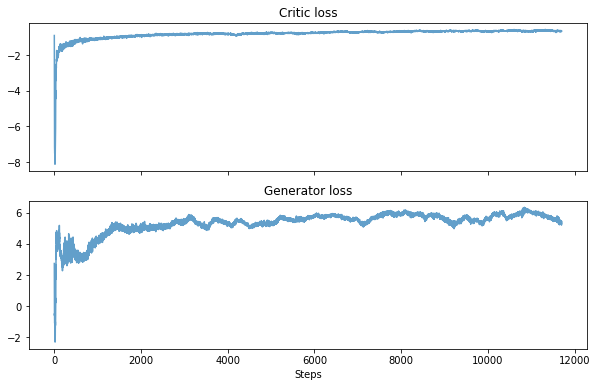

Step 11800: g_loss 5.2140 critic_loss -0.6116 critic fake -1.4156  critic_real 0.7851 penalty 0.0190


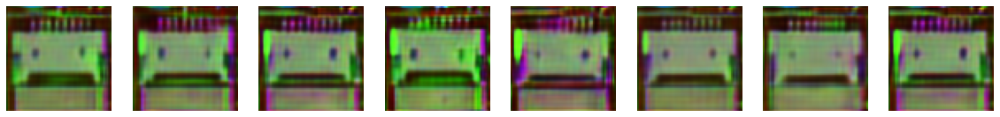

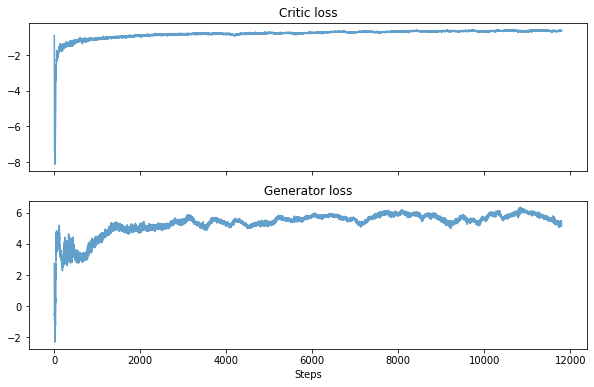

Step 11900: g_loss 5.2430 critic_loss -0.5893 critic fake -1.4465  critic_real 0.8551 penalty 0.0021


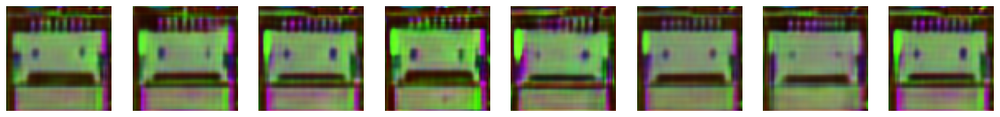

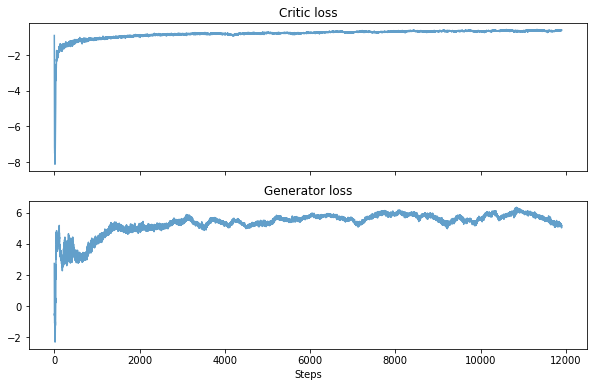

Step 12000: g_loss 5.1550 critic_loss -0.5943 critic fake -1.3716  critic_real 0.7769 penalty 0.0005


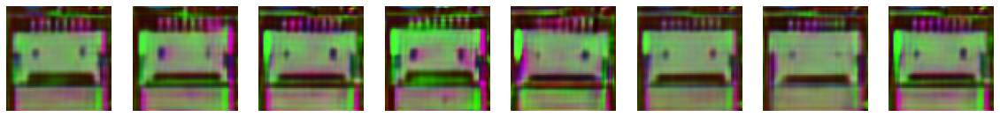

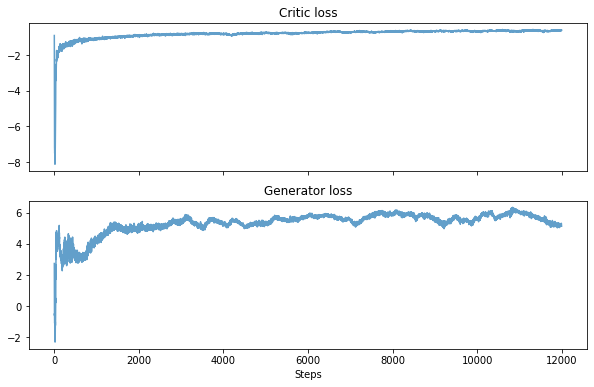

Step 12100: g_loss 5.4780 critic_loss -0.5883 critic fake -1.6374  critic_real 1.0380 penalty 0.0111


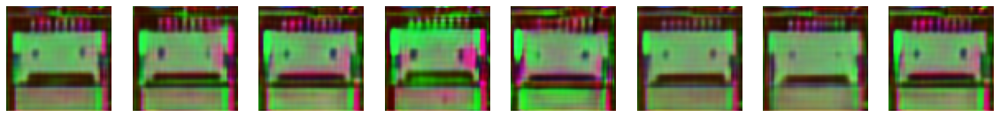

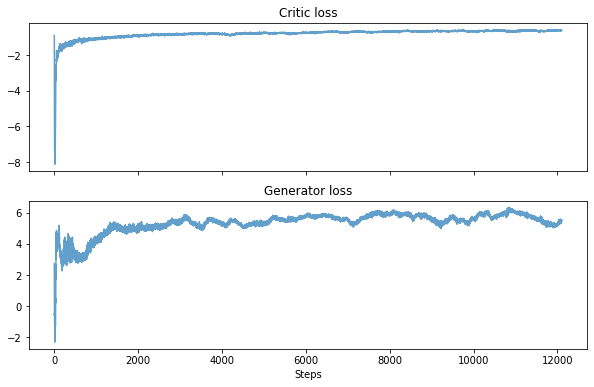

Step 12200: g_loss 5.5310 critic_loss -0.5996 critic fake -1.6546  critic_real 1.0472 penalty 0.0078


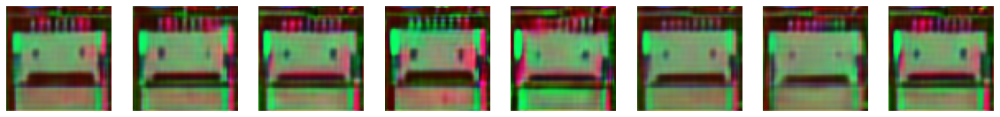

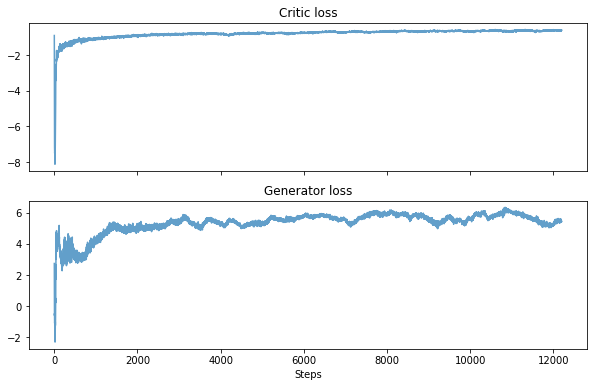

Step 12300: g_loss 5.5484 critic_loss -0.6656 critic fake -1.7436  critic_real 1.0368 penalty 0.0412


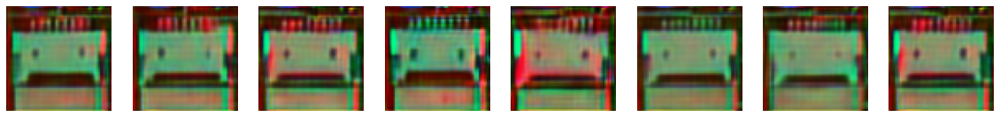

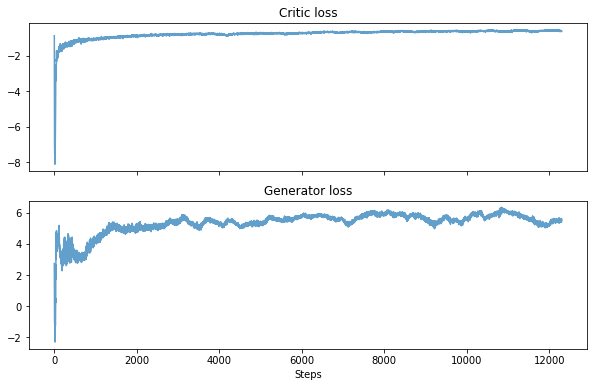

Step 12400: g_loss 5.4542 critic_loss -0.6162 critic fake -1.6335  critic_real 1.0155 penalty 0.0018


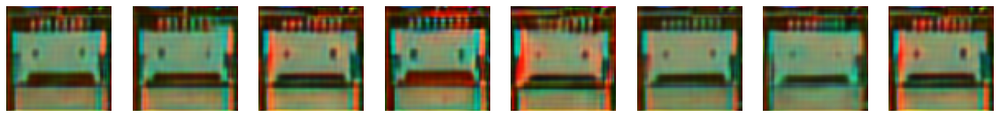

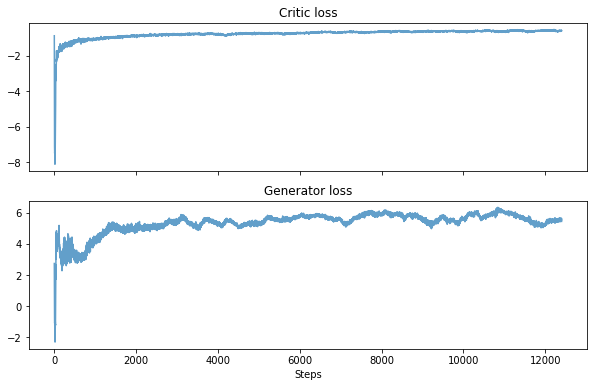

Step 12500: g_loss 5.5249 critic_loss -0.5877 critic fake -1.6504  critic_real 1.0613 penalty 0.0015


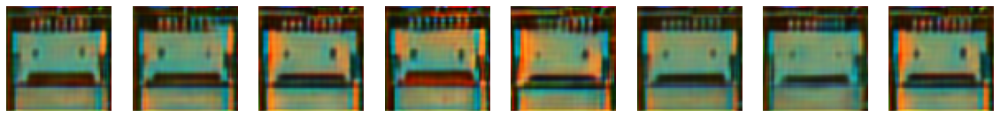

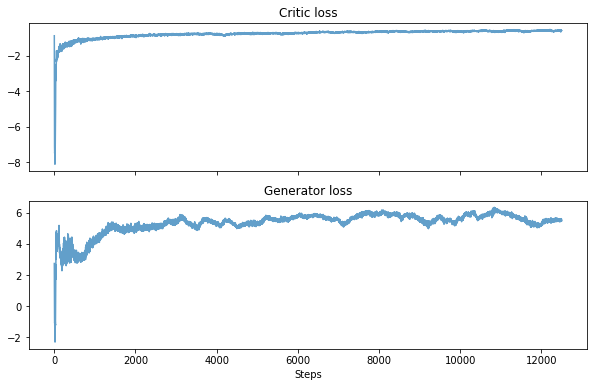

Step 12600: g_loss 5.6685 critic_loss -0.5960 critic fake -1.8188  critic_real 1.2228 penalty 0.0001


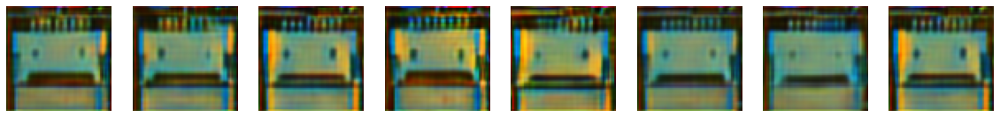

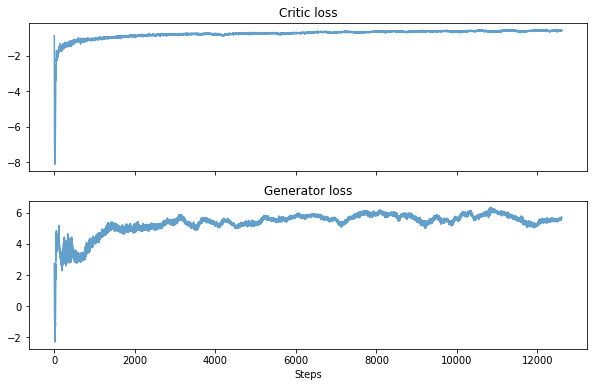

Step 12700: g_loss 5.6865 critic_loss -0.5837 critic fake -1.8790  critic_real 1.2831 penalty 0.0122


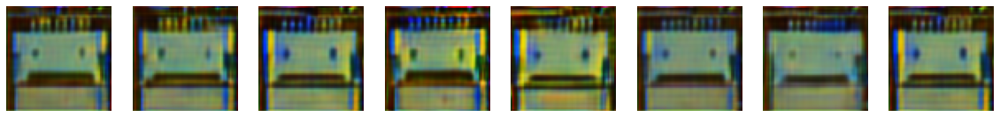

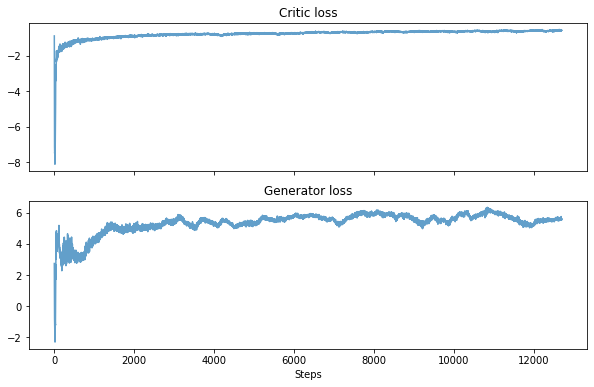

Step 12800: g_loss 5.4206 critic_loss -0.5626 critic fake -1.5647  critic_real 1.0009 penalty 0.0013


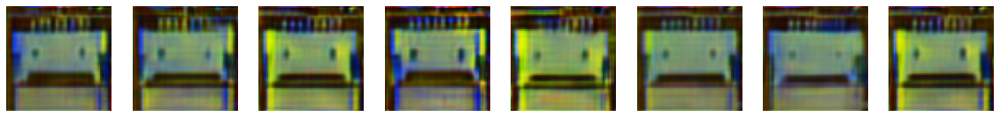

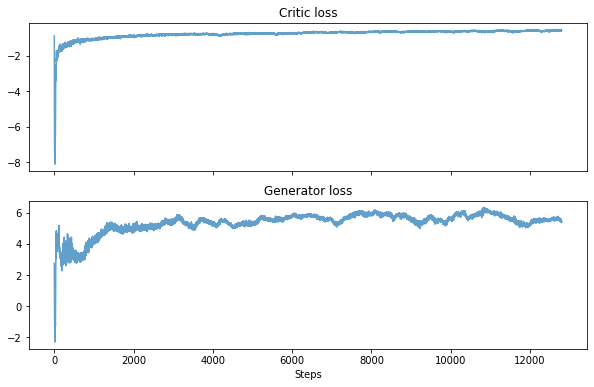

Step 12900: g_loss 5.4822 critic_loss -0.5507 critic fake -1.6091  critic_real 1.0453 penalty 0.0131


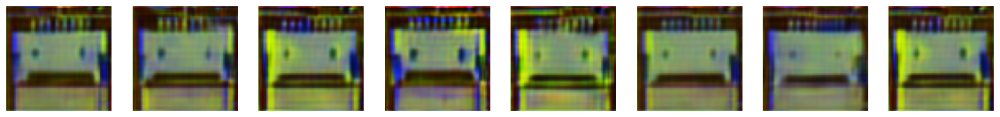

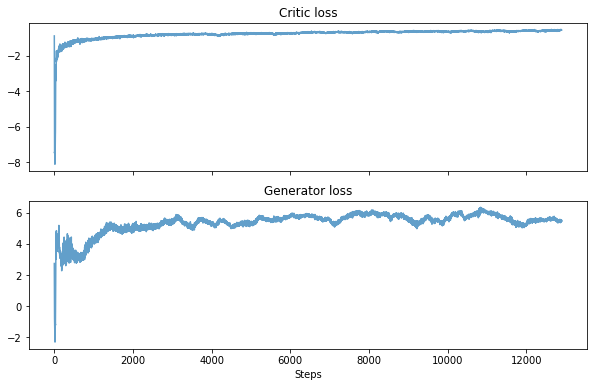

Step 13000: g_loss 5.4593 critic_loss -0.5682 critic fake -1.5582  critic_real 0.9874 penalty 0.0026


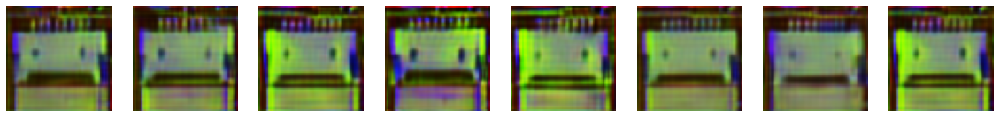

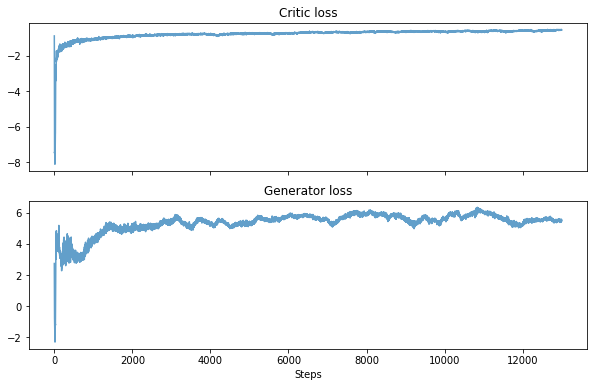

Step 13100: g_loss 5.6062 critic_loss -0.5602 critic fake -1.7021  critic_real 1.1418 penalty 0.0000


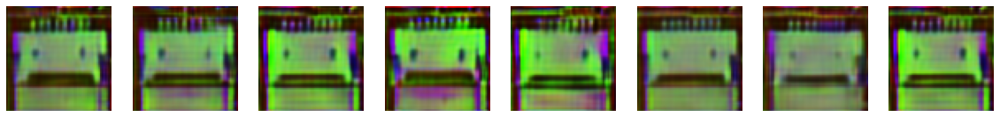

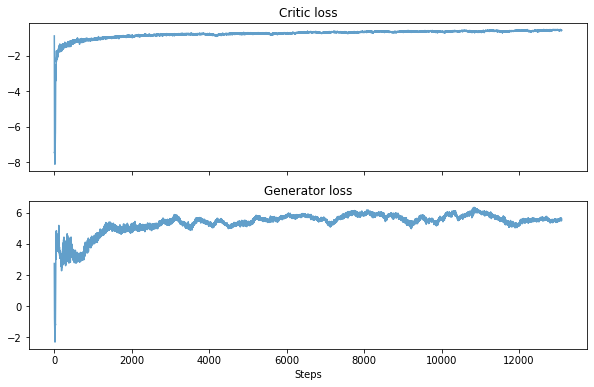

Step 13200: g_loss 5.5823 critic_loss -0.5915 critic fake -1.6972  critic_real 1.1027 penalty 0.0030


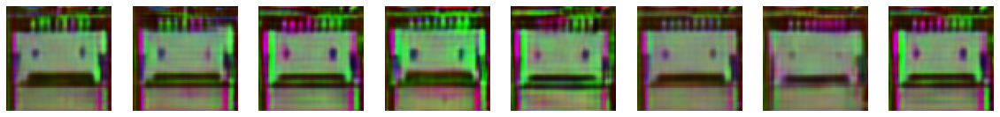

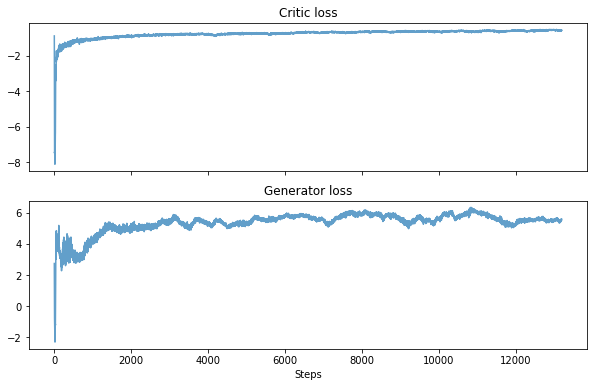

Step 13300: g_loss 5.4351 critic_loss -0.6323 critic fake -1.5863  critic_real 0.9529 penalty 0.0011


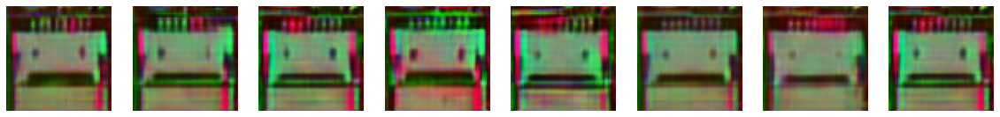

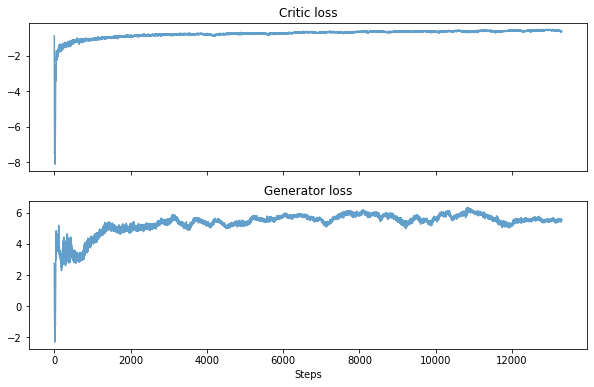

Step 13400: g_loss 5.7006 critic_loss -0.5980 critic fake -1.8263  critic_real 1.1969 penalty 0.0314


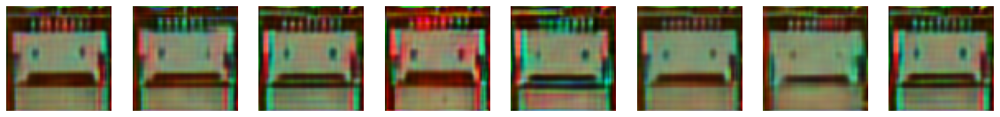

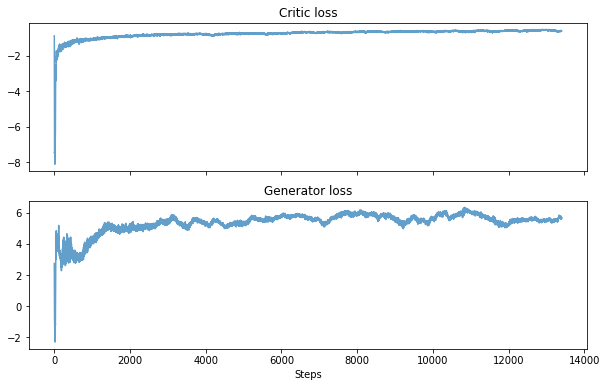

Step 13500: g_loss 5.6003 critic_loss -0.6030 critic fake -1.6769  critic_real 1.0577 penalty 0.0162


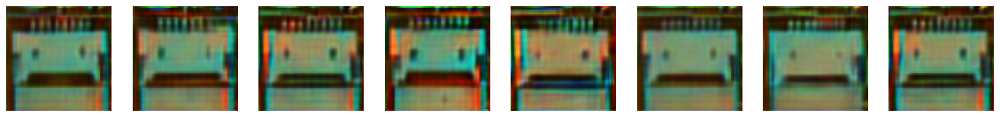

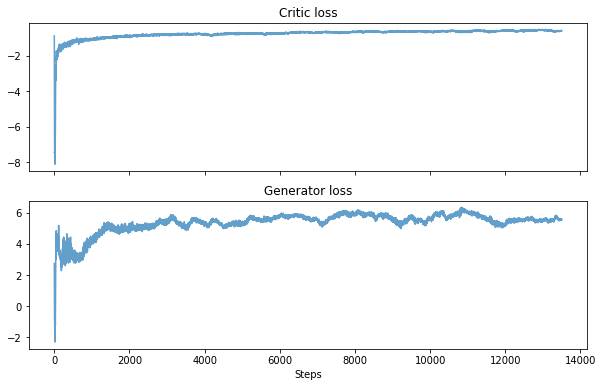

Step 13600: g_loss 5.5140 critic_loss -0.5506 critic fake -1.5886  critic_real 1.0285 penalty 0.0095


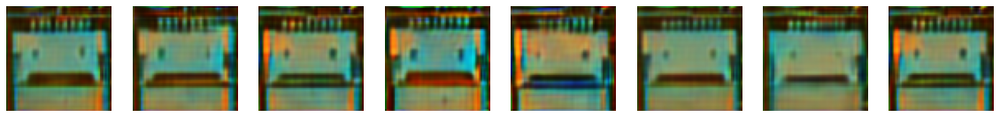

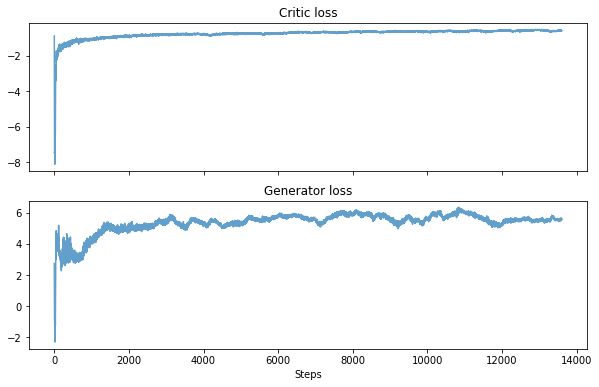

Step 13700: g_loss 5.4624 critic_loss -0.5614 critic fake -1.5514  critic_real 0.9899 penalty 0.0002


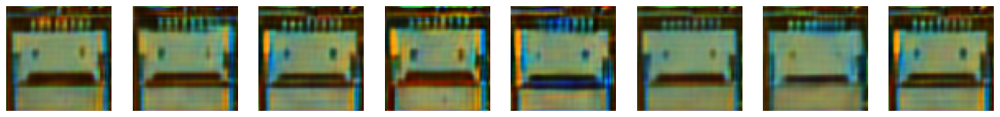

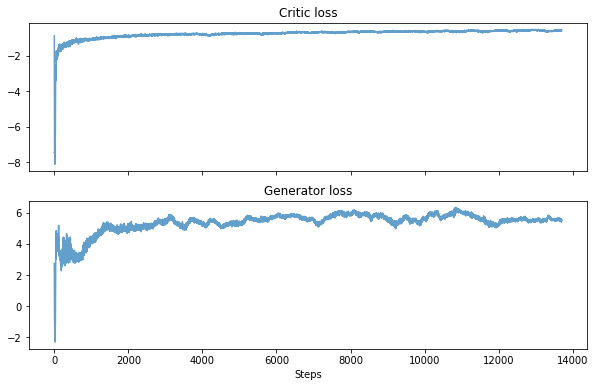

Step 13800: g_loss 5.4153 critic_loss -0.5602 critic fake -1.5313  critic_real 0.9709 penalty 0.0002


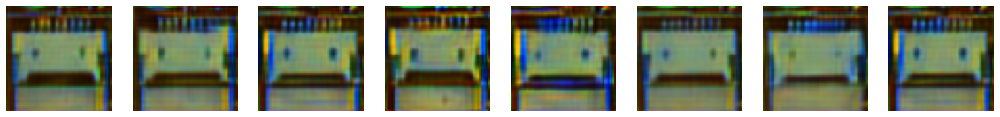

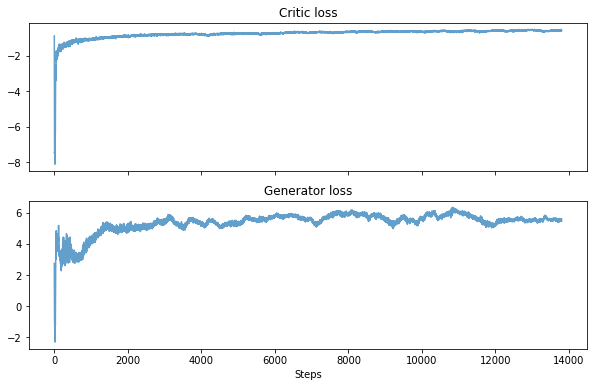

Step 13900: g_loss 5.6318 critic_loss -0.5576 critic fake -1.7380  critic_real 1.1790 penalty 0.0013


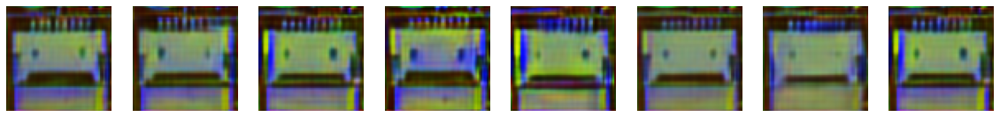

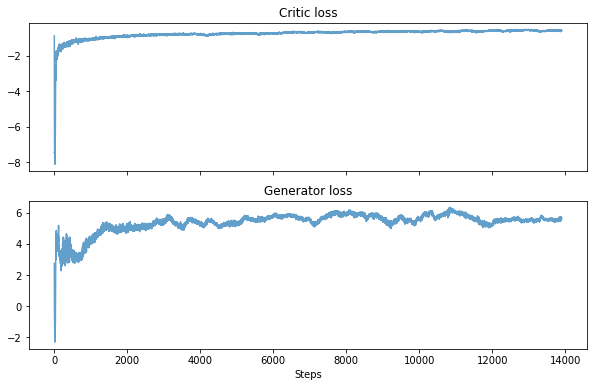

Step 14000: g_loss 5.5098 critic_loss -0.5559 critic fake -1.6230  critic_real 1.0669 penalty 0.0002


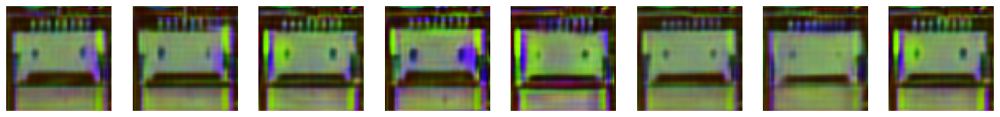

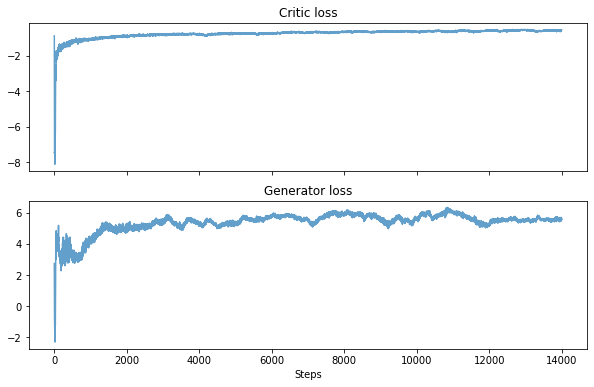

Step 14100: g_loss 5.5374 critic_loss -0.6018 critic fake -1.6171  critic_real 1.0043 penalty 0.0109


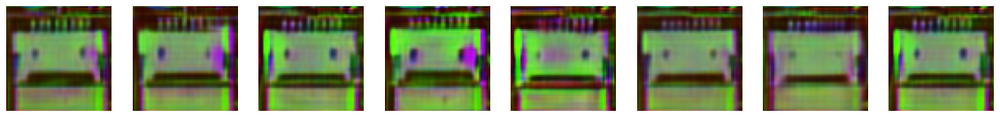

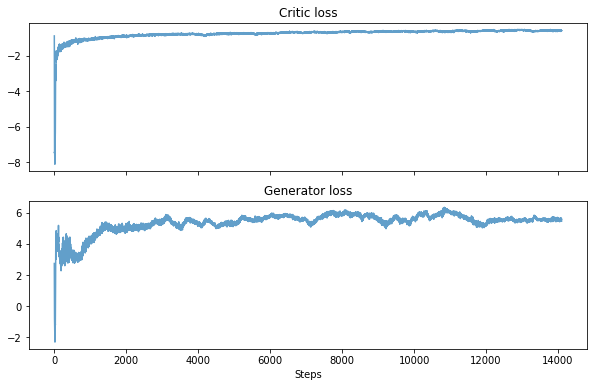

Step 14200: g_loss 5.4682 critic_loss -0.6118 critic fake -1.5506  critic_real 0.9361 penalty 0.0027


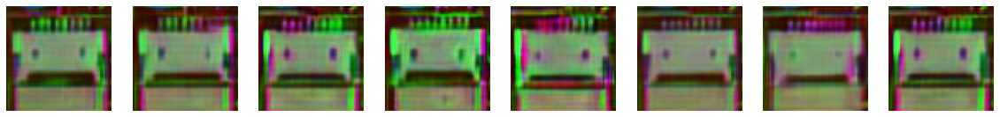

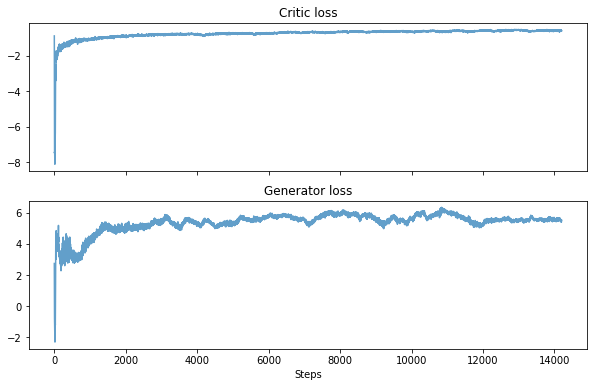

Step 14300: g_loss 5.4283 critic_loss -0.5841 critic fake -1.4814  critic_real 0.8952 penalty 0.0021


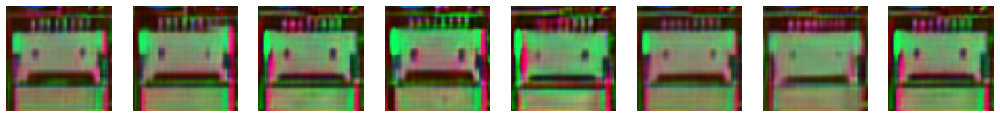

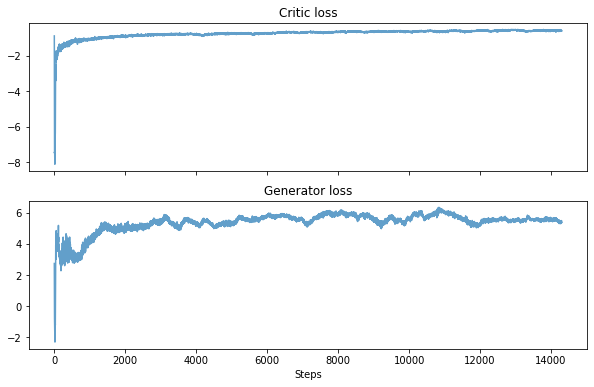

Step 14400: g_loss 5.4746 critic_loss -0.6044 critic fake -1.5386  critic_real 0.9334 penalty 0.0008


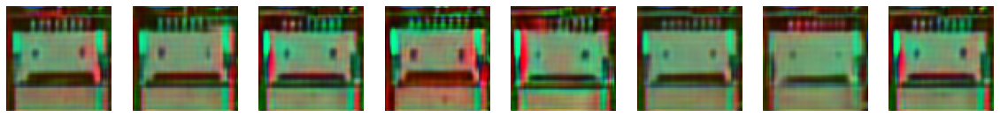

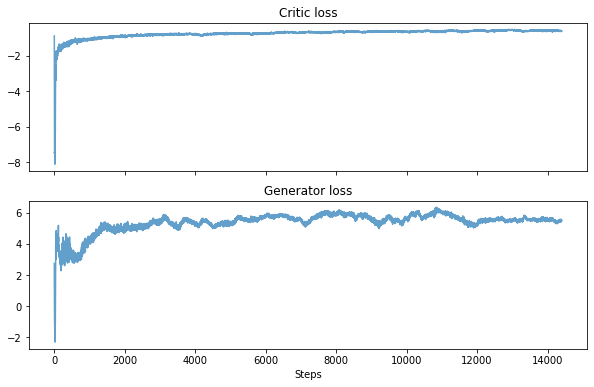

Step 14500: g_loss 5.2726 critic_loss -0.5783 critic fake -1.3333  critic_real 0.7122 penalty 0.0428


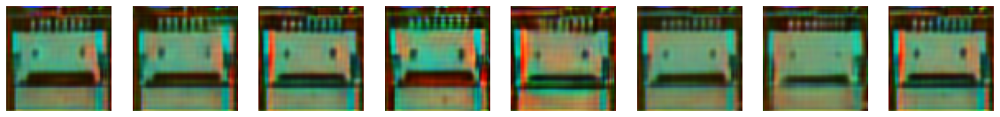

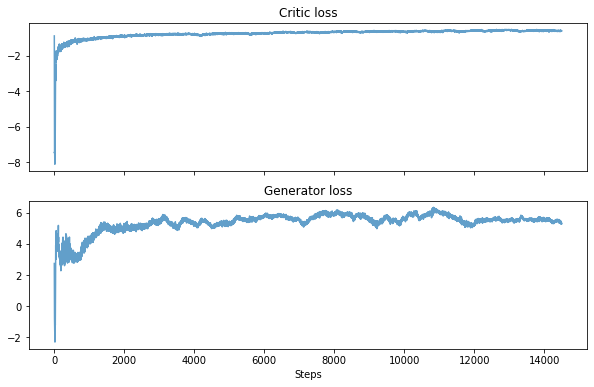

Step 14600: g_loss 5.2365 critic_loss -0.5407 critic fake -1.2800  critic_real 0.7392 penalty 0.0001


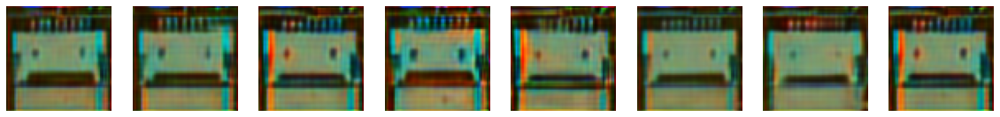

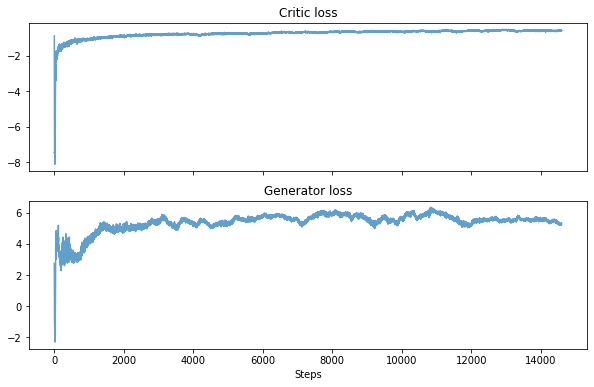

Step 14700: g_loss 5.1989 critic_loss -0.5521 critic fake -1.2448  critic_real 0.6883 penalty 0.0044


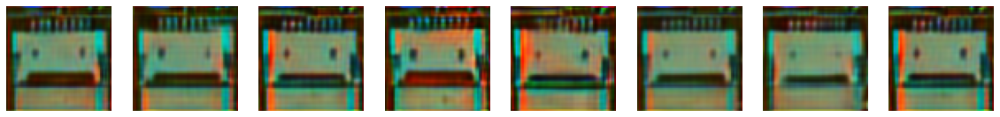

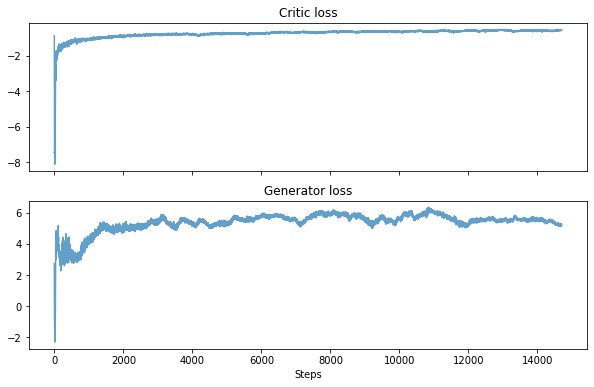

Step 14800: g_loss 5.2998 critic_loss -0.6084 critic fake -1.3301  critic_real 0.7166 penalty 0.0051


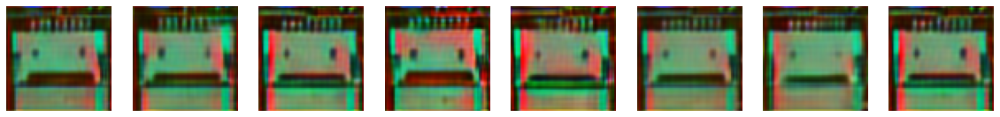

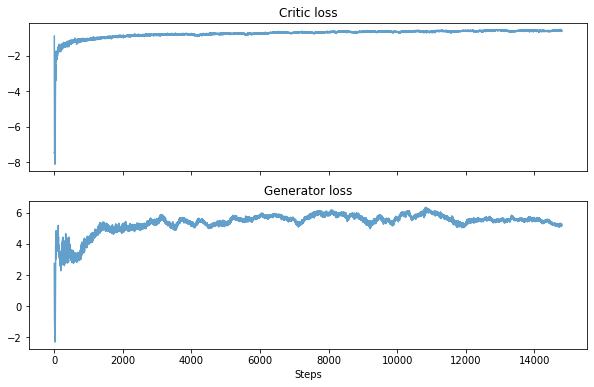

Step 14900: g_loss 5.1259 critic_loss -0.6294 critic fake -1.2445  critic_real 0.6130 penalty 0.0020


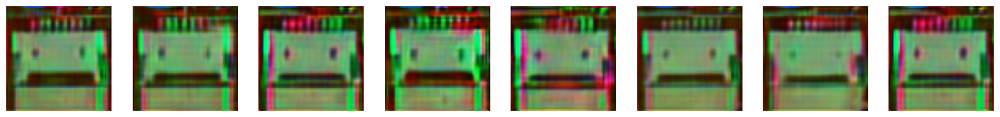

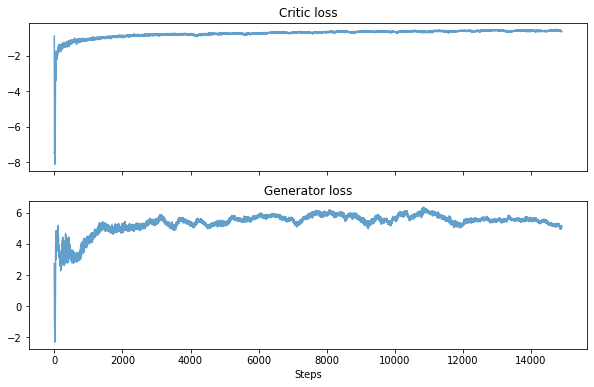

Step 15000: g_loss 5.0137 critic_loss -0.5605 critic fake -1.0447  critic_real 0.4838 penalty 0.0004


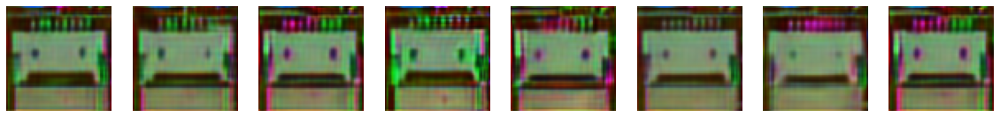

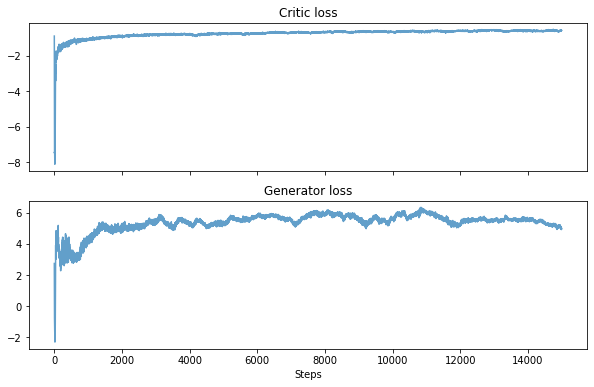

Step 15100: g_loss 4.9475 critic_loss -0.5932 critic fake -0.9691  critic_real 0.3710 penalty 0.0049


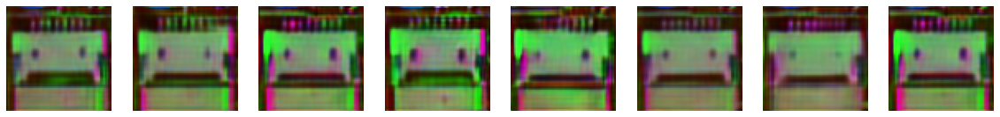

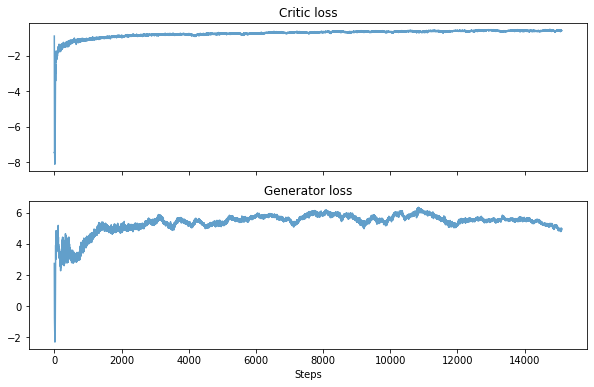

Step 15200: g_loss 5.1773 critic_loss -0.5564 critic fake -1.1552  critic_real 0.5734 penalty 0.0253


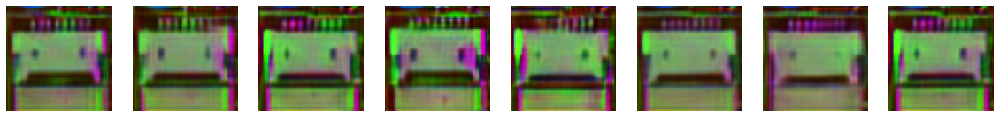

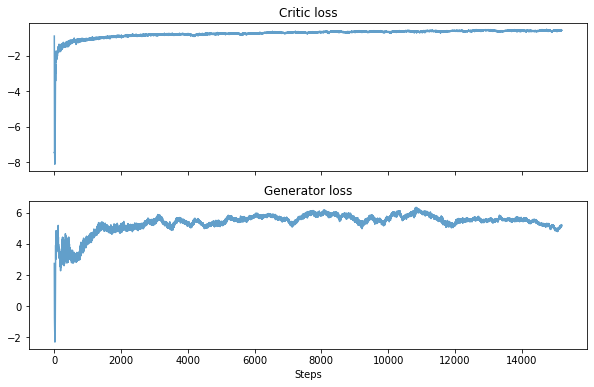

Step 15300: g_loss 5.1493 critic_loss -0.5683 critic fake -1.1112  critic_real 0.5342 penalty 0.0086


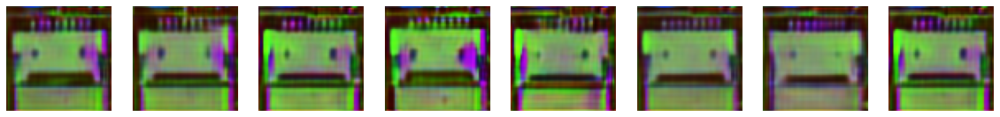

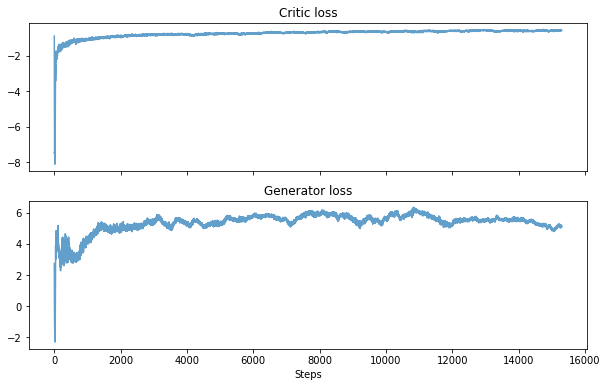

Step 15400: g_loss 5.1210 critic_loss -0.5407 critic fake -1.1086  critic_real 0.5677 penalty 0.0002


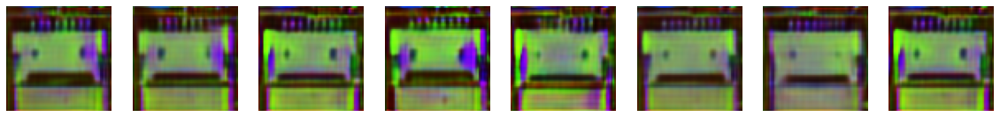

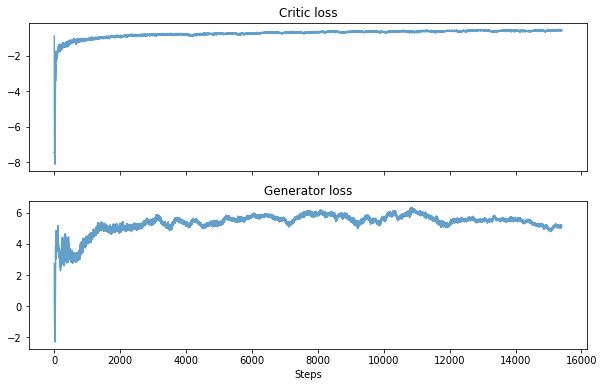

Step 15500: g_loss 5.3448 critic_loss -0.5516 critic fake -1.2902  critic_real 0.7384 penalty 0.0003


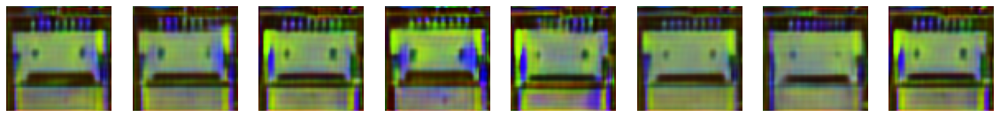

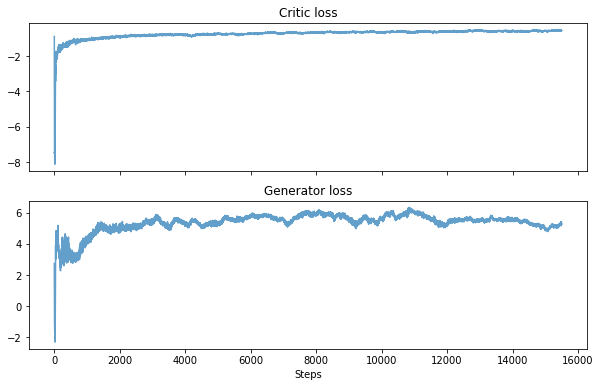

Step 15600: g_loss 5.2500 critic_loss -0.5531 critic fake -1.1972  critic_real 0.6057 penalty 0.0385


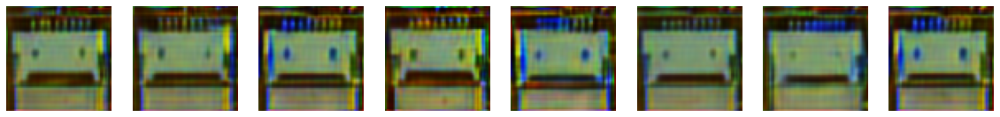

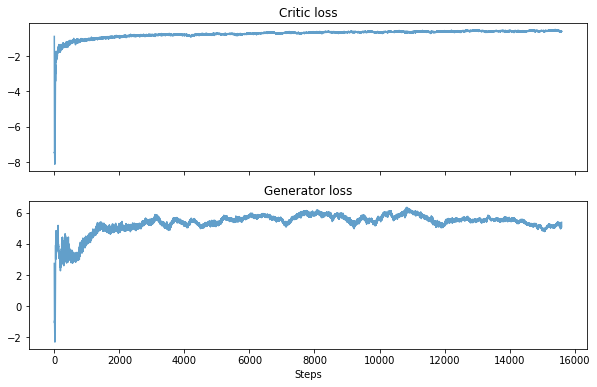

Step 15700: g_loss 5.3003 critic_loss -0.5416 critic fake -1.3075  critic_real 0.7554 penalty 0.0105


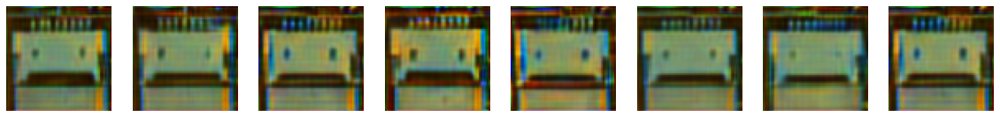

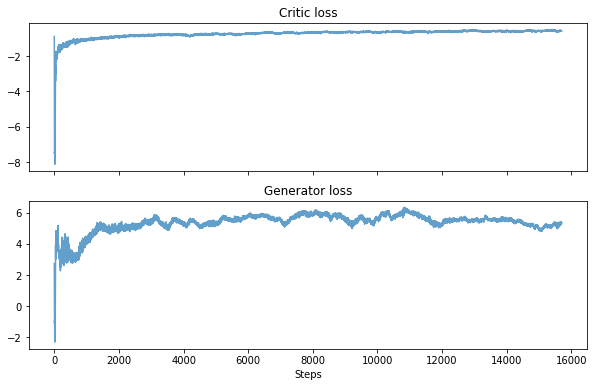

Step 15800: g_loss 5.1511 critic_loss -0.5502 critic fake -1.0473  critic_real 0.4826 penalty 0.0146


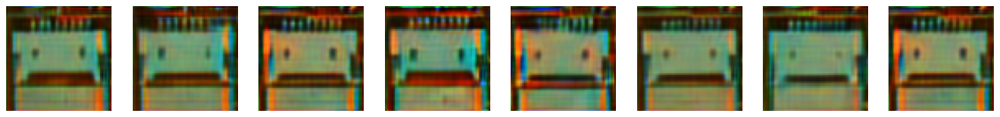

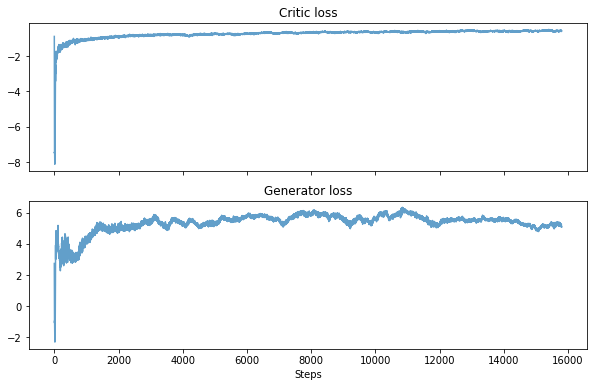

Step 15900: g_loss 5.1052 critic_loss -0.5738 critic fake -1.0930  critic_real 0.5189 penalty 0.0003


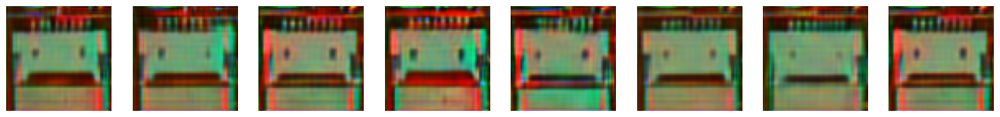

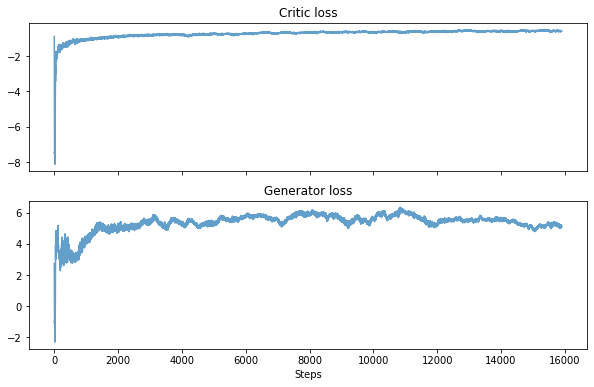

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        [(None, 256)]             0         
                                                                 
 dense_3 (Dense)             (None, 4096)              1052672   
                                                                 
 batch_normalization_3 (Batc  (None, 4096)             16384     
 hNormalization)                                                 
                                                                 
 leaky_re_lu_17 (LeakyReLU)  (None, 4096)              0         
                                                                 
 reshape_1 (Reshape)         (None, 4, 4, 256)         0         
                                                                 
 up_sampling2d_3 (UpSampling  (None, 8, 8, 256)        0         
 2D)                                                       

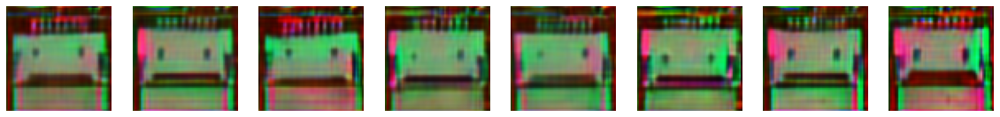

In [ ]:
class WGAN_GP():
    def __init__(self,input_shape):
        self.z_dim= 256
        self.input_shape=input_shape
        
        self.loss_critic= {}      #判別全部
        self.loss_generator = {}    #生成全部 
        
        
        
        #critic
        self.n_critic=7 #訓練幾次critic
        self.penalty_const=20 
        self.critic=self.build_critic()
        self.critic.trainable= False
        self.opt_critic=tf.optimizers.Adam(1e-4,0.5,0.9)
        
        #generator
        self.generator=self.build_generator()
        critic_output = self.critic(self.generator.output) #creat input of generator
        self.model=Model(self.generator.input,critic_output)
        self.model.compile(loss=self.w_loss,optimizer=tf.optimizers.Adam(1e-4, 0.5, 0.9))
        
    def w_loss(self,y_true,y_pred):
        
        w_loss=-tf.reduce_mean(y_true*y_pred)
        
        return w_loss
    
    def build_generator(self):
        
        DIM = 256

        model = Sequential([
            layers.Input(shape=[self.z_dim]),
            
            layers.Dense(4*4*DIM),
            layers.BatchNormalization(),
            layers.LeakyReLU(),
            layers.Reshape((4,4,DIM)),

            layers.UpSampling2D((2,2), interpolation='bilinear'),
            layers.Conv2D(DIM/2, 7, padding='same'),
            layers.BatchNormalization(),
            layers.LeakyReLU(),

            layers.UpSampling2D((2,2), interpolation='bilinear'),
            layers.Conv2D(DIM/4, 5, padding='same'),
            layers.BatchNormalization(),
            layers.LeakyReLU(),

            layers.UpSampling2D((4,4), interpolation='bilinear'),
            layers.Conv2D(image_shape[-1], 3, padding='same', activation='tanh')],name='Generator')

        return model
    
    
    def build_critic(self):

        DIM = 256
        model = Sequential([
            layers.Input(shape=self.input_shape),

            #layers.Conv2D(DIM/4, 5, strides=2, padding='same', use_bias=False),#DIM/4
            #layers.LeakyReLU(0.2),

            #layers.Conv2D(DIM/2, 3, strides=2, padding='same', use_bias=False),#DIM/2
            #layers.LeakyReLU(0.2),

            #layers.Conv2D(DIM, 3, strides=2, padding='same', use_bias=False),#DIM
            #layers.LeakyReLU(0.2),
            layers.Conv2D(3, (2,2), strides=(2,2), padding='same', name='encoder_conv_1', kernel_regularizer = 'l2'),
            layers.LeakyReLU(0.2),
            layers.Conv2D(16, (2,2), strides=(2,2), padding='same', name='encoder_conv_2', kernel_regularizer = 'l2'),
            layers.LeakyReLU(),
            layers.Conv2D(64, (1,1), strides=(1,1), padding='same', name='encoder_conv_3', kernel_regularizer = 'l2'),
            layers.LeakyReLU(),
            layers.Conv2D(128, (1,1), strides=(1,1), padding='same', name='encoder_conv_5', kernel_regularizer = 'l2'),
            layers.LeakyReLU(),
            layers.Conv2D(512, (1,1), strides=(1,1), padding='same', name='encoder_conv_6', kernel_regularizer = 'l2'),
            layers.LeakyReLU(),

            layers.Flatten(),
            layers.Dense(1)], name='critics')

        return model
    
    def gradient_loss(self,grad):
        loss = tf.square(grad)
        loss = tf.reduce_sum(loss, axis=np.arange(1, len(loss.shape)))
        loss = tf.sqrt(loss)
        loss = tf.reduce_mean(tf.square(loss - 1))
        loss = self.penalty_const * loss
        return loss
        
    def train_critic(self, real_images, batch_size):
        real_labels = tf.ones(batch_size)
        fake_labels = -tf.ones(batch_size)

        g_input = tf.random.normal((batch_size, self.z_dim))
        fake_images = self.generator.predict(g_input)

        with tf.GradientTape() as gradient_tape, tf.GradientTape() as total_tape:
            # forward pass
            pred_fake = self.critic(fake_images)
            pred_real = self.critic(real_images)

            # calculate losses
            loss_fake = self.w_loss(fake_labels, pred_fake)
            loss_real = self.w_loss(real_labels, pred_real)

            # gradient penalty
            epsilon = tf.random.uniform((batch_size, 1, 1, channel))
            interpolates = epsilon * real_images + (1-epsilon) * fake_images
            gradient_tape.watch(interpolates)

            critic_interpolates = self.critic(interpolates)
            gradients_interpolates = gradient_tape.gradient(critic_interpolates, [interpolates])
            gradient_penalty = self.gradient_loss(gradients_interpolates)

            # total loss
            total_loss = loss_fake + loss_real + gradient_penalty

            # apply gradients
            gradients = total_tape.gradient(total_loss, self.critic.variables)

            self.opt_critic.apply_gradients(zip(gradients, self.critic.variables))
        return loss_fake, loss_real, gradient_penalty

        
    def train(self,data_generator,batch_size,steps,interval=100):
        val_g_input=tf.random.normal((batch_size,self.z_dim))
        real_labels=tf.ones(batch_size)
        
        for i in range(steps):
            for _ in range(self.n_critic):
                try:
                    real_images = next(data_generator)
                except StopIteration:
                    continue
                loss_fake, loss_real, gradient_penalty = self.train_critic(real_images, batch_size)
                critic_loss = loss_fake + loss_real + gradient_penalty
            # train generator
            g_input = tf.random.normal((batch_size, self.z_dim))
            g_loss = self.model.train_on_batch(g_input, real_labels)
            if i%interval == 0:
                msg = "Step {}: g_loss {:.4f} critic_loss {:.4f} critic fake {:.4f}  critic_real {:.4f} penalty {:.4f}".format(i, g_loss, critic_loss, loss_fake, loss_real, gradient_penalty)
                print(msg)

                fake_images = self.generator.predict(val_g_input)
                self.plot_images(fake_images)
                self.plot_losses()
            
            self.loss_critic[i] = critic_loss.numpy()
            self.loss_generator[i] = g_loss
                
    def plot_images(self, images):   
        grid_row = 1
        grid_col = 8
        f, axarr = plt.subplots(grid_row, grid_col, figsize=(grid_col*2.5, grid_row*2.5))
        for row in range(grid_row):
            for col in range(grid_col):
                if self.input_shape[-1]==1:
                    axarr[col].imshow(images[col,:,:,0]*0.5+0.5, cmap='gray')
                else:
                    axarr[col].imshow(images[col]*0.5+0.5)
                axarr[col].axis('off') 
        plt.show()
    def plot_losses(self):
        fig, (ax1, ax2) = plt.subplots(2, sharex=True)
        fig.set_figwidth(10)
        fig.set_figheight(6)
        ax1.plot(list(self.loss_critic.values()), label='Critic loss', alpha=0.7)
        ax1.set_title("Critic loss")
        ax2.plot(list(self.loss_generator.values()), label='Generator loss', alpha=0.7)
        ax2.set_title("Generator loss")

        plt.xlabel('Steps')
        plt.show()

        
wgan = WGAN_GP(image_shape)
wgan.train(iter(dataset), batch_size,16000, 100)

wgan.model.summary()

wgan.critic.summary()

z = tf.random.normal((64, 256))
generated_images = wgan.generator.predict(z)
wgan.plot_images(generated_images)

In [ ]:
def loss_l2( a, b, reduce=None):
    distance = tf.reduce_sum(tf.math.sqrt(tf.math.square(a - b) + 1e-9), axis=reduce)
    return distance

In [ ]:
e_model_izi = Sequential([
    
            layers.Input(shape=(height, width, channel)),
            layers.Conv2D(3, (5,5), strides=(1,1), padding='same', name='encoder_conv_1', kernel_regularizer = 'l2'),
            layers.LeakyReLU(0.2),
            layers.Conv2D(16, (5,5), strides=(2,2), padding='same', name='encoder_conv_2', kernel_regularizer = 'l2'),
            layers.LeakyReLU(),
            layers.Conv2D(64, (5,5), strides=(2,2), padding='same', name='encoder_conv_3', kernel_regularizer = 'l2'),
            layers.LeakyReLU(),
            layers.Conv2D(128, (5,5), strides=(2,2), padding='same', name='encoder_conv_5', kernel_regularizer = 'l2'),
            layers.LeakyReLU(),
            layers.Conv2D(256, (5,5), strides=(2,2), padding='same', name='encoder_conv_6', kernel_regularizer = 'l2'),
            layers.GlobalAveragePooling2D(name='encoder_output')
        ],name='encoder')

e_model_izi.summary()

Model: "encoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 encoder_conv_1 (Conv2D)     (None, 64, 64, 3)         228       
                                                                 
 leaky_re_lu_20 (LeakyReLU)  (None, 64, 64, 3)         0         
                                                                 
 encoder_conv_2 (Conv2D)     (None, 32, 32, 16)        1216      
                                                                 
 leaky_re_lu_21 (LeakyReLU)  (None, 32, 32, 16)        0         
                                                                 
 encoder_conv_3 (Conv2D)     (None, 16, 16, 64)        25664     
                                                                 
 leaky_re_lu_22 (LeakyReLU)  (None, 16, 16, 64)        0         
                                                                 
 encoder_conv_5 (Conv2D)     (None, 8, 8, 128)         2049

In [ ]:
z_ziz = tf.random.normal((15, 256))
dim_n = height * width * channel
dim_k = 64
w_factor = 0.1

g_model=wgan.generator
g_model.trainable=False

d_model=wgan.critic
d_model.trainable=False



steps=12000

for i in range(steps):
    with tf.GradientTape() as tape:


    
        z_hat1=e_model_izi(train_x)
        g_e_image=g_model(z_hat1)
        
        loss_izi=tf.reduce_mean(loss_l2( train_x, g_e_image, [1, 2, 3]) * (1/dim_n))
        
        z_ziz = tf.random.normal((15, 256))
        g_image=g_model(z_ziz)
        z_hat=e_model_izi(g_image)
    
        loss_ziz = tf.reduce_mean(loss_l2(z_ziz, z_hat, [1]) * (w_factor / dim_k))
        
    
        d_real=d_model(train_x)
        d_fake=d_model(g_e_image)
        loss_d=tf.reduce_mean(loss_l2( d_real, d_fake) * (1/ dim_k))
        
        loss_encoder=loss_ziz+ loss_izi
    
        gradients = tape.gradient(loss_encoder, e_model_izi.variables)
        tf.optimizers.Adam(1e-4).apply_gradients(zip(gradients,e_model_izi.variables))
        
        if i%100== 0:
            msg = "Step {}: loss_ziz {:.4f} loss_izi {:.4f} loss_encoder {:.4f} loss_d {:.4f} ".format(i, loss_ziz, loss_izi, loss_encoder,loss_d)
            print(msg)

Step 0: loss_ziz 0.3216 loss_izi 0.2599 loss_encoder 0.5815 loss_d 2.3344 
Step 100: loss_ziz 0.3260 loss_izi 0.1497 loss_encoder 0.4757 loss_d 1.7280 
Step 200: loss_ziz 0.3293 loss_izi 0.1474 loss_encoder 0.4767 loss_d 1.7288 
Step 300: loss_ziz 0.3348 loss_izi 0.1456 loss_encoder 0.4804 loss_d 1.7264 
Step 400: loss_ziz 0.3262 loss_izi 0.1434 loss_encoder 0.4695 loss_d 1.7266 
Step 500: loss_ziz 0.3256 loss_izi 0.1396 loss_encoder 0.4652 loss_d 1.7159 
Step 600: loss_ziz 0.3149 loss_izi 0.1368 loss_encoder 0.4516 loss_d 1.7137 
Step 700: loss_ziz 0.3187 loss_izi 0.1327 loss_encoder 0.4513 loss_d 1.6499 
Step 800: loss_ziz 0.3154 loss_izi 0.1300 loss_encoder 0.4454 loss_d 1.6485 
Step 900: loss_ziz 0.3216 loss_izi 0.1290 loss_encoder 0.4507 loss_d 1.6659 
Step 1000: loss_ziz 0.3214 loss_izi 0.1270 loss_encoder 0.4484 loss_d 1.6610 
Step 1100: loss_ziz 0.3198 loss_izi 0.1256 loss_encoder 0.4455 loss_d 1.6561 
Step 1200: loss_ziz 0.3237 loss_izi 0.1255 loss_encoder 0.4492 loss_d 1.6925

In [ ]:
test_x=preprocess(test_x)

In [ ]:
z_hat1=e_model_izi.predict(test_x)
g_e_image=g_model.predict(z_hat1)
loss_izi=(loss_l2( test_x, g_e_image, [1, 2, 3]) * (1/dim_n))

z_ziz = tf.random.normal((len(test_x), 256))
g_image=g_model.predict(z_ziz)
z_hat=e_model_izi.predict(g_image)
loss_ziz = (loss_l2(z_ziz, z_hat, [1]) * (w_factor / dim_k))
               
loss_encoder=loss_ziz+ loss_izi

In [ ]:
score=loss_encoder

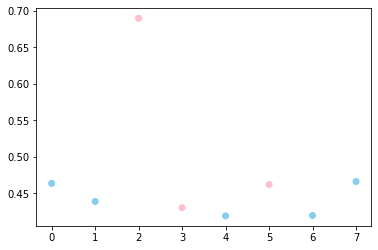

In [ ]:
from matplotlib import pyplot as plt
plt.scatter(range(len(test_x)), score, c=['skyblue' if x ==0 else 'pink' for x in test_y])